# Coursework 2: Generative Models

## Instructions

### Submission
Please submit one zip file on cate - *CW2.zip* containing the following:
1. A version of this notebook containing your answers. Write your answers in the cells below each question. **Please deliver the notebook including the outputs of the cells**
2. Your trained VAE model as *VAE_model.pth*
3. Your trained Generator and Discriminator: *DCGAN_model_D.pth and DCGAN_model_G.pth*


### Training
Training the GAN will take quite a long time (multiple hours), please refer to the 4 GPU options detailed in the logistics lecture. Some additional useful pointers:
* PaperSpace [guide if you need more compute](https://hackmd.io/@afspies/S1stL8Qnt)
* Lab GPUs via SSH.  The VSCode Remote Develop extension is recommended for this. For general Imperial remote working instructions see [this post](https://www.doc.ic.ac.uk/~nuric/teaching/remote-working-for-imperial-computing-students.html). You'll also want to [setup your environment as outlined here](https://hackmd.io/@afspies/Bkd7Zq60K).
* Use Colab and add checkpointing to the model training code; this is to handle the case where colab stops a free-GPU kernel after a certain number of hours (~4).
* Use Colab Pro - If you do not wish to use PaperSpace then you can pay for Colab Pro. We cannot pay for this on your behalf (this is Google's fault).


### Testing
TAs will run a testing cell (at the end of this notebook), so you are required to copy your data ```transform``` and ```denorm``` functions to a cell near the bottom of the document (it is demarkated). You are advised to check that your implementations pass these tests (in particular, the jit saving and loading may not work for certain niche functions)

### General
You can feel free to add architectural alterations / custom functions outside of pre-defined code blocks, but if you manipulate the model's inputs in some way, please include the same code in the TA test cell, so our tests will run easily.

<font color="orange">**The deadline for submission is Monday, 26 Feb by 6 pm** </font>

## Setting up working environment
You will need to install pytorch and import some utilities by running the following cell:

In [1]:
!pip install -q torch torchvision altair==4.2.2 seaborn
!git clone -q https://github.com/afspies/icl_dl_cw2_utils
from icl_dl_cw2_utils.utils.plotting import plot_tsne
from pathlib import Path
import tqdm

!pip install torchsummary

fatal: destination path 'icl_dl_cw2_utils' already exists and is not an empty directory.


Here we have some default pathing options which vary depending on the environment you are using. You can of course change these as you please.

In [2]:
# Initialization Cell
WORKING_ENV = 'PAPERSPACE' # Can be LABS, COLAB, PAPERSPACE, SAGEMAKER
USERNAME = '' # If working on Lab Machines - Your college username
assert WORKING_ENV in ['LABS', 'COLAB', 'PAPERSPACE', 'SAGEMAKER']

if WORKING_ENV == 'COLAB':
    from google.colab import drive
    %load_ext google.colab.data_table
    dl_cw2_repo_path = 'dl_cw2/' # path in your gdrive to the repo
    content_path = f'/content/drive/MyDrive/{dl_cw2_repo_path}' # path to gitrepo in gdrive after mounting
    data_path = './data/' # save the data locally
    drive.mount('/content/drive/') # Outputs will be saved in your google drive

elif WORKING_ENV == 'LABS':
    content_path = f'/vol/bitbucket/{USERNAME}/dl/dl_cw2/' # You may want to change this
    data_path = f'/vol/bitbucket/{USERNAME}/dl/'
    # Your python env and training data should be on bitbucket
    if 'vol/bitbucket' not in content_path or 'vol/bitbucket' not in data_path:
        import warnings
        warnings.warn(
           'It is best to create a dir in /vol/bitbucket/ otherwise you will quickly run into memory issues'
           )
elif WORKING_ENV == 'PAPERSPACE': # Using Paperspace
    # Paperspace does not properly render animated progress bars
    # Strongly recommend using the JupyterLab UI instead of theirs
    !pip install ipywidgets
    content_path = '/notebooks/'
    data_path = './data/'

elif WORKING_ENV == 'SAGEMAKER':
    content_path = '/home/studio-lab-user/sagemaker-studiolab-notebooks/dl/'
    data_path = f'{content_path}data/'

else:
  raise NotImplementedError()

content_path = Path(content_path)

## Introduction

For this coursework, you are asked to implement two commonly used generative models:
1. A **Variational Autoencoder (VAE)**
2. A **Deep Convolutional Generative Adversarial Network (DCGAN)**

For the first part you will the MNIST dataset https://en.wikipedia.org/wiki/MNIST_database and for the second the CIFAR-10 (https://www.cs.toronto.edu/~kriz/cifar.html).

Each part is worth 50 points.

The emphasis of both parts lies in understanding how the models behave and learn, however, some points will be available for getting good results with your GAN (though you should not spend too long on this).

# Part 1 - Variational Autoencoder

## Part 1.1 (25 points)
**Your Task:**

a. Implement the VAE architecture with accompanying hyperparameters. More marks are awarded for using a Convolutional Encoder and Decoder.

b. Design an appropriate loss function and train the model.


In [3]:
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
import torch.nn.functional as F
import matplotlib.pyplot as plt

def show(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)))

if not os.path.exists(content_path/'CW_VAE/'):
    os.makedirs(content_path/'CW_VAE/')

if not os.path.exists(data_path):
    os.makedirs(data_path)

# We set a random seed to ensure that your results are reproducible.
if torch.cuda.is_available():
    torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

GPU = True # Choose whether to use GPU
if GPU:
    device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")
else:
    device = torch.device("cpu")
print(f'Using {device}')

Using cuda


---
## Part 1.1a: Implement VAE (25 Points)
### Hyper-parameter selection


In [4]:
# Necessary Hyperparameters
num_epochs = 20 
learning_rate = 0.0005 
batch_size = 128 
latent_dim = 6 # Choose a value for the size of the latent space 15

# Additional Hyperparameters
beta_kl = 2.5 #Please note to run frange_cycle_linear(0, 1, n_epoch, 3, 0.7) to obtain the beta_kl used in the code

# (Optionally) Modify transformations on input
transform = transforms.Compose([
    transforms.ToTensor(),
])

# (Optionally) Modify the network's output for visualizing your images
def denorm(x):
    return x

### Data loading


In [5]:
train_dat = datasets.MNIST(
    data_path, train=True, download=True, transform=transform
)
test_dat = datasets.MNIST(data_path, train=False, transform=transform)

loader_train = DataLoader(train_dat, batch_size, shuffle=True)
loader_test = DataLoader(test_dat, batch_size, shuffle=False)

# Don't change
sample_inputs, _ = next(iter(loader_test))
fixed_input = sample_inputs[:32, :, :, :]
save_image(fixed_input, content_path/'CW_VAE/image_original.png')

### Model Definition

<figure>
  <img src="https://blog.bayeslabs.co/assets/img/vae-gaussian.png" style="width:60%">
  <figcaption>
    Fig.1 - VAE Diagram (with a Guassian prior), taken from <a href="https://blog.bayeslabs.co/2019/06/04/All-you-need-to-know-about-Vae.html">1</a>.
  </figcaption>
</figure>


You will need to define:
* The hyperparameters
* The constructor
* encode
* reparametrize
* decode
* forward



Hints:
- It is common practice to encode the log of the variance, rather than the variance
- You might try using BatchNorm

In [6]:
# *CODE FOR PART 1.1a IN THIS CELL*

class VAE(nn.Module):
    def __init__(self, latent_dim):
        super(VAE, self).__init__()
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        self.latent_dim = latent_dim

        # Encoder using Convolutional layers
        
        self.encoder = nn.Sequential( # Input: 1x28x28, because gray images
            nn.Conv2d(1, 32, kernel_size=3, stride=1, padding=1),  # Output: 32x28x28
            nn.BatchNorm2d(32),
            nn.ReLU(),
            #nn.LeakyReLU(0.1),
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),  # Output: 64x14x14
            nn.BatchNorm2d(64),
            nn.ReLU(),
            #nn.LeakyReLU(0.2),
            nn.Conv2d(64, 64, kernel_size=3, stride=2, padding=1),  # Output: 128x7x7
            nn.BatchNorm2d(64),
            nn.ReLU(),
            #nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),  # Output: 128x7x7
            nn.BatchNorm2d(128),
            nn.ReLU(),
            #nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),  # Output: 128x7x7
            nn.BatchNorm2d(128),
            nn.ReLU(),
            #nn.LeakyReLU(0.1),

            nn.Flatten(start_dim=1), # Flatten for the linear layers, from dim 1 to dim -1
                          # Output: 128 x 7 x 7
        )

        # Mean and log variance layers
        self.mu_NN = nn.Linear(128 * 14 * 14, self.latent_dim)
        self.logvar_NN = nn.Linear(128 * 14 * 14, self.latent_dim)

        # Define the input for the decoder
        self.decoder_input = nn.Linear(self.latent_dim, 128 * 14 * 14)


        # Decoder: inverse of encoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(128, 128, kernel_size=3, stride=1, padding=1, output_padding=0),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            #nn.LeakyReLU(0.1),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=1, padding=1, output_padding=0),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            #nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(64, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            #nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=1, padding=1, output_padding=0),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            #nn.LeakyReLU(0.1),
            nn.ConvTranspose2d(32, 1, kernel_size=3, stride=1, padding=1, output_padding=0),
            nn.Sigmoid(),  # Ensuring output is in [0,1]
        )
        


        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################


    def encode(self, x):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        h_enc = self.encoder(x)

        out1 = self.mu_NN(h_enc)
        out2 = self.logvar_NN(h_enc)

        return out1, out2

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################


    def reparametrize(self, mu, logvar):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        var = torch.exp(0.5*logvar)

        #Defining epsilon, following a normal distribution: N(eps; 0, I)
        eps = torch.randn_like(var)

        if self.training:
            return mu + var * eps
        
        else:
            return mu

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################


    def decode(self, z):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        z_input_dec = self.decoder_input(z)
        z_input_dec = z_input_dec.view(-1, 128, 14, 14)
        h_dec = self.decoder(z_input_dec)

        return h_dec

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################


    def forward(self, x):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        mu, logvar = self.encode(x)

        z_param = self.reparametrize(mu, logvar)

        output = self.decode(z_param)

        return output, mu, logvar, z_param

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################


model = VAE(latent_dim).to(device)
params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of parameters is: {}".format(params))
print(model)
# optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

Total number of parameters is: 1032333
VAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (14): ReLU()
    (15): Flatten(star

In [8]:
from torchsummary import summary

summary(model, (1, 28, 28))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 28, 28]             320
       BatchNorm2d-2           [-1, 32, 28, 28]              64
              ReLU-3           [-1, 32, 28, 28]               0
            Conv2d-4           [-1, 64, 28, 28]          18,496
       BatchNorm2d-5           [-1, 64, 28, 28]             128
              ReLU-6           [-1, 64, 28, 28]               0
            Conv2d-7           [-1, 64, 14, 14]          36,928
       BatchNorm2d-8           [-1, 64, 14, 14]             128
              ReLU-9           [-1, 64, 14, 14]               0
           Conv2d-10          [-1, 128, 14, 14]          73,856
      BatchNorm2d-11          [-1, 128, 14, 14]             256
             ReLU-12          [-1, 128, 14, 14]               0
           Conv2d-13          [-1, 128, 14, 14]         147,584
      BatchNorm2d-14          [-1, 128,

---

## Part 1.1b: Training the Model (5 Points)

### Defining a Loss
Recall the Beta VAE loss, with an encoder $q$ and decoder $p$:
$$ \mathcal{L}=\mathbb{E}_{q_\phi(z \mid X)}[\log p_\theta(X \mid z)]-\beta D_{K L}[q_\phi(z \mid X) \| p_\theta(z)]$$

In order to implement this loss you will need to think carefully about your model's outputs and the choice of prior.

There are multiple accepted solutions. Explain your design choices based on the assumptions you make regarding the distribution of your data.

* Hint: this refers to the log likelihood as mentioned in the tutorial. Make sure these assumptions reflect on the values of your input data, i.e. depending on your choice you might need to do a simple preprocessing step.

* You are encouraged to experiment with the weighting coefficient $\beta$ and observe how it affects your training

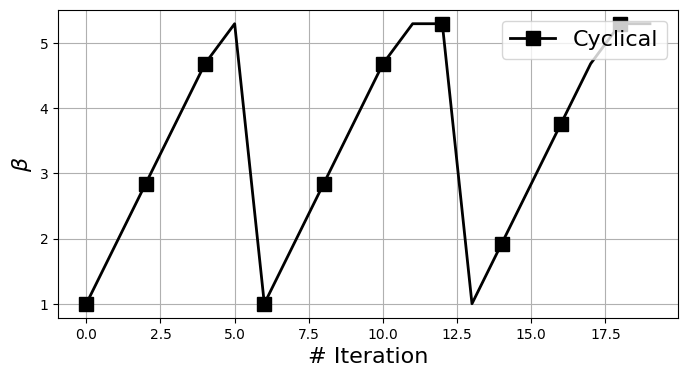

In [8]:
def frange_cycle_linear(start, stop, n_epoch, n_cycle=3, ratio=0.5):
    L = np.ones(n_epoch)
    period = n_epoch/n_cycle
    step = (stop-start)/(period*ratio) # linear schedule

    for c in range(n_cycle):

        v , i = start , 0
        while v <= stop and (int(i+c*period) < n_epoch):
            L[int(i+c*period)] = v
            v += step
            i += 1
    return L*4.3 +1

n_epoch = 20
beta_np_cyc = frange_cycle_linear(0, 1, n_epoch, 3, 0.7)

fig=plt.figure(figsize=(8,4.0))
stride = max( int(n_epoch / 8), 1)

plt.plot(range(n_epoch), beta_np_cyc, '-', label='Cyclical', marker= 's', color='k', markevery=stride,lw=2,  mec='k', mew=1 , markersize=10)

plt.xlabel('# Iteration', fontsize=16)
plt.ylabel("$\\beta$", fontsize=16)

plt.legend(loc='upper right', fontsize=16)
plt.grid()
plt.show()

In [10]:
beta_np_cyc

array([1.        , 1.92142857, 2.84285714, 3.76428571, 4.68571429,
       5.3       , 1.        , 1.92142857, 2.84285714, 3.76428571,
       4.68571429, 5.3       , 5.3       , 1.        , 1.92142857,
       2.84285714, 3.76428571, 4.68571429, 5.3       , 5.3       ])

##### Loss function and training

In [9]:
# *CODE FOR PART 1.1b IN THIS CELL*

def loss_function_VAE(recon_x, x, mu, logvar, beta):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        # Reconstruction loss
        # x is normalized to [0, 1] (thanks to sigmoid function), we use binary cross-entropy.

        rec_loss = F.binary_cross_entropy(recon_x, x, reduction='sum')

        # KL Divergence
        KL_div = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp()) #dim=1

        KL = beta * KL_div  #weighted by beta

        # Beta VAE Loss
        Loss = rec_loss + KL

        return Loss, rec_loss, KL

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################



#Function to test the model and extract the test loss associated
def testing_VAE(model_current, loader_test, beta_current):
    model_current.eval()
    current_test_loss = 0
    current_test_loss_BCE = 0
    current_test_loss_KL = 0
    
    with torch.no_grad():

        with tqdm.tqdm(loader_test, unit="batch") as tepoch: # Progression Bar
            for batch_idx, (data, label) in enumerate(tepoch): # Loop over the batches

                size_test = len(loader_test.dataset)

                if batch_idx == len(tepoch)-1:  #if last batch => adjust the batch size dimension
                    data = data.view(size_test - int(size_test/batch_size) * batch_size,1,28,28)
                else: #if normal batch => put format
                    data = data.view((batch_size),1,28,28)

                data = data.to(device)
                recon_batch, mu, logvar, z_para = model_current.forward(data)
                #recon_batch, mu, logvar = model_current.forward(data)

                loss, rec_loss, kl_val = loss_function_VAE(recon_batch, data, mu, logvar, beta_current)

                current_test_loss += loss.item()

                current_test_loss_BCE += rec_loss

                current_test_loss_KL += kl_val

    model_current.train()

    return current_test_loss, current_test_loss_BCE, current_test_loss_KL



# Training the model

beta_kl = beta_np_cyc

model.train()

save_loss_VAE = [] # <- You may wish to add logging info here
save_loss_BCE = []
save_loss_KL = []
save_loss_test = []
save_loss_test_BCE = []
save_loss_test_KL = []

eval_main = True

for epoch in range(num_epochs):
    current_train_loss = 0 # <- You may wish to add logging info here
    current_loss_BCE = 0
    current_loss_KL = 0
    current_beta = 0
    with tqdm.tqdm(loader_train, unit="batch") as tepoch:
        for batch_idx, (data, _) in enumerate(tepoch):
            #######################################################################
            #                       ** START OF YOUR CODE **
            #######################################################################
            # Need at least one batch/random data with right shape -
            # This is required to initialize to model properly below
            # when we save the computational graph for testing (jit.save)

            #Ensuring the right format of the data (batch_size, 1, 28, 28)
            #1 for gray channel; 28x28 because of image shape
            size_train = len(loader_train.dataset)

            if batch_idx == len(tepoch)-1:  #if last batch => adjust the batch size dimension
              data = data.view(size_train - int(size_train/batch_size) * batch_size,1,28,28)
            else: #if normal batch => put format
              data = data.view((batch_size),1,28,28)

            data = data.to(device)

            optimizer.zero_grad()

            recon_batch, mu, logvar, z_para = model.forward(data)

            #Test if beta is a list and/or an array or a single value
            if isinstance(beta_kl, (list, np.ndarray)):
                current_beta = beta_kl[epoch]
            else:
                current_beta = beta_kl

            loss, rec_loss, kl_val = loss_function_VAE(recon_batch, data, mu, logvar, current_beta)

            loss.backward()

            current_train_loss += loss.item()
            current_loss_BCE += rec_loss
            current_loss_KL += kl_val

            optimizer.step()

            #######################################################################
            #                       ** END OF YOUR CODE **
            #######################################################################
            if batch_idx % 20 == 0:
                tepoch.set_description(f"Epoch {epoch}")
                tepoch.set_postfix(loss=loss.item()/len(data))

    save_loss_VAE.append(current_train_loss / len(loader_train.dataset))
    save_loss_BCE.append(current_loss_BCE.cpu().detach().numpy() / len(loader_train.dataset))
    save_loss_KL.append(current_loss_KL.cpu().detach().numpy() / len(loader_train.dataset))

    # Testing the model
    if eval_main:
        current_test_loss, current_test_loss_BCE, current_test_loss_KL = testing_VAE(model, loader_test, current_beta)
        save_loss_test.append(current_test_loss / len(loader_test.dataset))
        save_loss_test_BCE.append(current_test_loss_BCE.cpu().detach().numpy() / len(loader_test.dataset))
        save_loss_test_KL.append(current_test_loss_KL.cpu().detach().numpy() / len(loader_test.dataset))


    # save the model
    if epoch == num_epochs - 1:
        with torch.no_grad():
            #torch.jit.save(torch.jit.trace(model, (data), check_trace=False),
            #    content_path/'CW_VAE/VAE_model.pth')
            torch.jit.save(torch.jit.script(model), content_path/'CW_VAE/VAE_model.pth')



100%|██████████| 79/79 [00:01<00:00, 72.88batch/s]


In [26]:
def training_VAE(model_current, optimizer_current, loader_train, loader_test, num_epochs_current, beta, eval=True):
    model_current.train()
    loss_train = []
    loss_BCE_train = []
    loss_KL_train = []
    loss_test = []
    loss_BCE_test = []
    loss_KL_test = []

    for epoch in range(num_epochs_current):
        current_train_loss = 0 # <- You may wish to add logging info here
        current_loss_BCE = 0
        current_loss_KL = 0
        current_beta = 0
        #model_current.train()
        with tqdm.tqdm(loader_train, unit="batch") as tepoch:
            for batch_idx, (data, _) in enumerate(tepoch):
                #######################################################################
                #                       ** START OF YOUR CODE **
                #######################################################################
                # Need at least one batch/random data with right shape -
                # This is required to initialize to model properly below
                # when we save the computational graph for testing (jit.save)

                #Ensuring the right format of the data (batch_size, 1, 28, 28)
                #1 for gray channel; 28x28 because of image shape
                size_train = len(loader_train.dataset)

                if batch_idx == len(tepoch)-1:  #if last batch => adjust the batch size dimension
                    data = data.view(size_train - int(size_train/batch_size) * batch_size,1,28,28)
                else: #if normal batch => put format
                    data = data.view((batch_size),1,28,28)

                data = data.to(device)

                optimizer_current.zero_grad()

                recon_batch, mu, logvar, z_para = model_current.forward(data)
                #recon_batch, mu, logvar = model_current.forward(data)

                #Test if beta is a list and/or an array or a single value
                if isinstance(beta, (list, np.ndarray)):
                    current_beta = beta[epoch]
                else:
                    current_beta = beta

                loss, rec_loss, kl_val = loss_function_VAE(recon_batch, data, mu, logvar, current_beta)

                loss.backward()

                current_train_loss += loss.item()
                current_loss_BCE += rec_loss
                current_loss_KL += kl_val

                optimizer_current.step()

                #######################################################################
                #                       ** END OF YOUR CODE **
                #######################################################################
                if batch_idx % 20 == 0:
                    tepoch.set_description(f"Epoch {epoch}")
                    tepoch.set_postfix(loss=loss.item()/len(data))

        loss_train.append(current_train_loss / len(loader_train.dataset))
        loss_BCE_train.append(current_loss_BCE.cpu().detach().numpy() / len(loader_train.dataset))
        loss_KL_train.append(current_loss_KL.cpu().detach().numpy() / len(loader_train.dataset))

        # Testing the model
        if eval:
            current_test_loss, current_test_loss_BCE, current_test_loss_KL = testing_VAE(model_current, loader_test, current_beta)
            loss_test.append(current_test_loss / len(loader_test.dataset))
            loss_BCE_test.append(current_test_loss_BCE.cpu().detach().numpy() / len(loader_test.dataset))
            loss_KL_test.append(current_test_loss_KL.cpu().detach().numpy() / len(loader_test.dataset))

        # save the model
        if epoch == num_epochs - 1:
            with torch.no_grad():
                #torch.jit.save(torch.jit.script(model_current, (data), check_trace=False),
                #    content_path/'CW_VAE/VAE_model.pth')
                torch.jit.save(torch.jit.script(model_current), content_path/'CW_VAE/VAE_model.pth')
                
    return model_current, loss_train, loss_BCE_train, loss_KL_train, loss_test, loss_BCE_test, loss_KL_test


In [27]:
# Training for main model
model, save_loss_VAE, save_loss_BCE, save_loss_KL, save_loss_test, save_loss_test_BCE, save_loss_test_KL = training_VAE(model, optimizer, loader_train, loader_test, num_epochs, beta_np_cyc)

100%|██████████| 79/79 [00:01<00:00, 44.13batch/s]


In [14]:
def train_multiple_VAE_beta(loader_train, loader_test, num_epochs, beta_values, latent_dim_current, lr_current, device):
    models = []
    training_metrics = []
    testing_metrics = []

    for beta in beta_values:
        print(f"Training model with beta={beta}")
        model_current = VAE(latent_dim_current).to(device)
        params_current = sum(p.numel() for p in model_current.parameters() if p.requires_grad)
        print("Total number of parameters is: {}".format(params_current))
        print(model_current)
        optimizer_current = torch.optim.Adam(model_current.parameters(), lr=lr_current)
        
        trained_model, loss_train, loss_BCE_train, loss_KL_train, loss_test, loss_BCE_test, loss_KL_test = training_VAE(model_current, optimizer_current, loader_train, loader_test, num_epochs, beta, eval=True)
        
        models.append(trained_model)
        training_metrics.append((loss_train, loss_BCE_train, loss_KL_train))
        testing_metrics.append((loss_test, loss_BCE_test, loss_KL_test))
        
        print(f"Completed training for beta={beta}")

    return models, training_metrics, testing_metrics

In [15]:
def train_multiple_VAE_latentspace(loader_train, loader_test, num_epochs, beta_val, latent_dim_current, lr_current, device):
    models = []
    training_metrics = []
    testing_metrics = []

    for lat in latent_dim_current:
        print(f"Training model with latent_space={lat}")
        model_current = VAE(lat).to(device)
        params_current = sum(p.numel() for p in model_current.parameters() if p.requires_grad)
        print("Total number of parameters is: {}".format(params_current))
        print(model_current)
        optimizer_current = torch.optim.Adam(model_current.parameters(), lr=lr_current)
        
        trained_model, loss_train, loss_BCE_train, loss_KL_train, loss_test, loss_BCE_test, loss_KL_test = training_VAE(model_current, optimizer_current, loader_train, loader_test, num_epochs, beta_val, eval=True)
        
        models.append(trained_model)
        training_metrics.append((loss_train, loss_BCE_train, loss_KL_train))
        testing_metrics.append((loss_test, loss_BCE_test, loss_KL_test))
        
        print(f"Completed training for latent_space={lat}")

    return models, training_metrics, testing_metrics

##### Training for different beta values

In [34]:
beta_to_test = [0.5, 4, 20, 50]

In [35]:
models_beta, training_metrics_beta, testing_metrics_beta = train_multiple_VAE_beta(loader_train, loader_test, num_epochs, beta_to_test, latent_dim, learning_rate, device)

Training model with beta=0.5
Total number of parameters is: 1032333
VAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (14): 

  0%|          | 0/469 [00:00<?, ?batch/s]

100%|██████████| 79/79 [00:01<00:00, 46.40batch/s]


Completed training for beta=0.5
Training model with beta=4
Total number of parameters is: 1032333
VAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_

100%|██████████| 79/79 [00:01<00:00, 45.19batch/s]


Completed training for beta=4
Training model with beta=20
Total number of parameters is: 1032333
VAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_r

100%|██████████| 79/79 [00:01<00:00, 46.02batch/s]


Completed training for beta=20
Training model with beta=50
Total number of parameters is: 1032333
VAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_

100%|██████████| 79/79 [00:01<00:00, 46.08batch/s]


Completed training for beta=50


##### Training for different cyclic beta

In [42]:
betacyclic_to_test = [frange_cycle_linear(0, 1, n_epoch, 1, 0.9), frange_cycle_linear(0.5, 1, n_epoch, 2, 0.5), frange_cycle_linear(0, 1, n_epoch, 4, 0.5), frange_cycle_linear(0, 4, n_epoch, 3, 0.8)]

In [43]:
models_betacyclic, training_metrics_betacyclic, testing_metrics_betacyclic = train_multiple_VAE_beta(loader_train, loader_test, num_epochs, betacyclic_to_test, latent_dim, learning_rate, device)

Training model with beta=[1.         1.23888889 1.47777778 1.71666667 1.95555556 2.19444444
 2.43333333 2.67222222 2.91111111 3.15       3.38888889 3.62777778
 3.86666667 4.10555556 4.34444444 4.58333333 4.82222222 5.06111111
 5.3        5.3       ]
Total number of parameters is: 1032333
VAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, t

Epoch 0:   3%|▎         | 12/469 [00:00<00:23, 19.82batch/s, loss=1.71e+3]

100%|██████████| 79/79 [00:01<00:00, 46.55batch/s]


Completed training for beta=[1.         1.23888889 1.47777778 1.71666667 1.95555556 2.19444444
 2.43333333 2.67222222 2.91111111 3.15       3.38888889 3.62777778
 3.86666667 4.10555556 4.34444444 4.58333333 4.82222222 5.06111111
 5.3        5.3       ]
Training model with beta=[3.15 3.58 4.01 4.44 4.87 5.3  5.3  5.3  5.3  5.3  3.15 3.58 4.01 4.44
 4.87 5.3  5.3  5.3  5.3  5.3 ]
Total number of parameters is: 1032333
VAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Co

100%|██████████| 79/79 [00:01<00:00, 45.29batch/s]


Completed training for beta=[3.15 3.58 4.01 4.44 4.87 5.3  5.3  5.3  5.3  5.3  3.15 3.58 4.01 4.44
 4.87 5.3  5.3  5.3  5.3  5.3 ]
Training model with beta=[1.   2.72 4.44 5.3  5.3  1.   2.72 4.44 5.3  5.3  1.   2.72 4.44 5.3
 5.3  1.   2.72 4.44 5.3  5.3 ]
Total number of parameters is: 1032333
VAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine

100%|██████████| 79/79 [00:01<00:00, 45.28batch/s]


Completed training for beta=[1.   2.72 4.44 5.3  5.3  1.   2.72 4.44 5.3  5.3  1.   2.72 4.44 5.3
 5.3  1.   2.72 4.44 5.3  5.3 ]
Training model with beta=[ 1.     4.225  7.45  10.675 13.9   17.125  1.     4.225  7.45  10.675
 13.9   17.125  5.3    1.     4.225  7.45  10.675 13.9   17.125  5.3  ]
Total number of parameters is: 1032333
VAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNor

100%|██████████| 79/79 [00:01<00:00, 46.63batch/s]


Completed training for beta=[ 1.     4.225  7.45  10.675 13.9   17.125  1.     4.225  7.45  10.675
 13.9   17.125  5.3    1.     4.225  7.45  10.675 13.9   17.125  5.3  ]


##### Training for different latent space

In [67]:
latent_to_test = [2, 12, 20, 30]

In [68]:
models_latent, training_metrics_latent, testing_metrics_latent = train_multiple_VAE_latentspace(loader_train, loader_test, num_epochs, beta_np_cyc, latent_to_test, learning_rate, device)

Training model with latent_space=2
Total number of parameters is: 731269
VAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

100%|██████████| 79/79 [00:01<00:00, 45.69batch/s]


Completed training for latent_space=2
Training model with latent_space=12
Total number of parameters is: 1483929
VAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(128, eps=1e-05, momentum=0.1, affi

100%|██████████| 79/79 [00:01<00:00, 46.62batch/s]


Completed training for latent_space=12
Training model with latent_space=20
Total number of parameters is: 2086057
VAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(128, eps=1e-05, momentum=0.1, aff

100%|██████████| 79/79 [00:01<00:00, 45.34batch/s]


Completed training for latent_space=20
Training model with latent_space=30
Total number of parameters is: 2838717
VAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(128, eps=1e-05, momentum=0.1, aff

100%|██████████| 79/79 [00:01<00:00, 45.33batch/s]


Completed training for latent_space=30


### Loss Explanation
Explain your choice of loss and how this relates to:

* The VAE Prior
* The output data domain
* Disentanglement in the latent space


Histogram display


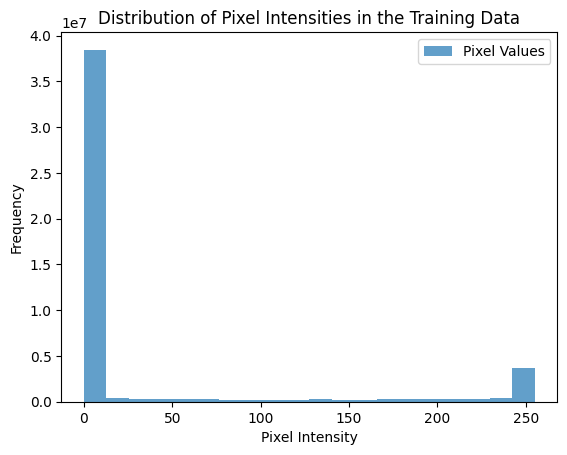

Top 5 Pixel Intensities by Percentage:
Intensity: 0.000, Percentage: 80.88%
Intensity: 253.000, Percentage: 3.22%
Intensity: 254.000, Percentage: 1.70%
Intensity: 252.000, Percentage: 1.39%
Intensity: 255.000, Percentage: 0.67%
Images display


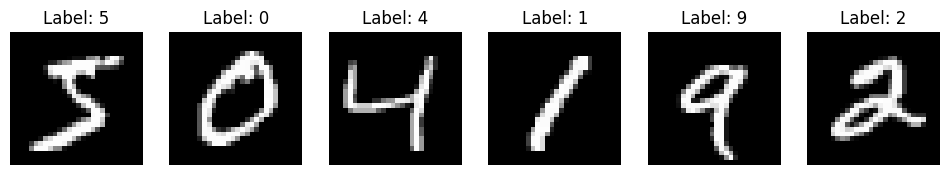

In [6]:
# Any code for your explanation here (you may not need to use this cell)

# Study of the distribution only on training set
all_train_set = DataLoader(train_dat, len(loader_train.dataset))


def plot_histogram(dataset_to_analyse):
    data = next(iter(dataset_to_analyse))[0]
    plt.hist(data.numpy().flatten()*255, bins=20, alpha=0.7, label='Pixel Values')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.title('Distribution of Pixel Intensities in the Training Data')
    plt.legend()
    plt.show()

print('Histogram display')
plot_histogram(all_train_set)


def count_pixel_intensity(dataset_to_analyse):
    data, _ = next(iter(dataset_to_analyse))
    pixels = (data.numpy().flatten() * 255).astype(int)
    total_pixels = pixels.size
    values, counts = np.unique(pixels, return_counts=True)
    percentages = (counts / total_pixels) * 100  # Convert counts to percentages
    intensity_percentages = dict(zip(values, percentages))
    intensities_5 = sorted(intensity_percentages.items(), key=lambda x: x[1], reverse=True)[:5]
    return intensities_5

train_intensity_counts = count_pixel_intensity(all_train_set)

print("Top 5 Pixel Intensities by Percentage:")
for intensity, percentage in train_intensity_counts:
    print(f"Intensity: {intensity:.3f}, Percentage: {percentage:.2f}%")



def display_samples(dataset, num_samples=6):
    figure, ax = plt.subplots(1, num_samples, figsize=(12, 12))
    for i in range(num_samples):
        img, label = dataset[i]
        ax[i].imshow(img.squeeze(), cmap='gray')
        ax[i].title.set_text(f'Label: {label}')
        ax[i].axis('off')
    plt.show()

print('Images display')
display_samples(train_dat)

**YOUR ANSWER**

First of all, we chose to use Binary Cross Entropy from the PyTorch module and KL-divergence loss, weighted by a coefficient, beta_kl. In our case, beta_kl equals beta_np_cyc, which is a cyclical beta.

Binary Cross Entropy corresponds to the reconstruction error between the output and input, representing the "autoencoder" aspect of our model. The negative Kullback-Leibler (KL) divergence quantifies the loss between the variational posterior and the prior of the latent variable.

Our analysis of the MNIST dataset, particularly through histograms showing pixel intensity distribution, reveals it consists exclusively of grayscale images (one channel). Specifically, most pixels are either black (intensity 0) or white (intensity approximately 255), with only a minor proportion representing shades of gray.

From the VAE architecture, we can see that the decoder's output is computed using a sigmoid activation function. This results in output values of 0 or 1 for each pixel in an MNIST image, corresponding to black or white pixels, respectively, after sigmoid rescaling. Consequently, for an entire image, two distinct peaks appear at values 0 and 1. The previous statement is an approximation of the actual behaviour.

For this answer please, plot are available in: "Loss_explanation_histogram", or https://drive.google.com/file/d/12ftAnNhRNarWzw2vL3riGsX-IFiQ6mVe/view?usp=sharing.


<br>

**The VAE prior:**

The prior $p(z)$ in a VAE represents our assumptions about the distribution of latent variables before observing any data. This prior shapes the latent space and influences how data points are mapped to it. 

We define the prior as a multivariate standard normal distribution $\mathcal{N}(0, I)$, centering the latent space. Also, it promotes an equal utilization of the latent space's dimensions thanks to the symmetry and uniform variance across all directions.

Here the assumption (which is a distribution assumption) is that we have a latent space that is continuously mapped to the binary-like pixel intensities observed in your dataset. In our case this assumption is reasonable as we do not have for instance categorical data.

*Combination with BCE Loss*: Using Binary Cross Entropy as the reconstruction loss aligns with the pixel distribution, indicating an expectation to encode binary-like data into a latent space modeled by a normal distribution.

<br>

**The output data domain:**

Our analysis shows that MNIST dataset images primarily consist of black and white pixels. We consider each pixel's intensity as a binary outcome (black or white), but it is an approximation of the real use case that we have.

Therefore, we can model our approximation by a Bernoulli distribution (each pixel's intensity is a Bernoulli random variable), due to the almost binary outcome. This makes BCE an appropriate measure for evaluating the difference between predicted and actual binary values.

The sigmoid function in the decoder's last layer ensures the model's outputs are suitable for BCE loss calculation, optimizing the model for binary-like reconstructions.

<br>

**Disentanglement in the Latent Space:**

Here we tried to analyse how the dimensions handle more or less independently different aspects of the data variation in the latent space.

The complete loss formula reveals that BCE aims for accurate reconstruction, while the KL divergence term, weighted by $\beta$, encourages a great generation. Adjusting $\beta$ allows us to balance these objectives, affecting the latent space's disentanglement.

Increasing $\beta$ emphasizes KL divergence, enhancing generation capability at the expense of reconstruction accuracy. Indeed it encourages the latent space to adhere to the prior distribution, which is Gaussian. However the model looses in this case part of its ability of reproducing the input (generalisation). A large $\beta$, can lead to a decoder that is almost independent of the input, and the latent space does not incorporate knowledge from the input as well. 
Consequently the model does not have the capacity to reproduce the input but also is not able to generate samples as the decoder becomes independent.
It should be noted that, as we used a loss with the parameter reduction equals to 'sum', we are referring to a $\beta$ greater than 1.

On the other hand, if we prioritize the BCE loss over the KL loss, then the reconstruction becomes the main objective at the expense of losing relevant information about the variational prior. In this case, the model decreases its generation ability.

Therefore, an inportant step in our VAE construction was to design a well-tuned $\beta$ in order to learn a latent space where dimensions are responsible for different data aspects and managing disentanglement effectively.

<br>

**Bonus:** Literature and notebook examples suggest that MSE could be used for loss. However, our experiments showed that BCE loss was significantly more effective for our model, based on loss curves interpretation and the quality of digit reconstructions and generations.

<h2>Part 1.2 (9 points)</h2>

a. Plot your loss curves

b. Show reconstructions and samples

c. Discuss your results from parts (a) and (b)

## Part 1.2a: Loss Curves (3 Points)
Plot your loss curves (6 in total, 3 for the training set and 3 for the test set): total loss, reconstruction log likelihood loss, KL loss (x-axis: epochs, y-axis: loss). If you experimented with different values of $\beta$, you may wish to display multiple plots (worth 1 point).

##### Plot Loss Main model



In [16]:
def plot_loss_main(loss_train, loss_BCE_train, loss_KL_train, loss_test, loss_BCE_test, loss_KL_test):
    #Plot the 6 losses on the same plot
    fig, ax = plt.subplots(figsize=(10, 6))

    ax.plot(loss_train, label='Train Loss', linestyle='-', marker='o')
    ax.plot(loss_BCE_train, label='Train BCE Loss', linestyle='-', marker='s')
    ax.plot(loss_KL_train, label='Train KL Loss', linestyle='-', marker='^')
    ax.plot(loss_test, label='Test Loss', linestyle='--', marker='o')
    ax.plot(loss_BCE_test, label='Test BCE Loss', linestyle='--', marker='s')
    ax.plot(loss_KL_test, label='Test KL Loss', linestyle='--', marker='^')

    #Add parameters as latent space, beta, number of epochs, learning rate with a box in the plot
    textstr = f'Latent Space: {latent_dim}\nCyclic Beta\nEpochs: {num_epochs}\nLearning Rate: {learning_rate}'
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
    ax.text(1.05, 0.95, textstr, transform=ax.transAxes, fontsize=14,
            verticalalignment='top', bbox=props)
    

    ax.set_xlabel('Epochs', fontsize=16)
    ax.set_ylabel('Loss', fontsize=16)
    ax.set_title('Losses for Main model', fontsize=16)
    ax.legend(loc='upper right')
    ax.grid()

    plt.show()

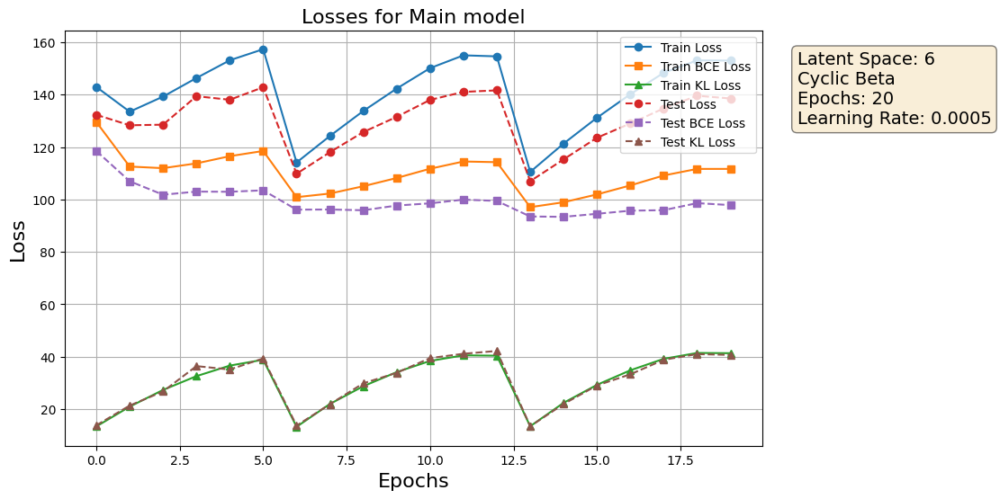

In [28]:
plot_loss_main(save_loss_VAE, save_loss_BCE, save_loss_KL, save_loss_test, save_loss_test_BCE, save_loss_test_KL)

##### Plot Loss comparison for different beta

In [36]:
def plot_loss_beta(training_metrics, testing_metrics, beta_values):
    fig, axs = plt.subplots(2,2, figsize=(16, 8))
    fig.suptitle('Losses Across Epochs for Different Beta Values')

    loss_labels = ['Total Loss', 'BCE Loss', 'KL Loss']

    axs[0,0].plot(training_metrics[0][0], label=f'Training {loss_labels[0]}', linestyle='-')
    axs[0,0].plot(training_metrics[0][1], label=f'Training {loss_labels[1]}', linestyle='-')
    axs[0,0].plot(training_metrics[0][2], label=f'Training {loss_labels[2]}', linestyle='-')
    axs[0,0].plot(testing_metrics[0][0], label=f'Test {loss_labels[0]}', linestyle='--')
    axs[0,0].plot(testing_metrics[0][1], label=f'Test {loss_labels[1]}', linestyle='--')
    axs[0,0].plot(testing_metrics[0][2], label=f'Test {loss_labels[2]}', linestyle='--')
    axs[0,0].set_title(f'Beta = {beta_values[0]}')
    axs[0,0].set_xlabel('Epoch')
    axs[0,0].legend()
    axs[0,0].set_ylabel('Loss')

    
    axs[0,1].plot(training_metrics[1][0], label=f'Training {loss_labels[0]}', linestyle='-')
    axs[0,1].plot(training_metrics[1][1], label=f'Training {loss_labels[1]}', linestyle='-')
    axs[0,1].plot(training_metrics[1][2], label=f'Training {loss_labels[2]}', linestyle='-')
    axs[0,1].plot(testing_metrics[1][0], label=f'Test {loss_labels[0]}', linestyle='--')
    axs[0,1].plot(testing_metrics[1][1], label=f'Test {loss_labels[1]}', linestyle='--')
    axs[0,1].plot(testing_metrics[1][2], label=f'Test {loss_labels[2]}', linestyle='--')
    axs[0,1].set_title(f'Beta = {beta_values[1]}')
    axs[0,1].set_xlabel('Epoch')
    axs[0,1].legend()
    axs[0,1].set_ylabel('Loss')

    axs[1,0].plot(training_metrics[2][0], label=f'Training {loss_labels[0]}', linestyle='-')
    axs[1,0].plot(training_metrics[2][1], label=f'Training {loss_labels[1]}', linestyle='-')
    axs[1,0].plot(training_metrics[2][2], label=f'Training {loss_labels[2]}', linestyle='-')
    axs[1,0].plot(testing_metrics[2][0], label=f'Test {loss_labels[0]}', linestyle='--')
    axs[1,0].plot(testing_metrics[2][1], label=f'Test {loss_labels[1]}', linestyle='--')
    axs[1,0].plot(testing_metrics[2][2], label=f'Test {loss_labels[2]}', linestyle='--')
    axs[1,0].set_title(f'Beta = {beta_values[2]}')
    axs[1,0].set_xlabel('Epoch')
    axs[1,0].legend()
    axs[1,0].set_ylabel('Loss')

    axs[1,1].plot(training_metrics[3][0], label=f'Training {loss_labels[0]}', linestyle='-')
    axs[1,1].plot(training_metrics[3][1], label=f'Training {loss_labels[1]}', linestyle='-')
    axs[1,1].plot(training_metrics[3][2], label=f'Training {loss_labels[2]}', linestyle='-')
    axs[1,1].plot(testing_metrics[3][0], label=f'Test {loss_labels[0]}', linestyle='--')
    axs[1,1].plot(testing_metrics[3][1], label=f'Test {loss_labels[1]}', linestyle='--')
    axs[1,1].plot(testing_metrics[3][2], label=f'Test {loss_labels[2]}', linestyle='--')
    axs[1,1].set_title(f'Beta = {beta_values[3]}')
    axs[1,1].set_xlabel('Epoch')
    axs[1,1].legend()
    axs[1,1].set_ylabel('Loss')

    plt.tight_layout()
    plt.show()

    #plt.savefig(content_path/'CW_VAE/losses_beta.png')

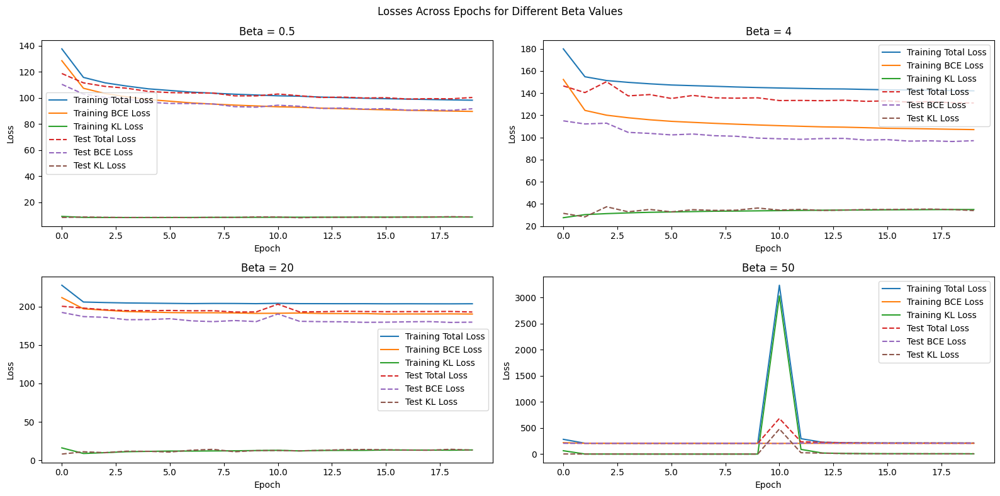

In [37]:
plot_loss_beta(training_metrics_beta, testing_metrics_beta, beta_to_test)

##### Plot Loss comparison for different cyclic beta

In [55]:
def plot_loss_cyclicbeta(training_metrics, testing_metrics, betacyclic_values):
    fig, axs = plt.subplots(4,2, figsize=(16, 14))
    fig.suptitle('Losses Across Epochs for Different Beta Values')

    loss_labels = ['Total Loss', 'BCE Loss', 'KL Loss']

    axs[0,0].plot(training_metrics[0][0], label=f'Training {loss_labels[0]}', linestyle='-')
    axs[0,0].plot(training_metrics[0][1], label=f'Training {loss_labels[1]}', linestyle='-')
    axs[0,0].plot(training_metrics[0][2], label=f'Training {loss_labels[2]}', linestyle='-')
    axs[0,0].plot(testing_metrics[0][0], label=f'Test {loss_labels[0]}', linestyle='--')
    axs[0,0].plot(testing_metrics[0][1], label=f'Test {loss_labels[1]}', linestyle='--')
    axs[0,0].plot(testing_metrics[0][2], label=f'Test {loss_labels[2]}', linestyle='--')
    axs[0,0].set_title(f'Beta = Cyclic Beta 1')
    axs[0,0].set_xlabel('Epoch')
    axs[0,0].legend(fontsize=8, loc='lower right')
    axs[0,0].set_ylabel('Loss')

    axs[0,1].plot(betacyclic_values[0], linestyle='-', label='Cyclical', marker= 's', color='k', markevery=stride, lw=2,  mec='k', mew=1 , markersize=5)
    axs[0,1].set_title('Beta = Cyclic Beta 1')
    axs[0,1].set_xlabel('Epoch')
    axs[0,1].set_ylabel('Beta')
    axs[0,1].legend()

    
    axs[1,0].plot(training_metrics[1][0], label=f'Training {loss_labels[0]}', linestyle='-')
    axs[1,0].plot(training_metrics[1][1], label=f'Training {loss_labels[1]}', linestyle='-')
    axs[1,0].plot(training_metrics[1][2], label=f'Training {loss_labels[2]}', linestyle='-')
    axs[1,0].plot(testing_metrics[1][0], label=f'Test {loss_labels[0]}', linestyle='--')
    axs[1,0].plot(testing_metrics[1][1], label=f'Test {loss_labels[1]}', linestyle='--')
    axs[1,0].plot(testing_metrics[1][2], label=f'Test {loss_labels[2]}', linestyle='--')
    axs[1,0].set_title(f'Beta = Cyclic Beta 2')
    axs[1,0].set_xlabel('Epoch')
    axs[1,0].legend(fontsize=8, loc='lower right')
    axs[1,0].set_ylabel('Loss')

    axs[1,1].plot(betacyclic_values[1], linestyle='-', label='Cyclical', marker= 's', color='k', markevery=stride, lw=2,  mec='k', mew=1 , markersize=5)
    axs[1,1].set_title('Beta = Cyclic Beta 2')
    axs[1,1].set_xlabel('Epoch')
    axs[1,1].set_ylabel('Beta')
    axs[1,1].legend()


    axs[2,0].plot(training_metrics[2][0], label=f'Training {loss_labels[0]}', linestyle='-')
    axs[2,0].plot(training_metrics[2][1], label=f'Training {loss_labels[1]}', linestyle='-')
    axs[2,0].plot(training_metrics[2][2], label=f'Training {loss_labels[2]}', linestyle='-')
    axs[2,0].plot(testing_metrics[2][0], label=f'Test {loss_labels[0]}', linestyle='--')
    axs[2,0].plot(testing_metrics[2][1], label=f'Test {loss_labels[1]}', linestyle='--')
    axs[2,0].plot(testing_metrics[2][2], label=f'Test {loss_labels[2]}', linestyle='--')
    axs[2,0].set_title(f'Beta = Cyclic Beta 3')
    axs[2,0].set_xlabel('Epoch')
    axs[2,0].legend(fontsize=8, loc='lower right')
    axs[2,0].set_ylabel('Loss')

    axs[2,1].plot(betacyclic_values[2], linestyle='-', label='Cyclical', marker= 's', color='k', markevery=stride, lw=2,  mec='k', mew=1 , markersize=5)
    axs[2,1].set_title('Beta = Cyclic Beta 3')
    axs[2,1].set_xlabel('Epoch')
    axs[2,1].set_ylabel('Beta')
    axs[2,1].legend()


    axs[3,0].plot(training_metrics[3][0], label=f'Training {loss_labels[0]}', linestyle='-')
    axs[3,0].plot(training_metrics[3][1], label=f'Training {loss_labels[1]}', linestyle='-')
    axs[3,0].plot(training_metrics[3][2], label=f'Training {loss_labels[2]}', linestyle='-')
    axs[3,0].plot(testing_metrics[3][0], label=f'Test {loss_labels[0]}', linestyle='--')
    axs[3,0].plot(testing_metrics[3][1], label=f'Test {loss_labels[1]}', linestyle='--')
    axs[3,0].plot(testing_metrics[3][2], label=f'Test {loss_labels[2]}', linestyle='--')
    axs[3,0].set_title(f'Beta = Cyclic Beta 4')
    axs[3,0].set_xlabel('Epoch')
    axs[3,0].legend(fontsize=8, loc='lower right')
    axs[3,0].set_ylabel('Loss')

    axs[3,1].plot(betacyclic_values[3], linestyle='-', label='Cyclical', marker= 's', color='k', markevery=stride, lw=2,  mec='k', mew=1 , markersize=5)
    axs[3,1].set_title('Beta = Cyclic Beta 4')
    axs[3,1].set_xlabel('Epoch')
    axs[3,1].set_ylabel('Beta')
    axs[3,1].legend()


    plt.tight_layout()
    plt.show()

    #plt.savefig(content_path/'CW_VAE/losses_betacyclic.png')

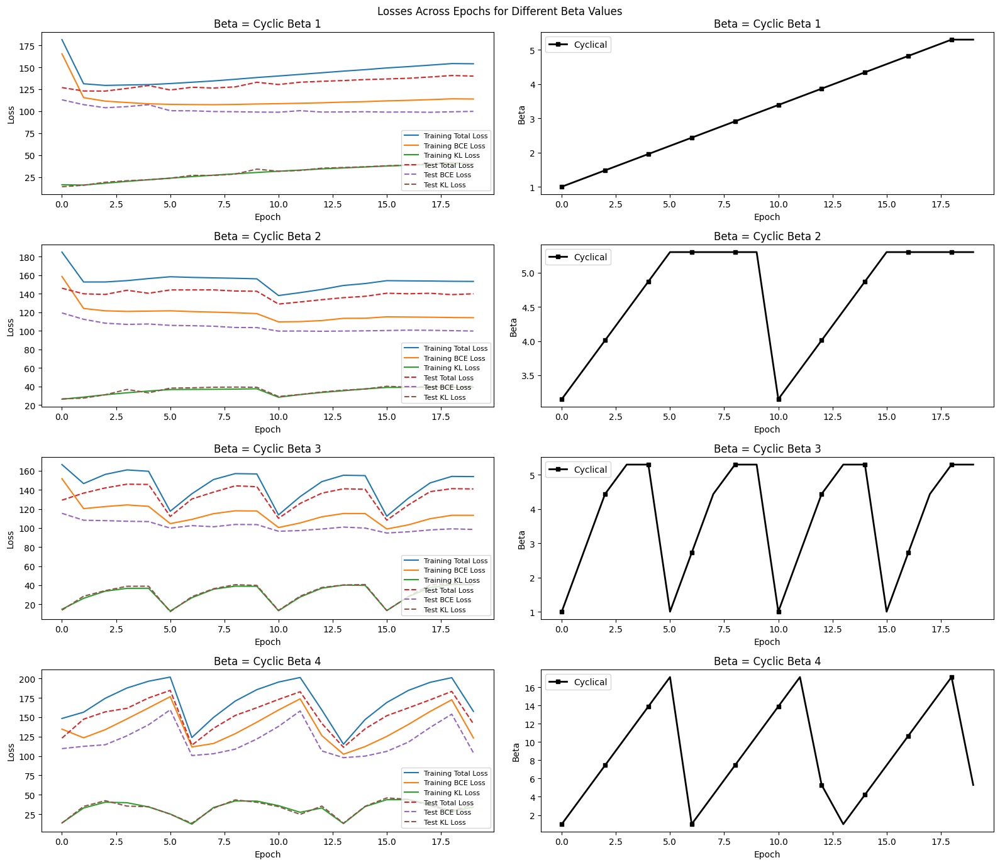

In [56]:
plot_loss_cyclicbeta(training_metrics_betacyclic, testing_metrics_betacyclic, betacyclic_to_test)

##### Plot Loss comparison for different Latent Space

In [71]:
def plot_loss_latentspace(training_metrics, testing_metrics, lat_values):
    fig, axs = plt.subplots(2,2, figsize=(16, 8))
    fig.suptitle('Losses Across Epochs for Different Latent space')

    loss_labels = ['Total Loss', 'BCE Loss', 'KL Loss']

    axs[0,0].plot(training_metrics[0][0], label=f'Training {loss_labels[0]}', linestyle='-')
    axs[0,0].plot(training_metrics[0][1], label=f'Training {loss_labels[1]}', linestyle='-')
    axs[0,0].plot(training_metrics[0][2], label=f'Training {loss_labels[2]}', linestyle='-')
    axs[0,0].plot(testing_metrics[0][0], label=f'Test {loss_labels[0]}', linestyle='-')
    axs[0,0].plot(testing_metrics[0][1], label=f'Test {loss_labels[1]}', linestyle='-')
    axs[0,0].plot(testing_metrics[0][2], label=f'Test {loss_labels[2]}', linestyle='-')
    axs[0,0].set_title(f'Latent space = {lat_values[0]}')
    axs[0,0].set_xlabel('Epoch')
    axs[0,0].legend(fontsize=8, loc='lower right')
    axs[0,0].set_ylabel('Loss')

    
    axs[0,1].plot(training_metrics[1][0], label=f'Training {loss_labels[0]}', linestyle='-')
    axs[0,1].plot(training_metrics[1][1], label=f'Training {loss_labels[1]}', linestyle='-')
    axs[0,1].plot(training_metrics[1][2], label=f'Training {loss_labels[2]}', linestyle='-')
    axs[0,1].plot(testing_metrics[1][0], label=f'Test {loss_labels[0]}', linestyle='-')
    axs[0,1].plot(testing_metrics[1][1], label=f'Test {loss_labels[1]}', linestyle='-')
    axs[0,1].plot(testing_metrics[1][2], label=f'Test {loss_labels[2]}', linestyle='-')
    axs[0,1].set_title(f'Latent space = {lat_values[1]}')
    axs[0,1].set_xlabel('Epoch')
    axs[0,1].legend(fontsize=8, loc='lower right')
    axs[0,1].set_ylabel('Loss')

    axs[1,0].plot(training_metrics[2][0], label=f'Training {loss_labels[0]}', linestyle='-')
    axs[1,0].plot(training_metrics[2][1], label=f'Training {loss_labels[1]}', linestyle='-')
    axs[1,0].plot(training_metrics[2][2], label=f'Training {loss_labels[2]}', linestyle='-')
    axs[1,0].plot(testing_metrics[2][0], label=f'Test {loss_labels[0]}', linestyle='-')
    axs[1,0].plot(testing_metrics[2][1], label=f'Test {loss_labels[1]}', linestyle='-')
    axs[1,0].plot(testing_metrics[2][2], label=f'Test {loss_labels[2]}', linestyle='-')
    axs[1,0].set_title(f'Latent space = {lat_values[2]}')
    axs[1,0].set_xlabel('Epoch')
    axs[1,0].legend(fontsize=8, loc='lower right')
    axs[1,0].set_ylabel('Loss')

    axs[1,1].plot(training_metrics[3][0], label=f'Training {loss_labels[0]}', linestyle='-')
    axs[1,1].plot(training_metrics[3][1], label=f'Training {loss_labels[1]}', linestyle='-')
    axs[1,1].plot(training_metrics[3][2], label=f'Training {loss_labels[2]}', linestyle='-')
    axs[1,1].plot(testing_metrics[3][0], label=f'Test {loss_labels[0]}', linestyle='-')
    axs[1,1].plot(testing_metrics[3][1], label=f'Test {loss_labels[1]}', linestyle='-')
    axs[1,1].plot(testing_metrics[3][2], label=f'Test {loss_labels[2]}', linestyle='-')
    axs[1,1].set_title(f'Latent space = {lat_values[3]}')
    axs[1,1].set_xlabel('Epoch')
    axs[1,1].legend()
    axs[1,1].set_ylabel('Loss')

    plt.tight_layout()
    plt.show()

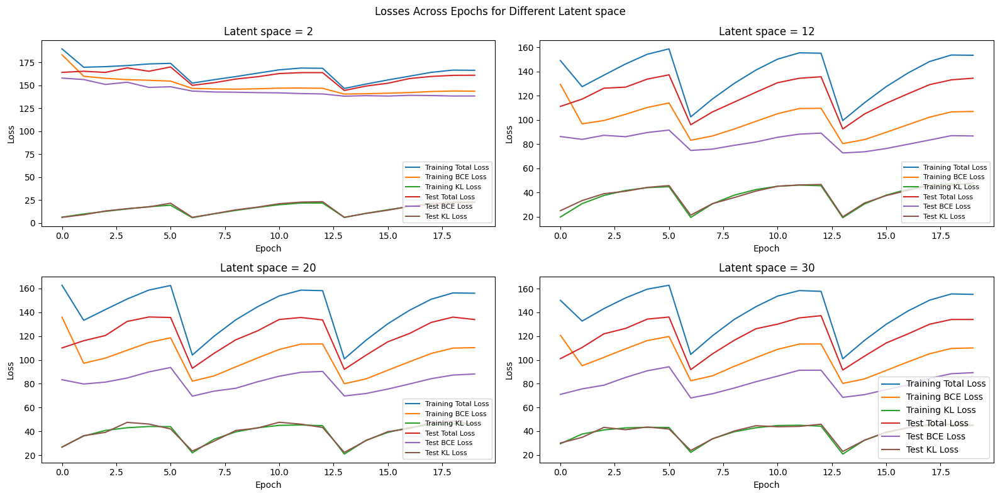

In [72]:
plot_loss_latentspace(training_metrics_latent, testing_metrics_latent, latent_to_test)

##### Code for a simple generation of the trained model in previous part (main model)

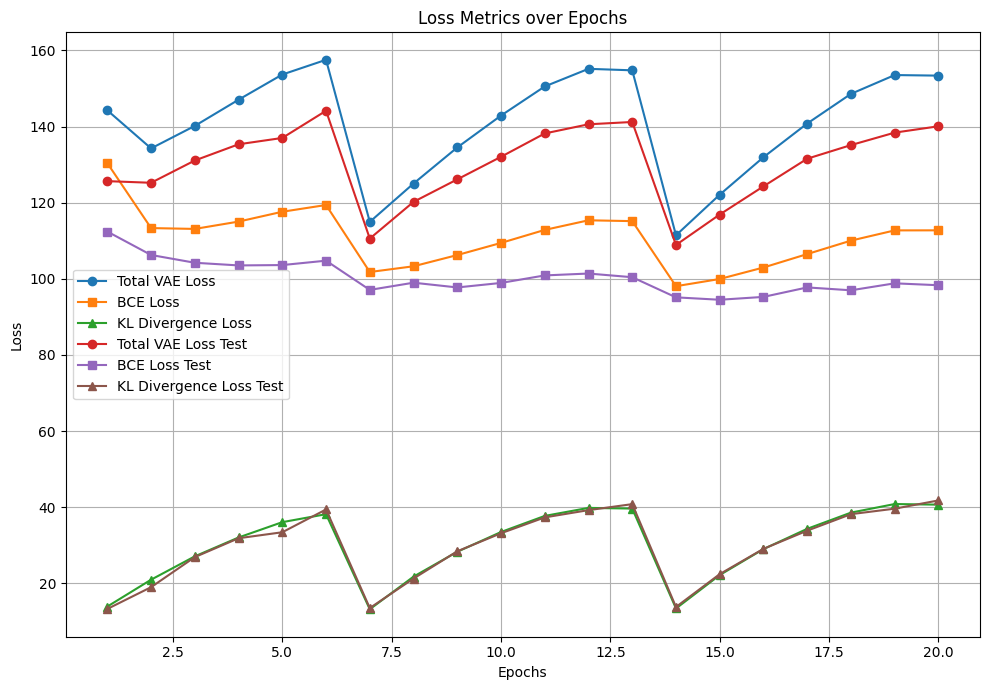

In [19]:
# *CODE FOR PART 1.2a IN THIS CELL*
ep = range(1, len(save_loss_VAE) + 1)

plt.figure(figsize=(10, 7))

plt.plot(ep, save_loss_VAE, label='Total VAE Loss', marker='o')

plt.plot(ep, save_loss_BCE, label='BCE Loss', marker='s')

plt.plot(ep, save_loss_KL, label='KL Divergence Loss', marker='^')

plt.plot(ep, save_loss_test, label='Total VAE Loss Test', marker='o')

plt.plot(ep, save_loss_test_BCE, label='BCE Loss Test', marker='s')

plt.plot(ep, save_loss_test_KL, label='KL Divergence Loss Test', marker='^')

plt.title('Loss Metrics over Epochs') 
plt.xlabel('Epochs')
plt.ylabel('Loss') 
plt.legend()

plt.grid(True)
plt.tight_layout() 

plt.show()

## Part 1.2b: Samples and Reconstructions (6 Points)
Visualize a subset of the images of the test set and their reconstructions **as well as** a few generated samples. Most of the code for this part is provided. You only need to call the forward pass of the model for the given inputs (might vary depending on your implementation).

For reference, here's [some samples from our VAE](https://imgur.com/NwNMuG3).


Input images
--------------------------------------------------
Reconstructed images
--------------------------------------------------
Generated Images
--------------------------------------------------


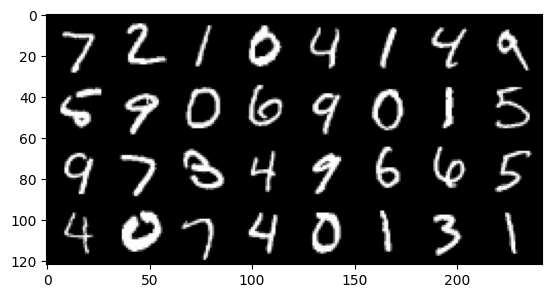

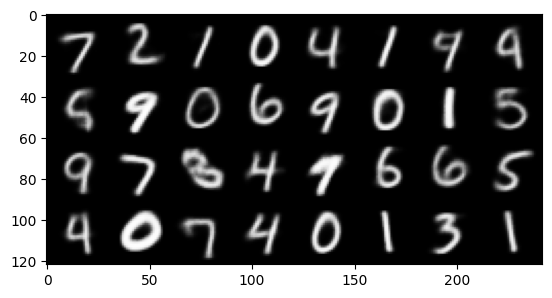

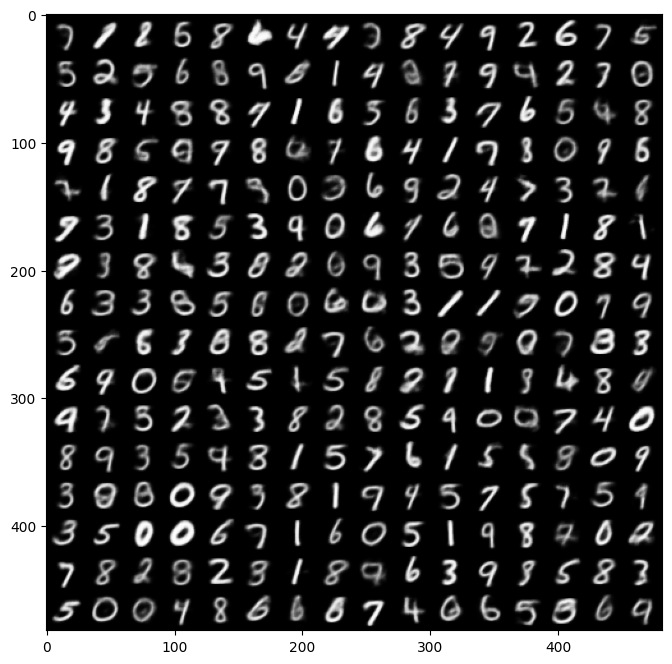

In [21]:
# *CODE FOR PART 1.2b IN THIS CELL*

# load the model
model_1_2b = torch.jit.load(content_path/'CW_VAE/VAE_model.pth')
print('Input images')
print('-'*50)

sample_inputs, _ = next(iter(loader_test))
fixed_input = sample_inputs[0:32, :, :, :]
# visualize the original images of the last batch of the test set
img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
               value_range=None, scale_each=False, pad_value=0)
plt.figure()
show(img)

print('Reconstructed images')
print('-'*50)
with torch.no_grad():
   # visualize the reconstructed images of the last batch of test set

   #######################################################################
   #                       ** START OF YOUR CODE **
   #######################################################################
   recon_batch, _, _, _ = model_1_2b.forward(fixed_input.to(device))
   #######################################################################
   #                       ** END OF YOUR CODE **
   #######################################################################

   recon_batch = recon_batch.cpu()
   recon_batch = make_grid(denorm(recon_batch), nrow=8, padding=2, normalize=False,
                           value_range=None, scale_each=False, pad_value=0)
   plt.figure()
   show(recon_batch)

print('Generated Images')  
print('-'*50)
model_1_2b.eval()
n_samples = 256
z = torch.randn(n_samples,latent_dim).to(device)
with torch.no_grad():
   #######################################################################
   #                       ** START OF YOUR CODE **
   #######################################################################
   samples = model_1_2b.decode(z)
   #######################################################################
   #                       ** END OF YOUR CODE **
   #######################################################################

   samples = samples.cpu()
   samples = make_grid(denorm(samples), nrow=16, padding=2, normalize=False,
                           value_range=None, scale_each=False, pad_value=0)
   plt.figure(figsize = (8,8))
   show(samples)

##### Image reconstruction and generation main model

Input images
--------------------------------------------------
Reconstructed images
--------------------------------------------------
Generated Images
--------------------------------------------------


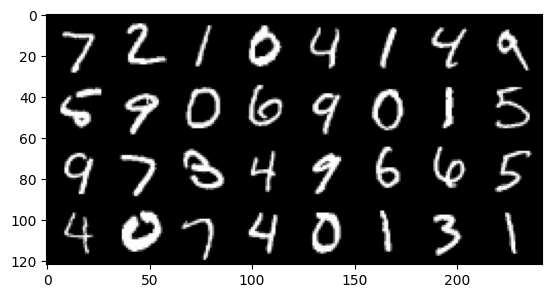

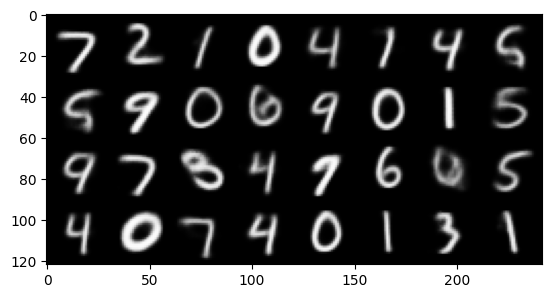

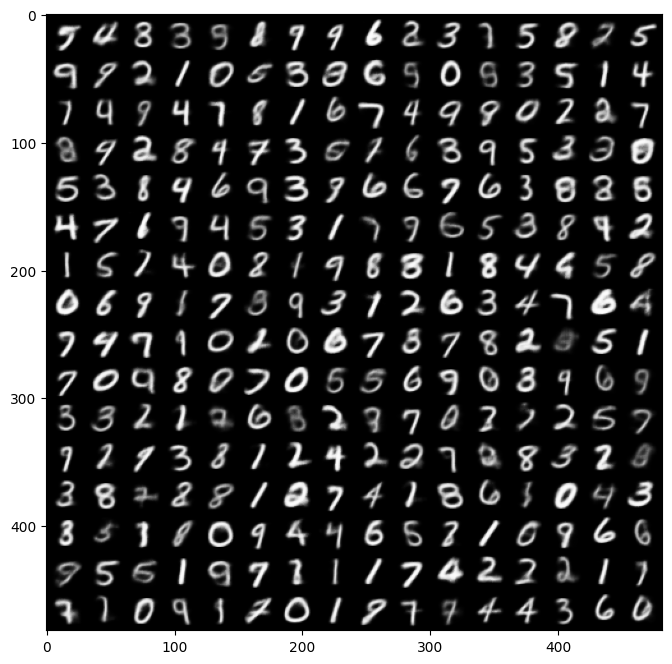

In [40]:
# *CODE FOR PART 1.2b IN THIS CELL*

# load the model
print('Input images')
print('-'*50)

sample_inputs, _ = next(iter(loader_test))
fixed_input = sample_inputs[0:32, :, :, :]
# visualize the original images of the last batch of the test set
img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure()
show(img)

print('Reconstructed images')
print('-'*50)
with torch.no_grad():
    # visualize the reconstructed images of the last batch of test set

    #######################################################################
    #                       ** START OF YOUR CODE **
    #######################################################################
    recon_batch, mu_recon, logvar_recon, z_para = model.forward(fixed_input.to(device))
    #######################################################################
    #                       ** END OF YOUR CODE **
    #######################################################################

    recon_batch = recon_batch.cpu()
    recon_batch = make_grid(denorm(recon_batch), nrow=8, padding=2, normalize=False,
                            value_range=None, scale_each=False, pad_value=0)
    plt.figure()
    show(recon_batch)

print('Generated Images')
print('-'*50)
model.eval()
n_samples = 256
z = torch.randn(n_samples,latent_dim).to(device)
with torch.no_grad():
    #######################################################################
    #                       ** START OF YOUR CODE **
    #######################################################################
    samples = model.decode(z)
    #######################################################################
    #                       ** END OF YOUR CODE **
    #######################################################################

    samples = samples.cpu()
    samples = make_grid(denorm(samples), nrow=16, padding=2, normalize=False,
                            value_range=None, scale_each=False, pad_value=0)
    plt.figure(figsize = (8,8))
    show(samples)



##### Image reconstruction and generation for different beta

In [38]:
def recon_gen_beta(models_b, beta_values, loader_test, device, latent_dim, n_samples=32):
    i = 0
    for m in models_b:
        print('Input images')
        print('-'*50)

        sample_inputs, _ = next(iter(loader_test))
        fixed_input = sample_inputs[0:32, :, :, :]
        # visualize the original images of the last batch of the test set
        img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                        value_range=None, scale_each=False, pad_value=0)
        plt.figure()
        show(img)

        print('Reconstructed images for beta = {}'.format(beta_values[i]))
        print('-'*50)
        with torch.no_grad():

            recon_batch, mu_recon, logvar_recon, z_para = m.forward(fixed_input.to(device))


            recon_batch = recon_batch.cpu()
            recon_batch = make_grid(denorm(recon_batch), nrow=8, padding=2, normalize=False,
                                    value_range=None, scale_each=False, pad_value=0)
            plt.figure()
            show(recon_batch)
            #wait until the images are shown without additional modules
            plt.show()



        print('Generated Images for beta = {}'.format(beta_values[i]))
        print('-'*50)
        m.eval()
        n_samples = 256
        z = torch.randn(n_samples,latent_dim).to(device)
        with torch.no_grad():

            samples = m.decode(z)

            samples = samples.cpu()
            samples = make_grid(denorm(samples), nrow=16, padding=2, normalize=False,
                                    value_range=None, scale_each=False, pad_value=0)
            plt.figure(figsize = (8,8))
            show(samples)
            #wait until the images are shown without additional modules
            plt.show()
        i += 1

Input images
--------------------------------------------------
Reconstructed images for beta = 0.5
--------------------------------------------------


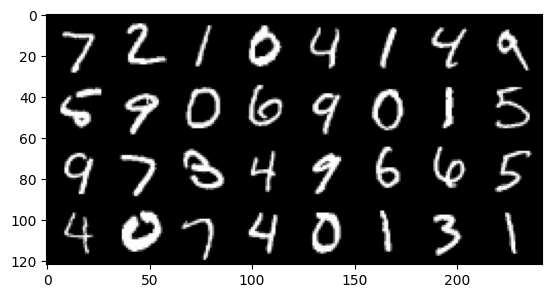

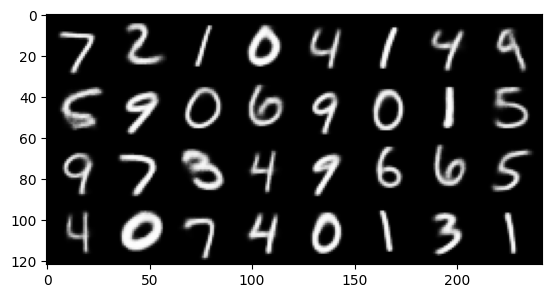

Generated Images for beta = 0.5
--------------------------------------------------


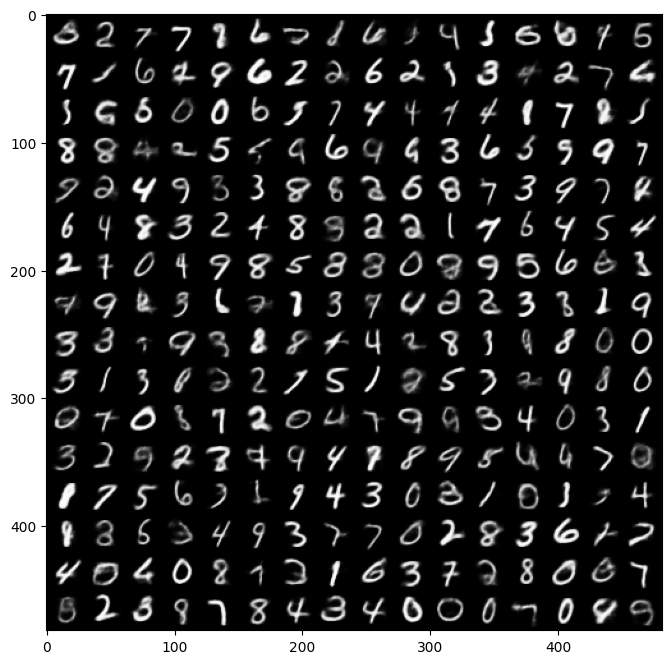

Input images
--------------------------------------------------
Reconstructed images for beta = 4
--------------------------------------------------


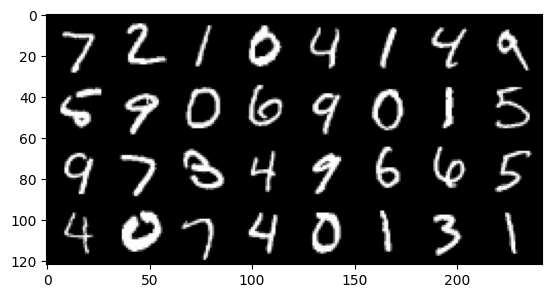

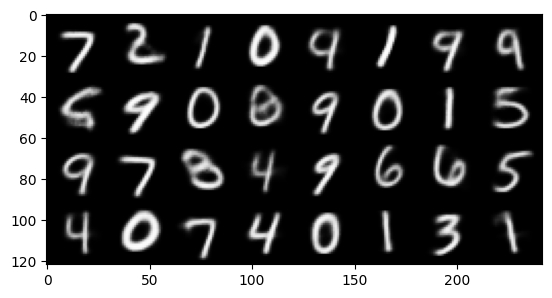

Generated Images for beta = 4
--------------------------------------------------


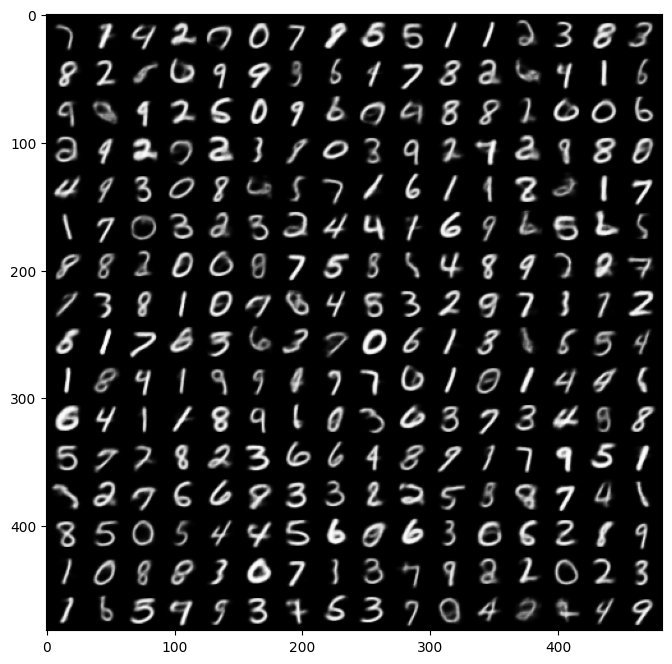

Input images
--------------------------------------------------
Reconstructed images for beta = 20
--------------------------------------------------


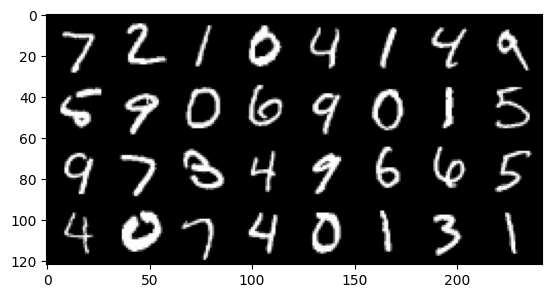

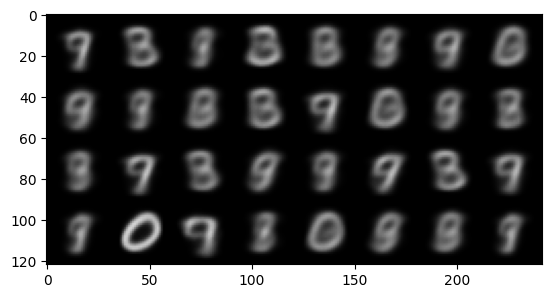

Generated Images for beta = 20
--------------------------------------------------


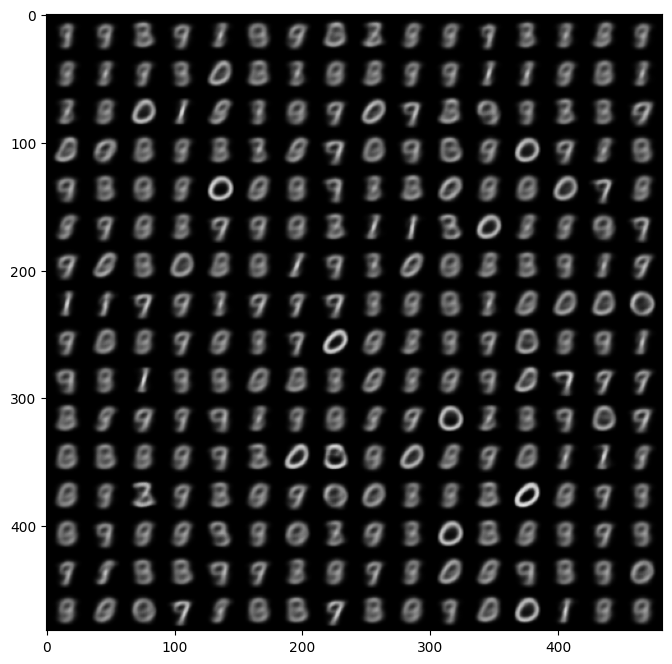

Input images
--------------------------------------------------
Reconstructed images for beta = 50
--------------------------------------------------


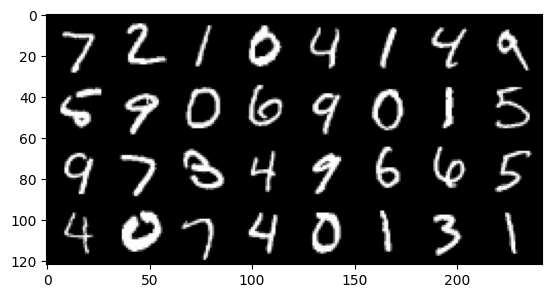

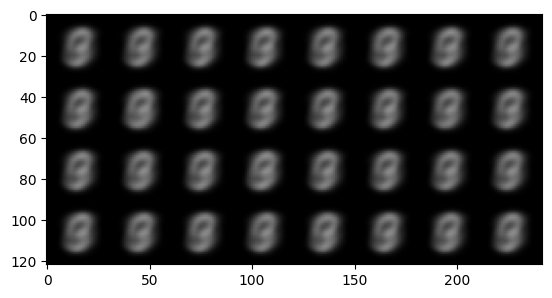

Generated Images for beta = 50
--------------------------------------------------


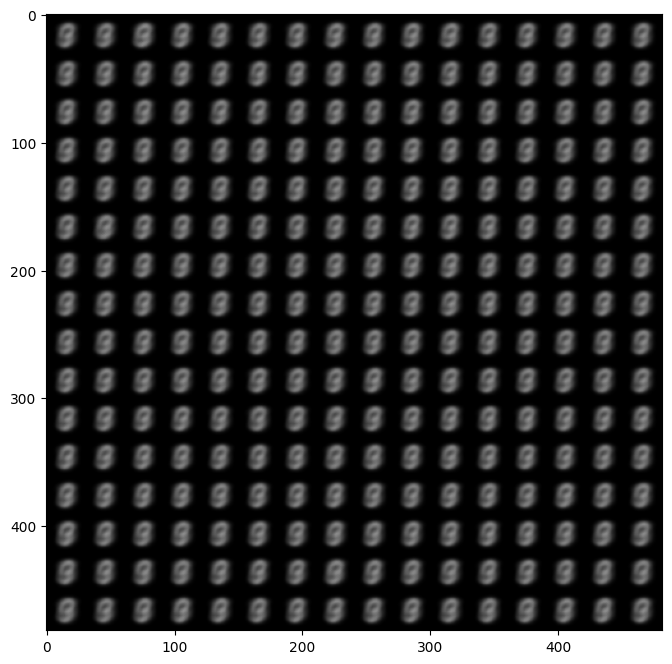

In [39]:
recon_gen_beta(models_beta, beta_to_test, loader_test, device, latent_dim)

##### Image reconstruction and generation for different cyclic beta

In [57]:
def recon_gen_betacyclic(models_b, loader_test, device, latent_dim):
    i = 0
    for m in models_b:
        print('Input images')
        print('-'*50)

        sample_inputs, _ = next(iter(loader_test))
        fixed_input = sample_inputs[0:32, :, :, :]
        # visualize the original images of the last batch of the test set
        img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                        value_range=None, scale_each=False, pad_value=0)
        plt.figure()
        show(img)

        print('Reconstructed images for cyclic beta = {}'.format(i+1))
        print('-'*50)
        with torch.no_grad():

            recon_batch, mu_recon, logvar_recon, z_para = m.forward(fixed_input.to(device))


            recon_batch = recon_batch.cpu()
            recon_batch = make_grid(denorm(recon_batch), nrow=8, padding=2, normalize=False,
                                    value_range=None, scale_each=False, pad_value=0)
            plt.figure()
            show(recon_batch)
            plt.show()

        print('Generated Images for cyclic beta = {}'.format(i+1))
        print('-'*50)
        m.eval()
        n_samples = 256
        z = torch.randn(n_samples,latent_dim).to(device)
        with torch.no_grad():

            samples = m.decode(z)

            samples = samples.cpu()
            samples = make_grid(denorm(samples), nrow=16, padding=2, normalize=False,
                                    value_range=None, scale_each=False, pad_value=0)
            plt.figure(figsize = (8,8))
            show(samples)
            plt.show()
        i += 1

Input images
--------------------------------------------------
Reconstructed images for cyclic beta = 1
--------------------------------------------------


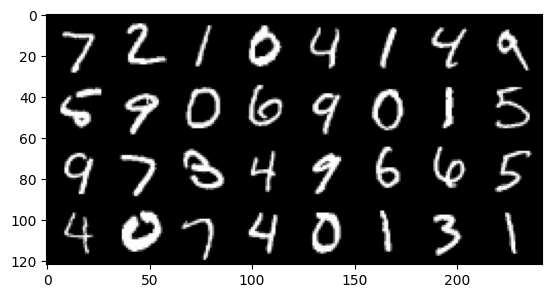

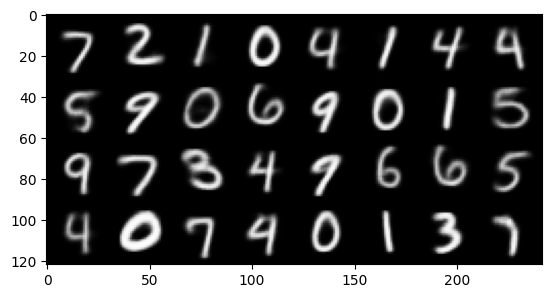

Generated Images for cyclic beta = 1
--------------------------------------------------


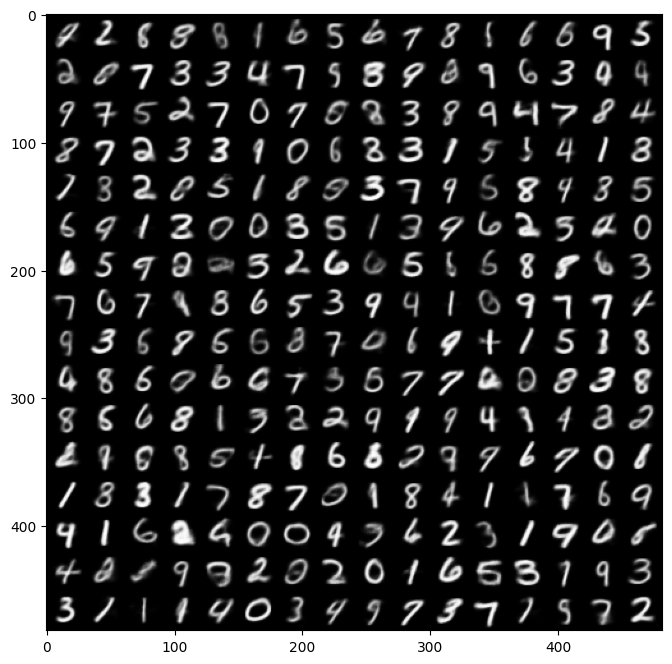

Input images
--------------------------------------------------
Reconstructed images for cyclic beta = 2
--------------------------------------------------


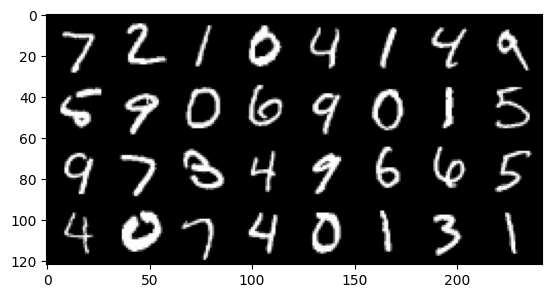

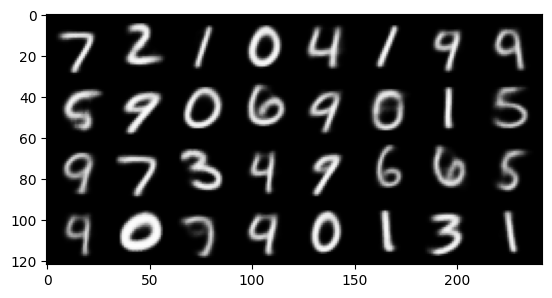

Generated Images for cyclic beta = 2
--------------------------------------------------


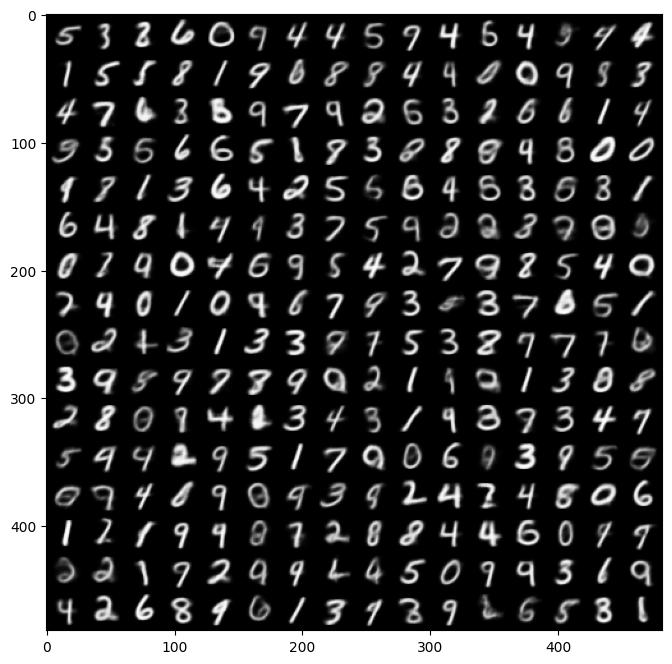

Input images
--------------------------------------------------
Reconstructed images for cyclic beta = 3
--------------------------------------------------


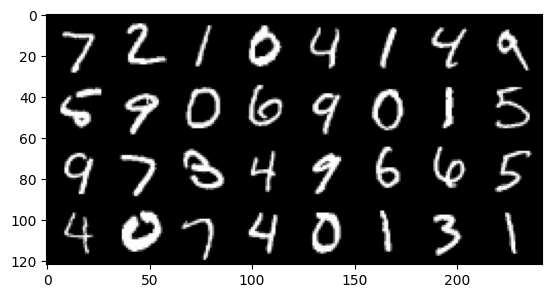

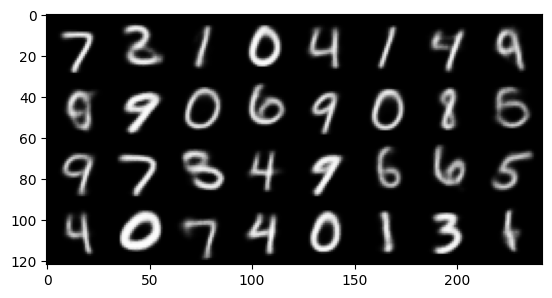

Generated Images for cyclic beta = 3
--------------------------------------------------


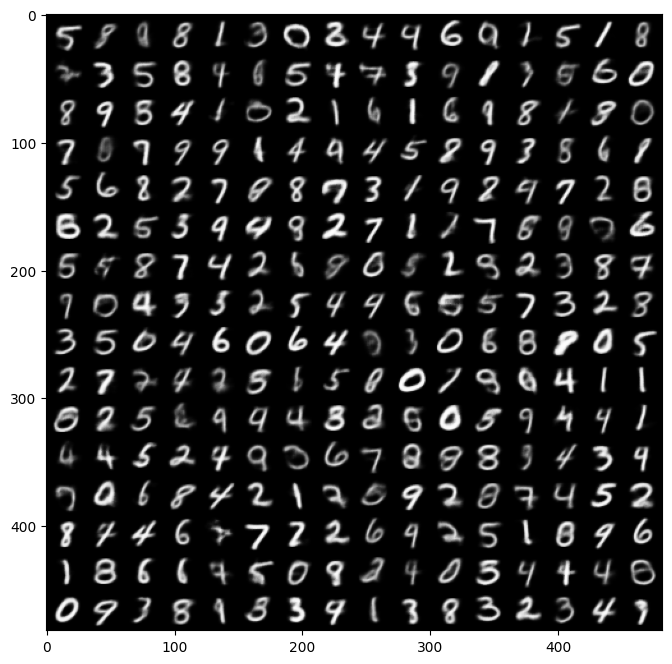

Input images
--------------------------------------------------
Reconstructed images for cyclic beta = 4
--------------------------------------------------


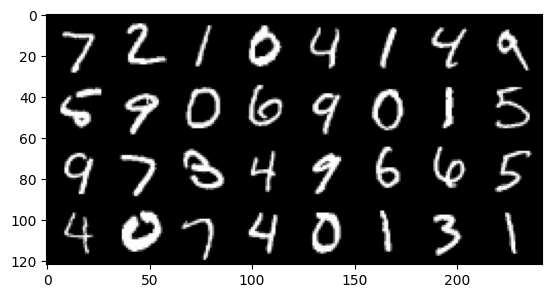

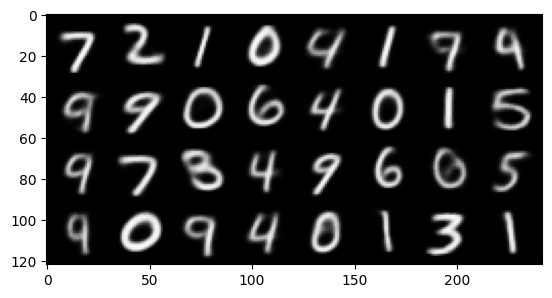

Generated Images for cyclic beta = 4
--------------------------------------------------


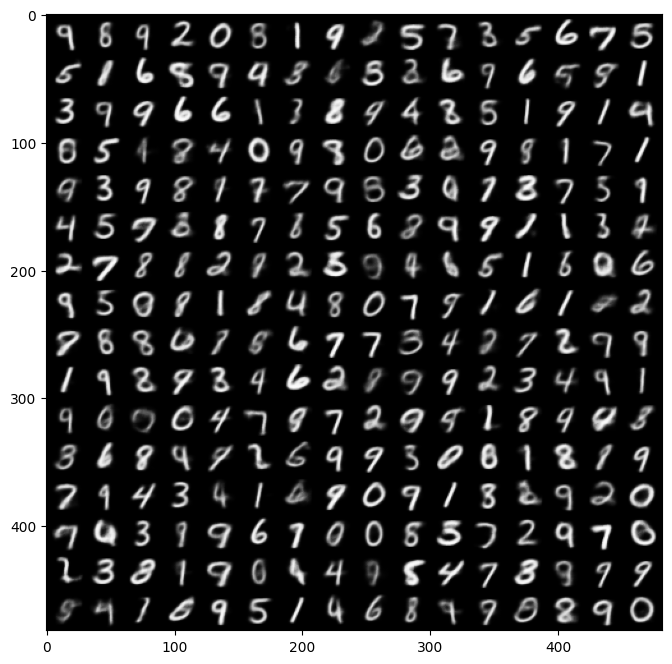

In [58]:
recon_gen_betacyclic(models_betacyclic, loader_test, device, latent_dim)

##### Image reconstruction and generation for different latent space

In [73]:
def recon_gen_latdim(models_b, loader_test, device, latent_dim_list):
    i = 0
    for m in models_b:
        print('Input images')
        print('-'*50)

        sample_inputs, _ = next(iter(loader_test))
        fixed_input = sample_inputs[0:32, :, :, :]
        # visualize the original images of the last batch of the test set
        img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                        value_range=None, scale_each=False, pad_value=0)
        plt.figure()
        show(img)

        print('Reconstructed images for Latent space = {}'.format(latent_dim_list[i]))
        print('-'*50)
        with torch.no_grad():

            recon_batch, mu_recon, logvar_recon, z_para = m.forward(fixed_input.to(device))


            recon_batch = recon_batch.cpu()
            recon_batch = make_grid(denorm(recon_batch), nrow=8, padding=2, normalize=False,
                                    value_range=None, scale_each=False, pad_value=0)
            plt.figure()
            show(recon_batch)
            plt.show()

        print('Generated Images for Latent space = {}'.format(latent_dim_list[i]))
        print('-'*50)
        m.eval()
        n_samples = 256
        z = torch.randn(n_samples,latent_dim_list[i]).to(device)
        with torch.no_grad():

            samples = m.decode(z)

            samples = samples.cpu()
            samples = make_grid(denorm(samples), nrow=16, padding=2, normalize=False,
                                    value_range=None, scale_each=False, pad_value=0)
            plt.figure(figsize = (8,8))
            show(samples)
            plt.show()
        i += 1

Input images
--------------------------------------------------
Reconstructed images for Latent space = 2
--------------------------------------------------


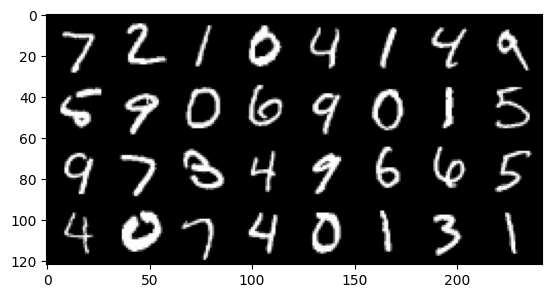

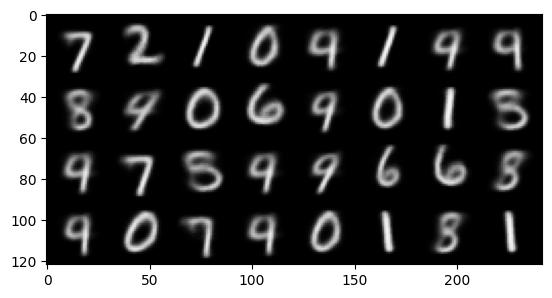

Generated Images for Latent space = 2
--------------------------------------------------


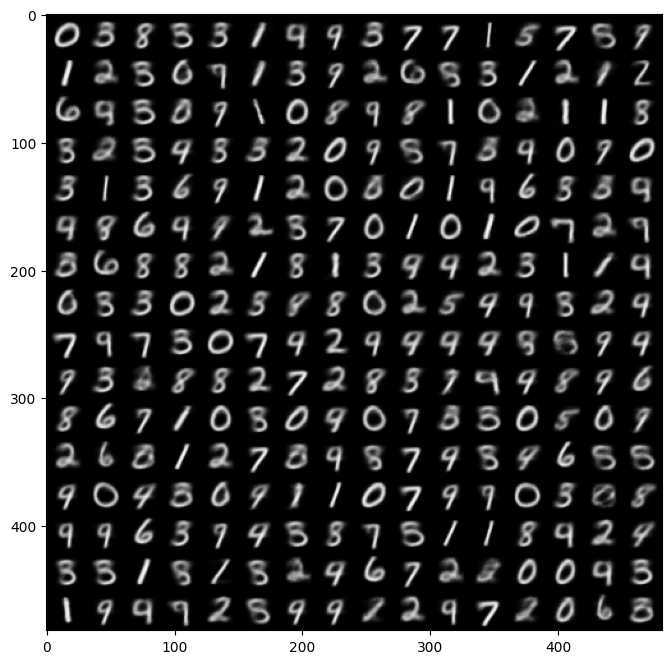

Input images
--------------------------------------------------
Reconstructed images for Latent space = 12
--------------------------------------------------


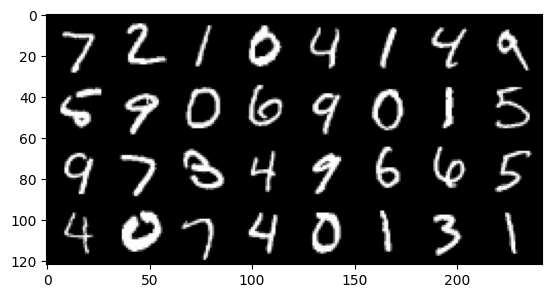

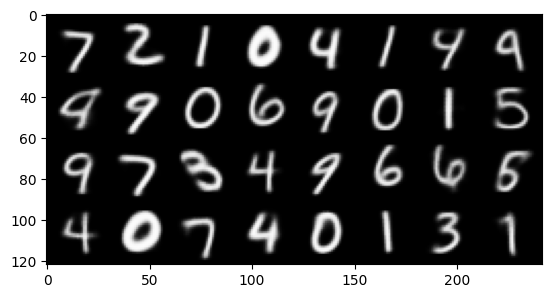

Generated Images for Latent space = 12
--------------------------------------------------


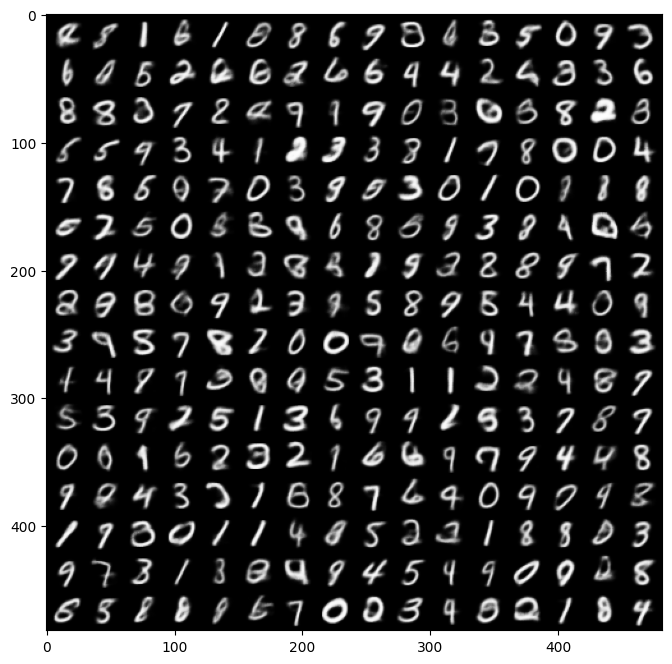

Input images
--------------------------------------------------
Reconstructed images for Latent space = 20
--------------------------------------------------


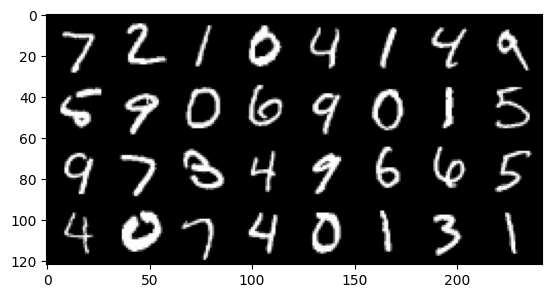

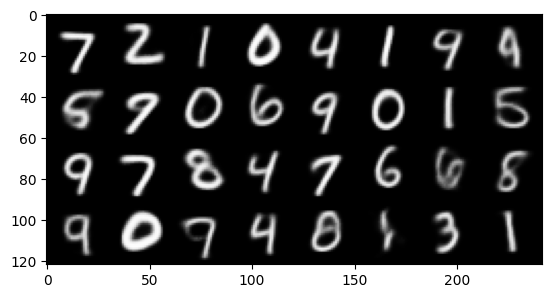

Generated Images for Latent space = 20
--------------------------------------------------


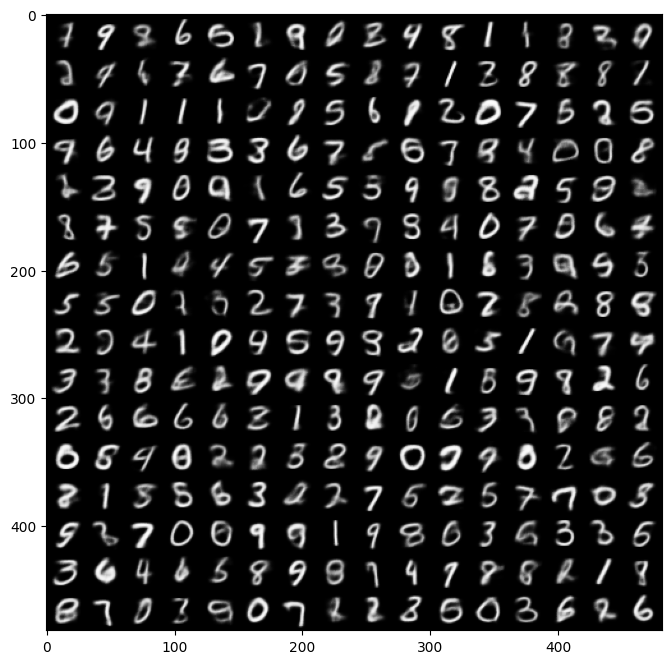

Input images
--------------------------------------------------
Reconstructed images for Latent space = 30
--------------------------------------------------


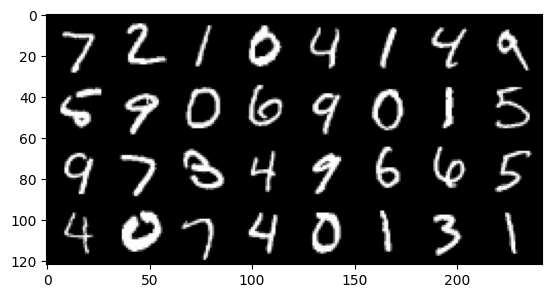

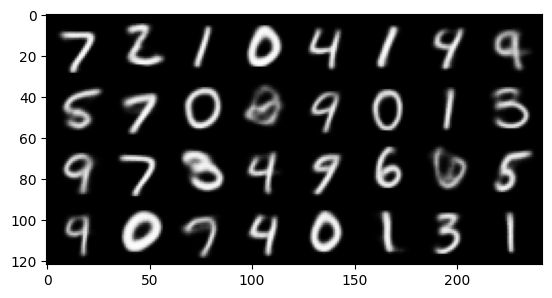

Generated Images for Latent space = 30
--------------------------------------------------


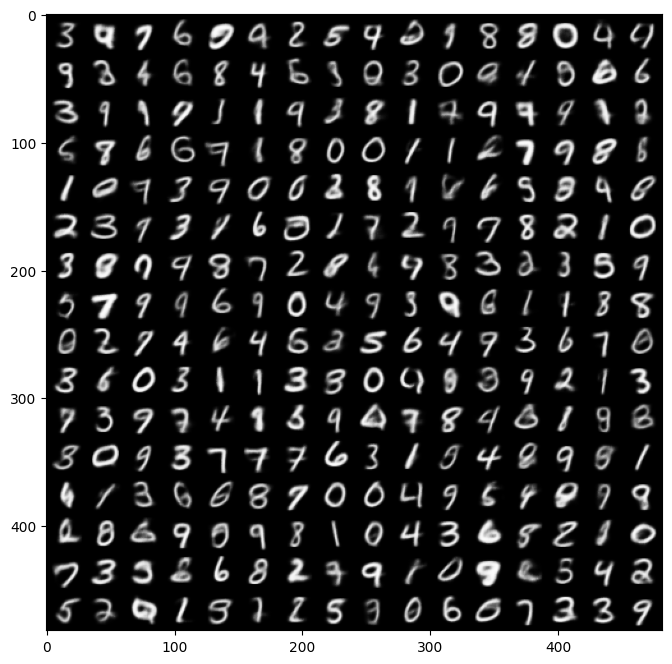

In [74]:
recon_gen_latdim(models_latent, loader_test, device, latent_to_test)

### Discussion
Provide a brief analysis of your loss curves and reconstructions:
* What do you observe in the behaviour of the log-likelihood loss and the KL loss (increasing/decreasing)?
* Can you intuitively explain if this behaviour is desirable?
* What is posterior collapse and did you observe it during training (i.e. when the KL is too small during the early stages of training)?
    * If yes, how did you mitigate it? How did this phenomenon reflect on your output samples?
    * If no, why do you think that is?

**YOUR ANSWER**


Firstly we refer to the "main model" as the model with the following hyperparemeters:
- learning rate: 0.0005
- epoch: 20
- batch size: 128
- latent space dimension: 6
- beta: np_beta_cyclic (varying between 1 and 5.3)
The idea of a cyclical $\beta$ is taken from the following paper: "Cyclical Annealing Schedule: A Simple Approach to Mitigating KL Vanishing".

We explored the influence of beta through fixed values: 0.5, 4, 20, and 50. Given our primary model utilizes a cyclical beta, we also examined the impact of various cyclic beta configurations.

Additionally, we conducted experiments by varying the dimensions of the latent space.

<br>

#### Behaviour of the log-likelihood loss and the KL loss:

**Main model Analysis**
Our main model, employing a cyclic beta, displays fluctuating and decreasing loss curves. The cyclical behvaiour of $\beta$ directly influences the "train" and "test" KL loss, demonstrating its significant impact.

Both "Train Loss" and "Test Loss" exhibit fluctuations in accordance with the cyclical $\beta$ setup. Despite this, the general trend is a decrease over time, indicating a correct learning.

The "Train BCE Loss" and "Test BCE Loss" also show fluctuating yet consistently decreasing trends as the epochs progress, suggesting an improvement in the model's reconstruction capability. This aligns with our objective of enhancing the model's ability to accurately reconstruct inputs ("autoencoder aspect").

The "Train KL Loss" and "Test KL Loss" also exhibit fluctuations, aligning with our use of a cyclical $\beta$. This suggests a modulation of focus between generation capability and reconstruction accuracy. Below, we will highlight that this design choice is efficient to manage the trade-off between reconstruction and generation. 

However, this cyclical behaviour should be manage carefully as we observe the KL losses not decreasing over time. Therefore, changing hyperparameters could lead to a model's latent space that diverges from the prior distribution, if the KL loss explodes in term of value. However, the slight increase in KL loss can be seen as a desirable behaviour (see below).


**Fixed Beta Analysis**
- For $\beta$ = 0.5: We observe a low KL loss and a stable, decreasing reconstruction loss. This indicates minor emphasis on the KL divergence, potentially leading to under-regularized latent space and less consistency with the prior distribution.

- For $\beta$ = 4: In this configuration, there is an overall balanced behaviour with a decreasing reconstruction loss and a slightly evolving KL loss. Here the KL loss is different from zero and indicates a favor towards generative capability. This is already a behaviour that is likely to give sensible results.

- For $\beta$ = 20: This scenario represents a KL divergence that is heavily weigthed, leading to prioritization of latent space structure over input. This results in a near-constant reconstruction loss. At this point the performances are becoming worse, and the system starts to ignore the input.

- For $\beta$ = 50: We can observe an anomaly with a spike in all losses at around epoch 10. Here the training is clearly unstable with an unbalanced loss. Neither the BCE's nor the KL's losses are improving. We are in the case that we previously mentionned the part: loss explanation. Indeed the decoder is almost independent making the input useless. Therefore the latent does not incorporate information from the input, leading to a the model that performs poorly on both fronts.


**Cyclic Beta Analysis**
- For $\beta_{cyclic}$ 1: Beta increases linearly with epochs, indicating that the regularization strength is increasing. This can help in gradually shaping the latent space while still focusing on reconstruction at the beginning. We observe a gradual regularization of the latent space, with slowly increasing total, BCE, and KL losses. Additionnaly, the KL loss increases more than the BCE loss, which make sense with this configuration.

- For $\beta_{cyclic}$ 2 and 3: These 2 configurations, shows two similar patterns but at a different frequencies. The $\beta_{cyclic}$ 2 can be more efficient for a long training. On the other hand $\beta_{cyclic}$ 3 can be a solution to regularize the latent space with a smaller number of epochs.

- For $\beta_{cyclic}$ 4: The beta values show extreme oscillations, which likely contributes to the instability in the loss curves. This suggests an overly aggressive cyclic patterns, causing the model to frequently shift its focus between reconstruction and regularization.


**Latent Space Analysis**

Varying the latent space dimension from 2 to 30 revealed that a 2-dimensional space is easily interpretable and effective, forcing the model to focus on critical features. Indeed we can directly visualize the latent without additional transformation (see question 1.3). Increasing dimensions adds model's complexity and sensitivity to the loss curves.


<br>

### Behaviour desirable or not?

**Desirable behaviour:**

Our results from fixed and cyclical $\beta$ align logically with theoretical models. We observe that both "Test" and "Training" curves follow similar patterns. 

It should be noted that during training we inject noise during the reparametrization step. Incorporating a noise term during Gaussian sampling, which is essential for differentiation with respect to the model's parameters. Thus, the reparametrization step is critical.

An overall decreasing BCE loss signifies the VAE's improving capability in reconstructing input data accurately, crucial for a model whose primary function includes data reconstruction.

As previously mentioned, setting $\beta$ carefully is vital to prevent the KL divergence from overshadowing the reconstruction loss. A stable or slightly increasing KL divergence loss is desirable, indicating the model's latent space is capturing meaningful representations and continues to learn. In addition, maintaining a stable or decreasing test loss suggests effective training (here test is assimilated to the validation set) and helps avoid overfitting. <br>
It is essential for the VAE to perform well not only on training data but also on unseen data, represented by the test set. The goal is to achieve an optimal balance, enabling generalization and the right degree of disentanglement to prevent excessive class overlap.

Therefore, we aim for a balanced evolution between the two objectives, employing a cyclic $\beta$ in our main model.


**Undesirable behaviour:**

Flat loss curves, especially early in training, may indicate the model's inability to learn or improve due to unbalanced loss. For instance for $\beta$ values in the range [20, 50], we can observe poor reconstruction, attributed to the disproportionate emphasis on KL divergence. Concurrently, the decoder becomes independent, a phenomenon observable through unchanging loss curves. Consequently it affects generation quality and leading to non sense outputs.

Such behaviours are indicative of potential posterior collapse.

Also, a cyclic beta that is changing too rapidly or with excessive amplitude can destabilize the training process. 

<br>

### Posterior Collapse

**Phenomenom Observation:**

The Posterior Collapse appears under unbalanced loss conditions, especially with overly large $\beta$ values, undermining reconstruction capabilities. The encoder fails to adequately process input information, mapping data inputs to a restricted number of points within the latent space. Additionally, the decoder relies primarily on the prior distribution, rendering the latent space unused. Ultimately, posterior collapse results in nonsensical generation outcomes.

A higher likelihood of collapse occurs with an increased number of epochs and a dominating KL loss, particularly for $\beta$ values within [20, 50].


**Solution to Collapse issue:**

- *Cyclical $\beta$*: Employing cyclical $\beta$ in our experiments yielded sensible outcomes in terms of loss curves, image reconstruction, and generation. Thus this is a powerful method enhancing the model's robustness. A cyclic $\beta$, that fluctuates over epochs allows the model to alternatively focus on reconstruction and regularization.

- *Network Structure*: Investigating the impact of network complexity could be beneficial. A more complex structure might improve information capture.

- *Hyperparameters*: The choice of epoch number and batch size directly affects posterior collapse. An interesting path to investigate could be an hyperparameters search among these two parameters.


How to improve performance? Aiming for a compact model, we prioritized design choices to enhance performance. However, the results are not perfect regarding the reconstruction and the generation. Indeed, we could aim for more clearly defined digits in the reconstruction and better generation with less blurring. For improvement, adjusting the architecture to include a deeper network and expanded latent space could enhance reconstruction quality and capacity. 
Further research could focus on identifying a new cyclic $\beta$ suitable for this revised architecture.

Plot can be found in the folders in the zip: "part_1_2a" and "part_1_2b". Also:
https://drive.google.com/drive/folders/1Bai4NrFSTCwwSYBYzItkZ89ABn1XCSIv?usp=sharing
https://drive.google.com/drive/folders/18XtBrNhAqgHyXiRH_t4ny_KuNGLhjh8h?usp=sharing

---
<h2> Part 1.3 (11 points) <h2/>

Qualitative analysis of the learned representations

In this question you are asked to qualitatively assess the representations that your model has learned. In particular:

a. Dimensionality Reduction of learned embeddings

b. Interpolating in the latent space

## Part 1.3a: T-SNE on Embeddings (7 Points)
Extract the latent representations of the test set and visualize them using [T-SNE](https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding)  [(see implementation)](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html). You can use a T-SNE implementation from a library such as scikit-learn.

We've provided a function to visualize a subset of the data, but you are encouraged to also produce a matplotlib plot (please use different colours for each digit class).

In [24]:
# *CODE FOR PART 1.3a IN THIS CELL

#Please find below all the cell related to the plot generation for different model and configuration.
model_1_3a = torch.jit.load(content_path/'CW_VAE/VAE_model.pth')

In [25]:
from sklearn.manifold import TSNE

# Interactive Visualization - Code Provided
test_dataloader_main = DataLoader(test_dat, 10000, shuffle=False)
""" Inputs to the function are
        z_embedded - Embedded X, Y positions for every point in test_dataloader
        test_dataloader - dataloader with batchsize set to 10000
        num_points - number of points plotted (will slow down with >1k)
"""

with torch.no_grad():
    for i, (data, label) in enumerate(test_dataloader_main):
        data = data.to(device)
        output_test_main, mu_test_main, logvar_test_main, z_test_main = model_1_3a.forward(data)


z_test_main = z_test_main.cpu().detach().numpy() 

   
tsne_main = TSNE(n_components=2, init='pca', learning_rate='auto', perplexity=20)
z_embedded_main = tsne_main.fit_transform(z_test_main)

plot_tsne(z_embedded_main, test_dataloader_main, num_points=1000, darkmode=False)

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


alt.HConcatChart(...)

##### Visualization of latent space for main model (TSNE and PCA for 2D and 3D visualization)

In [26]:
def plot_sklearn_TSNE(test_dat, model, nb_comp_tsne, perplexity_val, device):

    test_dataloader = DataLoader(test_dat, 10000, shuffle=False)
    model.eval()

    z_all = []  # List to store all latent vectors
    label_all = []  # List to store all labels

    with torch.no_grad():
        for i, (data, label) in enumerate(test_dataloader):
            data = data.to(device)
            output_test, mu_test, logvar_test, z_test = model.forward(data)
            z_all.append(z_test.cpu().detach().numpy())  # Assuming you want to run t-SNE on CPU
            label_all.append(label.cpu().detach().numpy())

    # Concatenate all latent vectors
    z_all = np.concatenate(z_all, axis=0)
    label_all = np.concatenate(label_all, axis=0)
   
    tsne = TSNE(n_components=nb_comp_tsne, init='pca', learning_rate='auto', perplexity=perplexity_val)
    z_embedded = tsne.fit_transform(z_all)

    if nb_comp_tsne == 2:
        fig = plt.figure(figsize=(12, 8))
        plt.scatter(z_embedded[:, 0], z_embedded[:, 1], c=label_all, cmap='tab10', s=10)
        plt.colorbar()
        plt.title(f'2D t-SNE of the latent space with perplexity = {perplexity_val}')
        plt.show()

    elif nb_comp_tsne == 3:
        fig = plt.figure(figsize=(12, 8))
        ax = fig.add_subplot(111, projection='3d')
        scatter = ax.scatter(z_embedded[:, 0], z_embedded[:, 1], z_embedded[:, 2], c=label_all, cmap='tab10', s=10)
        plt.colorbar(scatter)
        plt.title(f'3D t-SNE of the latent space with perplexity = {perplexity_val}')
        plt.show()

    else:
        print('Number of components for t-SNE must be 2 or 3')

    return z_embedded, label_all

In [27]:
model_1_3a = torch.jit.load(content_path/'CW_VAE/VAE_model.pth')

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


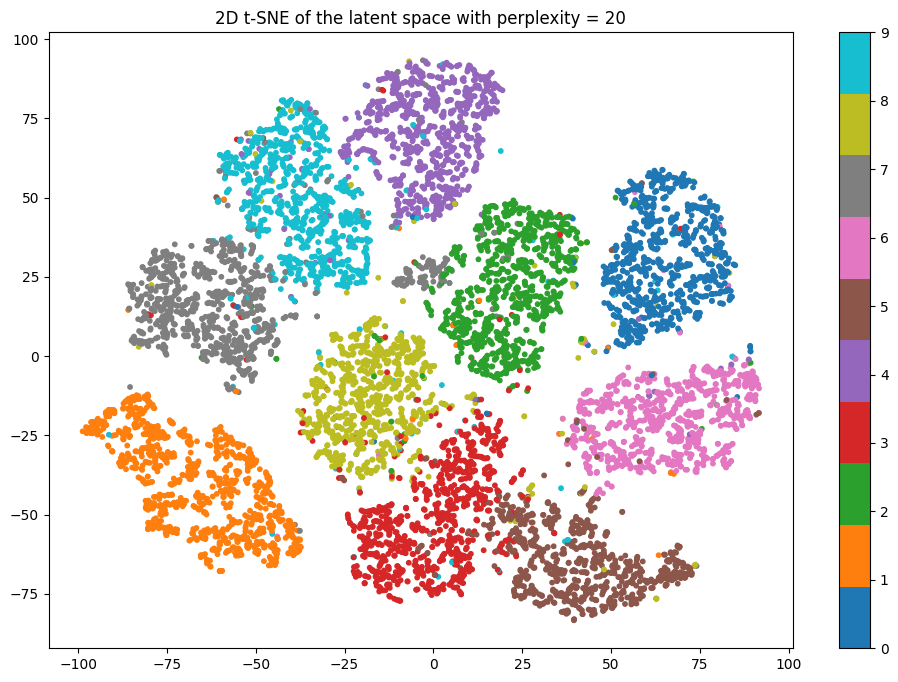

In [28]:
a1, a2 = plot_sklearn_TSNE(test_dat, model_1_3a, 2, 20, device)

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


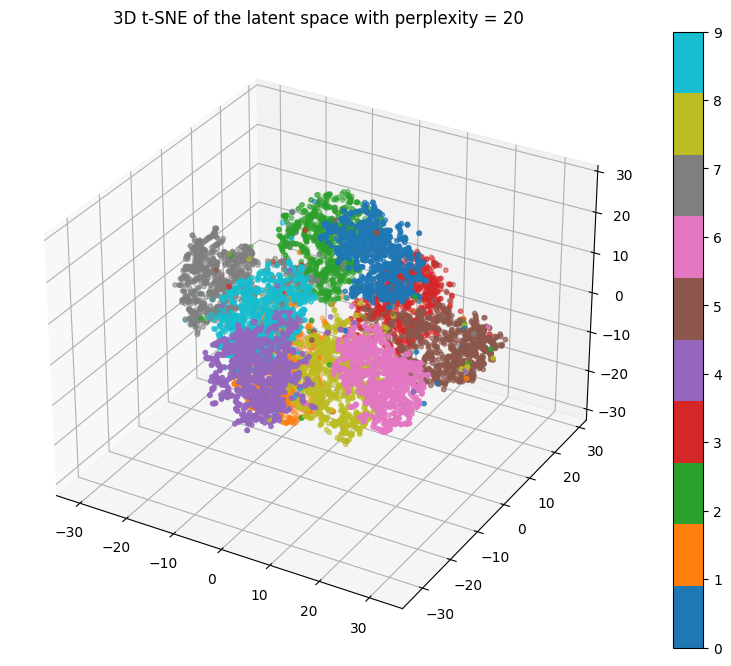

In [19]:
b1, b2 = plot_sklearn_TSNE(test_dat, model_1_3a, 3, 20, device)

##### Visualization of latent space for different beta values

In [40]:
def plot_TSNE_beta(test_dat, models_b, nb_comp_tsne, perplexity_val, beta_values, device):

    test_dataloader = DataLoader(test_dat, 10000, shuffle=False)

    for j, m in enumerate(models_b):
        m.eval()

        z_all = []  # List to store all latent vectors
        label_all = []  # List to store all labels

        with torch.no_grad():
            for i, (data, label) in enumerate(test_dataloader):
                data = data.to(device)
                output_test, mu_test, logvar_test, z_test = m.forward(data)
                z_all.append(z_test.cpu().detach().numpy())  # Assuming you want to run t-SNE on CPU
                label_all.append(label.cpu().detach().numpy())

        # Concatenate all latent vectors
        z_all = np.concatenate(z_all, axis=0)
        label_all = np.concatenate(label_all, axis=0)
    
        tsne = TSNE(n_components=nb_comp_tsne, init='pca', learning_rate='auto', perplexity=perplexity_val)
        z_embedded = tsne.fit_transform(z_all)

        if nb_comp_tsne == 2:
            fig = plt.figure(figsize=(10, 6))
            plt.scatter(z_embedded[:, 0], z_embedded[:, 1], c=label_all, cmap='tab10', s=10)
            plt.colorbar()
            plt.title(f'2D t-SNE of the latent space with perplexity = {perplexity_val} and beta = {beta_values[j]}')
            plt.show()

        elif nb_comp_tsne == 3:
            fig = plt.figure(figsize=(10, 6))
            ax = fig.add_subplot(111, projection='3d')
            scatter = ax.scatter(z_embedded[:, 0], z_embedded[:, 1], z_embedded[:, 2], c=label_all, cmap='tab10', s=10)
            plt.colorbar(scatter)
            plt.title(f'3D t-SNE of the latent space with perplexity = {perplexity_val} and beta = {beta_values[j]}')
            plt.show()

        else:
            print('Number of components for t-SNE must be 2 or 3')

    return z_embedded, label_all

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


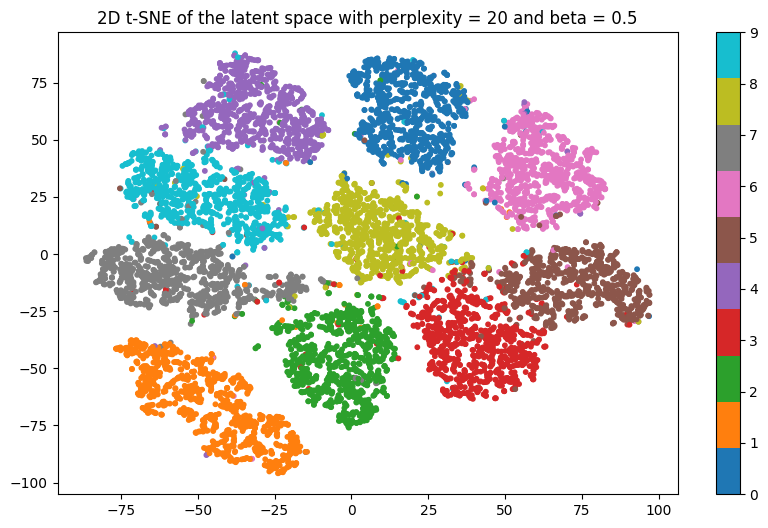

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


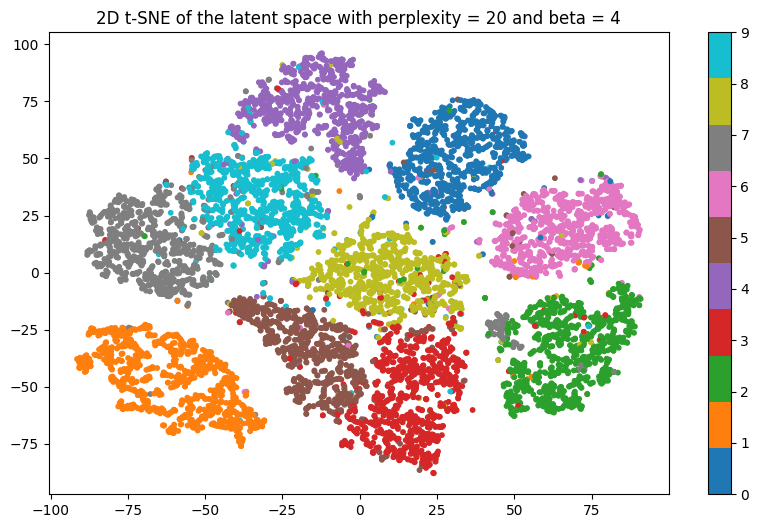

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


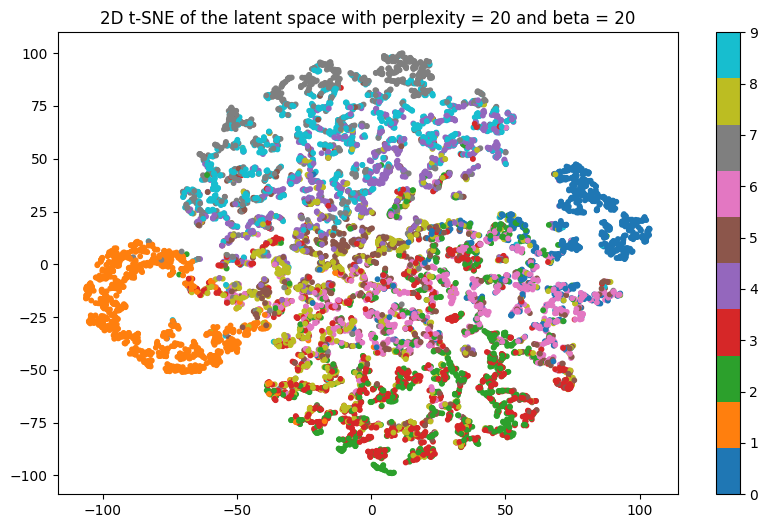

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


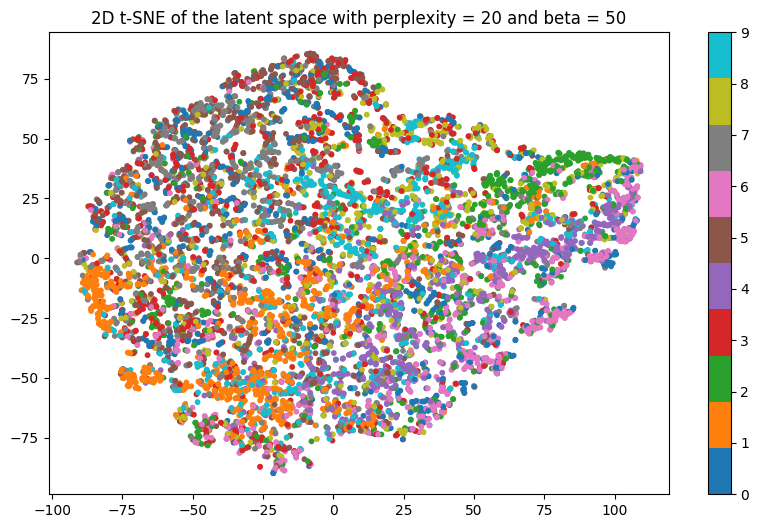

In [41]:
TSNE_beta1, TSNE_beta2 = plot_TSNE_beta(test_dat, models_beta, 2, 20, beta_to_test, device)

##### Visualization of latent space for different cyclic beta

In [59]:
def plot_TSNE_betacyclic(test_dat, models_b, nb_comp_tsne, perplexity_val, device):

    test_dataloader = DataLoader(test_dat, 10000, shuffle=False)

    for j, m in enumerate(models_b):
        m.eval()

        z_all = []  # List to store all latent vectors
        label_all = []  # List to store all labels

        with torch.no_grad():
            for i, (data, label) in enumerate(test_dataloader):
                data = data.to(device)
                output_test, mu_test, logvar_test, z_test = m.forward(data)
                z_all.append(z_test.cpu().detach().numpy())  # Assuming you want to run t-SNE on CPU
                label_all.append(label.cpu().detach().numpy())

        # Concatenate all latent vectors
        z_all = np.concatenate(z_all, axis=0)
        label_all = np.concatenate(label_all, axis=0)
    
        tsne = TSNE(n_components=nb_comp_tsne, init='pca', learning_rate='auto', perplexity=perplexity_val)
        z_embedded = tsne.fit_transform(z_all)

        if nb_comp_tsne == 2:
            fig = plt.figure(figsize=(10, 6))
            plt.scatter(z_embedded[:, 0], z_embedded[:, 1], c=label_all, cmap='tab10', s=10)
            plt.colorbar()
            plt.title(f'2D t-SNE of the latent space with perplexity = {perplexity_val} and beta cyclic = {j+1}')
            plt.show()

        elif nb_comp_tsne == 3:
            fig = plt.figure(figsize=(10, 6))
            ax = fig.add_subplot(111, projection='3d')
            scatter = ax.scatter(z_embedded[:, 0], z_embedded[:, 1], z_embedded[:, 2], c=label_all, cmap='tab10', s=10)
            plt.colorbar(scatter)
            plt.title(f'3D t-SNE of the latent space with perplexity = {perplexity_val} and beta cyclic = {j+1}')
            plt.show()

        else:
            print('Number of components for t-SNE must be 2 or 3')


    return z_embedded, label_all

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


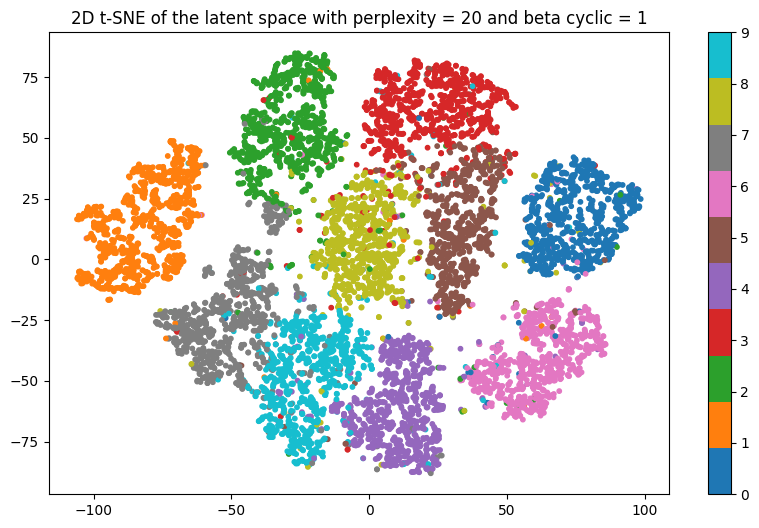

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


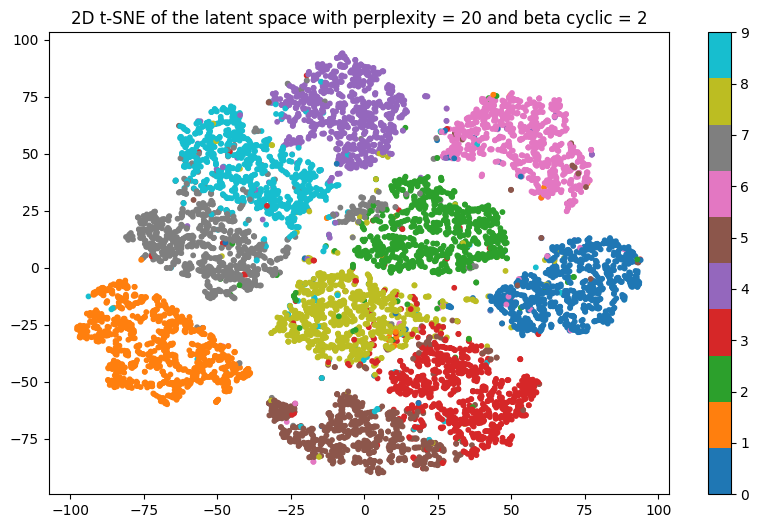

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


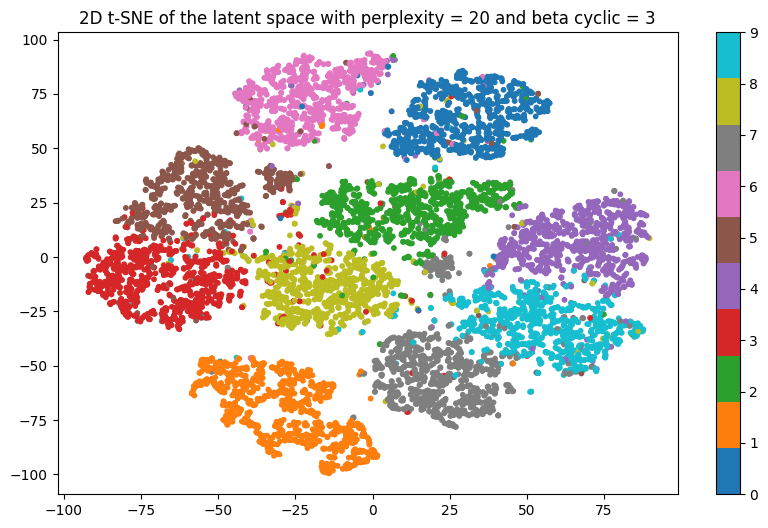

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


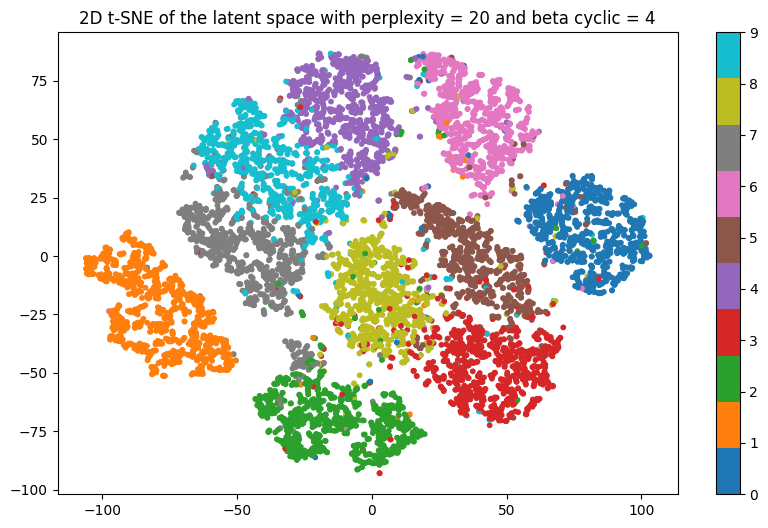

(array([[-48.922604 , -12.012008 ],
        [  4.349608 , -81.26047  ],
        [-64.52922  , -21.513172 ],
        ...,
        [ -4.7455697,  43.503864 ],
        [ 21.125517 ,  21.724792 ],
        [ 49.197906 ,  46.792778 ]], dtype=float32),
 array([7, 2, 1, ..., 4, 5, 6]))

In [60]:
plot_TSNE_betacyclic(test_dat, models_betacyclic, 2, 20, device)

##### Visualization of latent for different perplexity

In [65]:
def plot_TSNE_perp(test_dat, model_m, nb_comp_tsne, perplexity_list, device):

    test_dataloader = DataLoader(test_dat, 10000, shuffle=False)

    for perp in perplexity_list:
        model_m.eval()

        z_all = []  # List to store all latent vectors
        label_all = []  # List to store all labels

        with torch.no_grad():
            for i, (data, label) in enumerate(test_dataloader):
                data = data.to(device)
                output_test, mu_test, logvar_test, z_test = model_m.forward(data)
                z_all.append(z_test.cpu().detach().numpy())  # Assuming you want to run t-SNE on CPU
                label_all.append(label.cpu().detach().numpy())

        # Concatenate all latent vectors
        z_all = np.concatenate(z_all, axis=0)
        label_all = np.concatenate(label_all, axis=0)
    
        tsne = TSNE(n_components=nb_comp_tsne, init='pca', learning_rate='auto', perplexity=perp)
        z_embedded = tsne.fit_transform(z_all)

        fig = plt.figure(figsize=(10, 6))
        plt.scatter(z_embedded[:, 0], z_embedded[:, 1], c=label_all, cmap='tab10', s=10)
        plt.colorbar()
        plt.title(f'2D t-SNE of the latent space of main model with perplexity = {perp}')
        plt.show()

    return z_embedded, label_all

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


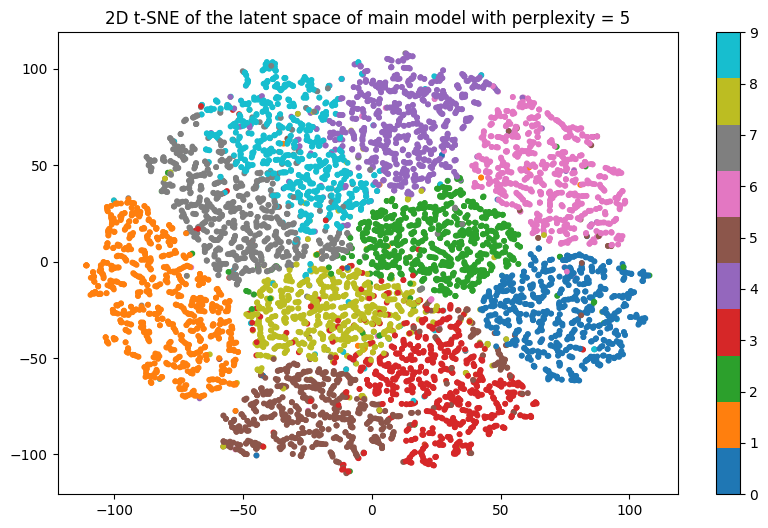

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


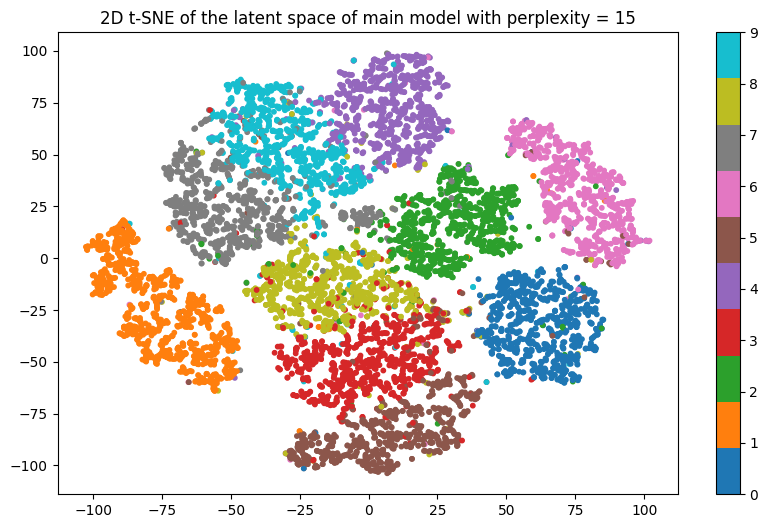

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


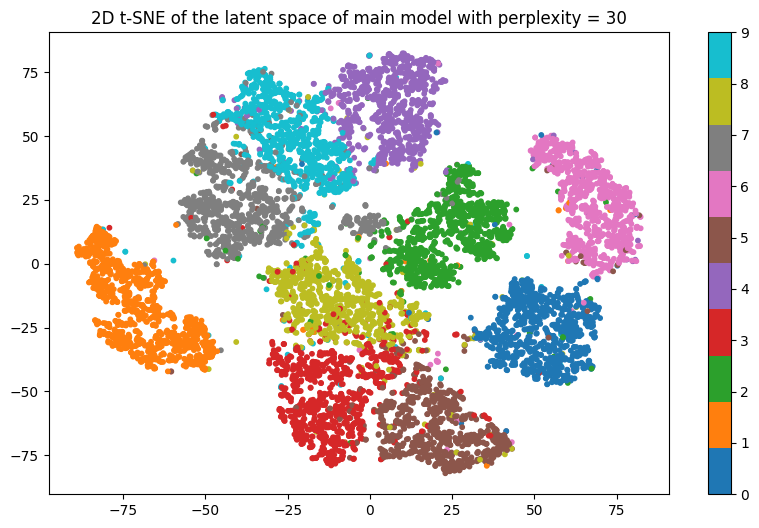

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


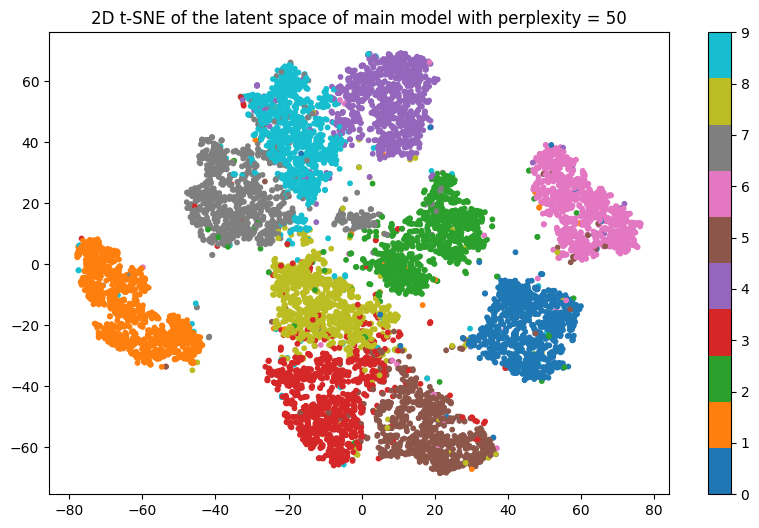

(array([[-36.948368,  17.022402],
        [ 15.014384,  -5.271539],
        [-63.580494, -17.044127],
        ...,
        [  8.106044,  42.509342],
        [ 31.916294, -62.45848 ],
        [ 71.092445,   9.757901]], dtype=float32),
 array([7, 2, 1, ..., 4, 5, 6]))

In [66]:
plot_TSNE_perp(test_dat, model, 2, [5, 15, 30, 50], device)

##### Visualization of the model latent space for a model with latent_dim = 2

In [79]:
def plot_TSNE_latents(test_dat, models_b, nb_comp_tsne, perplexity_val, latentdim_list, device):

    test_dataloader = DataLoader(test_dat, 10000, shuffle=False)

    for j, m in enumerate(models_b):
        m.eval()

        z_all = []  # List to store all latent vectors
        label_all = []  # List to store all labels

        with torch.no_grad():
            for i, (data, label) in enumerate(test_dataloader):
                data = data.to(device)
                output_test, mu_test, logvar_test, z_test = m.forward(data)
                z_all.append(z_test.cpu().detach().numpy())  # Assuming you want to run t-SNE on CPU
                label_all.append(label.cpu().detach().numpy())

        # Concatenate all latent vectors
        z_all = np.concatenate(z_all, axis=0)
        label_all = np.concatenate(label_all, axis=0)
    
        tsne = TSNE(n_components=nb_comp_tsne, init='pca', learning_rate='auto', perplexity=perplexity_val)
        z_embedded = tsne.fit_transform(z_all)

        if nb_comp_tsne == 2:
            fig = plt.figure(figsize=(10, 6))
            plt.scatter(z_embedded[:, 0], z_embedded[:, 1], c=label_all, cmap='tab10', s=10)
            plt.colorbar()
            plt.title(f'2D t-SNE of the latent space with perplexity = {perplexity_val} and model latent dim = {latentdim_list[j]}')
            plt.show()

        elif nb_comp_tsne == 3:
            fig = plt.figure(figsize=(10, 6))
            ax = fig.add_subplot(111, projection='3d')
            scatter = ax.scatter(z_embedded[:, 0], z_embedded[:, 1], z_embedded[:, 2], c=label_all, cmap='tab10', s=10)
            plt.colorbar(scatter)
            plt.title(f'3D t-SNE of the latent space with perplexity = {perplexity_val} and model latent dim = {latentdim_list[j]}')
            plt.show()

        else:
            print('Number of components for t-SNE must be 2 or 3')


    return z_embedded, label_all

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


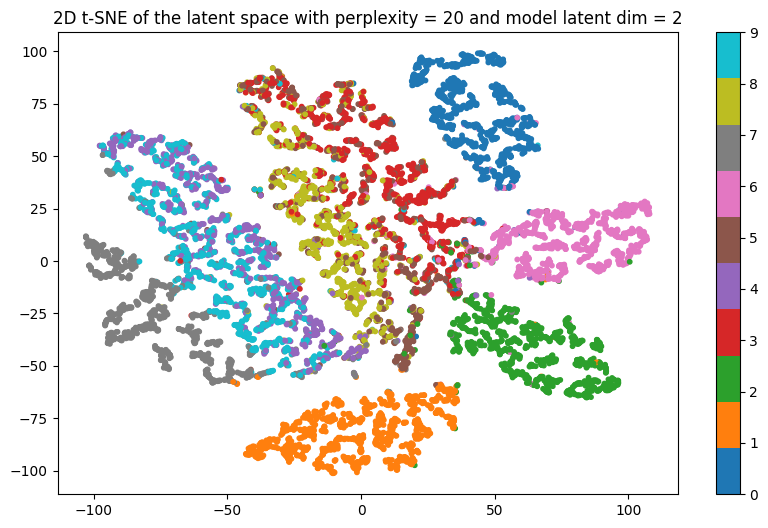

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


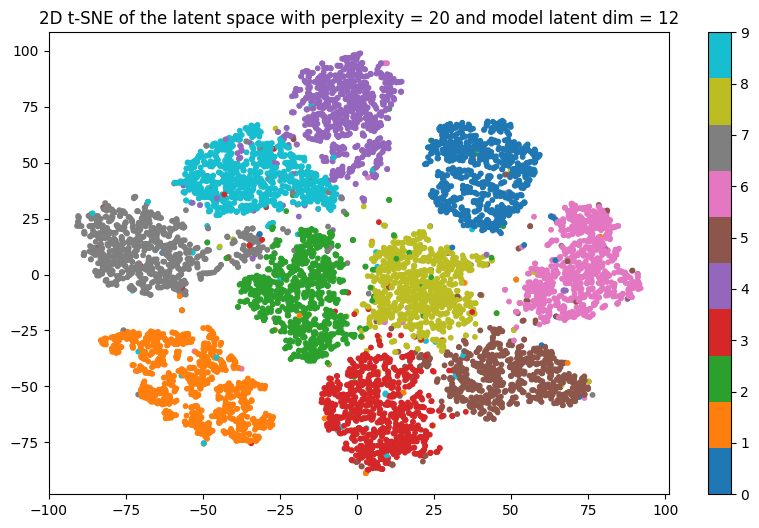

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


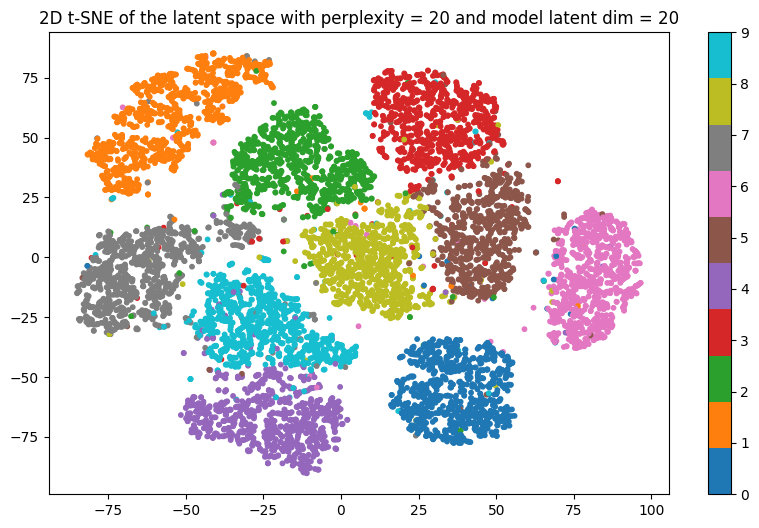

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


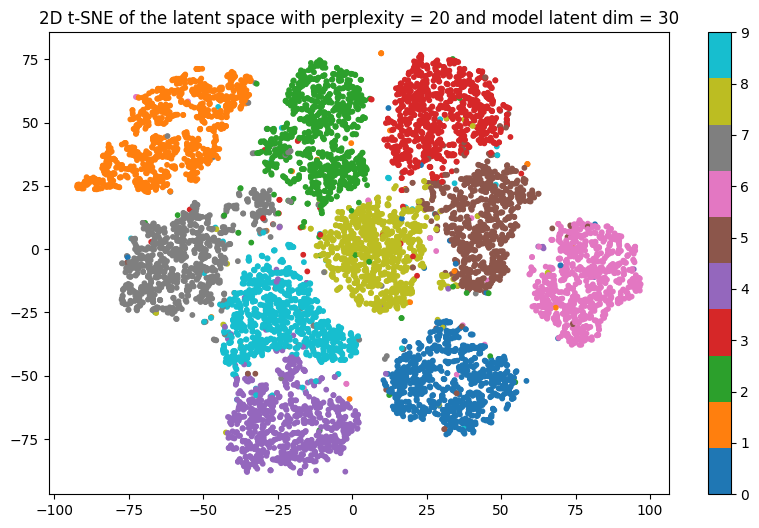

(array([[-68.37846  ,   5.62327  ],
        [ -1.1588535,  31.456478 ],
        [-48.037766 ,  37.27045  ],
        ...,
        [-11.8577585, -59.83835  ],
        [ 39.970264 ,  -9.059173 ],
        [ 89.94306  ,  -5.5547686]], dtype=float32),
 array([7, 2, 1, ..., 4, 5, 6]))

In [80]:
plot_TSNE_latents(test_dat, models_latent, 2, 20, latent_to_test, device)

In [75]:
def extract_latent_representation(model_ldim2, test_dat, device):
    
    test_dataloader = DataLoader(test_dat, 10000, shuffle=False)

    model_ldim2.eval()

    z_list = []
    label_list = []

    with torch.no_grad():
        for i, (data, label) in enumerate(test_dataloader):
                
            data = data.to(device)
            recon_batch, mu, logvar, z_para = model_ldim2.forward(data)

            z_para = z_para.cpu().detach().numpy()
            label = label.cpu().detach().numpy()
            
            z_list.append(z_para)
            label_list.append(label)

    z_list = np.concatenate(z_list, axis=0)
    label_list = np.concatenate(label_list, axis=0)

    fig = plt.figure(figsize=(12, 8))
    plt.scatter(z_list[:, 0], z_list[:, 1], c=label_list, cmap='tab10', s=10)
    plt.colorbar()
    plt.title('Model with a 2D latent space')
    plt.show()

    return z_list, label_list

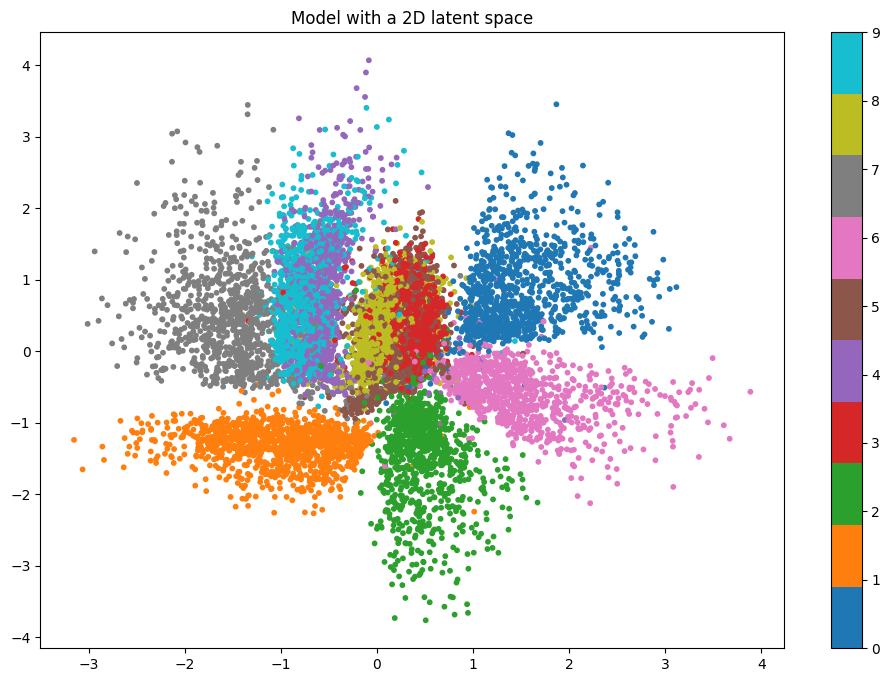

(array([[-1.7997198 ,  0.36186552],
        [ 0.83250165, -2.781786  ],
        [-0.79079753, -1.7918963 ],
        ...,
        [-0.7295208 , -0.05527971],
        [-0.01399091, -0.5425226 ],
        [ 1.3178934 , -0.22290188]], dtype=float32),
 array([7, 2, 1, ..., 4, 5, 6]))

In [76]:
extract_latent_representation(models_latent[0], test_dat, device)

### Discussion
What do you observe? Discuss the structure of the visualized representations.
* What do you observe? What role do the KL loss term and $\beta$ have, if any, in what you observe (multiple matplotlib plots may be desirable here)?
    * Consider Outliers
    * Counsider Boundaries
    * Consider Clusters
* Is T-SNE reliable? What happens if you change the parameters (don't worry about being particularly thorough). [This link](https://distill.pub/2016/misread-tsne/) may be helpful.

Note - If you created multiple plots and want to include them in your discussion, the best option is to upload them to (e.g.) google drive and then embed them via a **public** share link. If you reference local files, please include these in your submission zip, and use relative pathing if you are embedding them (with the notebook in the base directory)

**YOUR ANSWER**


For analyzing the latent space, we consider not only our main model but also variations with fixed and cyclical $\beta$. We explore the outcomes when the dimension of the latent space is set to 2.

To visualize the latent space we used the TSNE transformation from scikit-learn.

<br>

#### Latent space representation

**Main model Analysis**
- *Clusters*: Distinct clusters for each number from 0 to 9 are observable, indicating that the Variational Autoencoder (VAE) has successfully learned to separate different types of data points based on similar structures and properties. Overall, this visualization is an hint that our model had a correct training process and learned a meaningful representation of the data. It should be noted that we do not want too much variance within the distribution, because it affects reconstruction ability. In fact, our aim is to obtain tightly grouped clusters (small spread of points in the latent space), without overlapping. The TSNE transformation, particularly sensitive to the perplexity parameter, aids in this visualization, potentially leading to varying results based on its setting.

- *Outliers*: Outliers fall into two categories: those misplaced in another cluster, suggesting either discrepancies in class representation by our VAE or outliers sharing many properties with a different class; and isolated data points, which are not part of any main clusters. The latter could mean that the VAE finds difficult to categorize a datapoint, or they could be due to noise in the data.

- *Boundaries*: Generally, clusters are well-separated, with clear boundaries reducing ambiguity and demonstrating the model's ability to distinguish between classes. However, some overlap exists, especially between similar digits (e.g., 4 and 9), indicating shared structural characteristics.


Spaces between clusters suggest potential for model improvement towards a more compact latent space. It should be noted that this representation is also influenced by the perplexity value (see Reliability of TSNE).

The 3-D visualisation offers additional insights into cluster separation and inter-cluster relationships, highlighting the spatial gap between them. For example, digit 1's cluster appears to encircle digit 3's cluster, illustrating the model's nuanced understanding of data relationships.



**Fixed $\beta$ Analysis**

- For $\beta \in [0.5, 4]$: Well-defined clusters indicate distinct data type representations within the latent space across this $\beta$ range. Lower $\beta$ values, closer to 0.5, introduce more outliers, slightly impairing generative capabilities. But it emphasizes reconstruction loss to capture detailed features, leading to a clear separation. Higher $\beta$ values prioritize KL divergence, leading to a more regularized latent space but potentially losing detail in feature capture.

- For $\beta \in [20, 50]$: Clusters become indiscernible, with a mixed distribution of data points, reflecting a latent space increasingly detached from the input due to heavy KL divergence emphasis. This results in a posterior collapse, with a uniform distribution and no clear discernible boundaries. Near $\beta$ = 20 some kind of cluster regions emerges, but fails to meaningfully represent data. Near $\beta$ = 50, every point can be considerer as outlier and the distribution tend to be uniform.


**Cyclical model Analysis**

Employing a cyclical $\beta$ yields a robust model, structuring the latent space effectively. This cycling between prioritizing reconstruction and generative capabilities enables the VAE to learn meaningful data representations while maintaining generative quality.


<br>

#### Reliability of TSNE

To analyse the reliability of TSNE, we only studied the impact of the perplexity parameter. The perplexity is link to the effective number of neighbors each point considers.

We used the TSNE to visualizee high-dimensional data (from 6 to 2 dimensions). The perplexity plays an important role of how the TSNE transformation aggregates data. 

- Low perplexity, seems to produce fairly distinct but spread-out clusters. In this configuration the gap (empty space) between cluster is very small. In this configuration we can observe local differences and interactions.

- Increasing perplexity (from 15 to 50) tightens clusters but enlarges gaps, reducing relevance for local interactions and emphasizing global structure. For high perplexity, around 40 to 50, it emphasises the global structure and almost eliminates the local relationships observation.

- A perplexity between 15 and 20 for our case, seems to be an interesting trade-off between highlighting local and global structures. 


As we can see, TSNE is relatively sensitive to perplexity. Therefore this parameter have to be carefully set in order to highlight desired structural and interactional aspects of the data.


<br>

**Bonus**: To be able to have an idea of the latent space representation without adding any additional transformation, such as TSNE, we also build a model with a two dimensional latent space. This model's latent space reveals concerning overlaps in the centre and significant variance among some classes, indicating a promising but improvable approach. Especially we could aim for a more compact and distinct representation.


Plot can be found in the folders in the zip: "part_1_3a". Also:
https://drive.google.com/drive/folders/1l8E5J2-aNs6fgXCna1t2JudhhHq2BhKW?usp=sharing

## Part 1.3b: Interpolating in $z$ (4 Points)
Perform a linear interpolation in the latent space of the autoencoder by choosing any two digits from the test set. What do you observe regarding the transition from on digit to the other?

_hint: Locate the positions in latent space of 2 data points (maybe a one and an eight). Then sample multiple latent space vectors along the line which joins the 2 points and pass them through the decoder._


**Identification of datapoints:**

We identify from the TSNE plot 2 data points that will help to sample mutiple latent space vectors.

We retainsthe following configuration: 7 to 4.

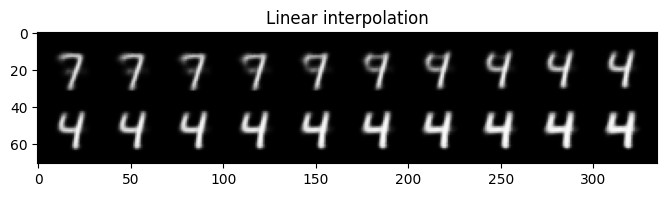

In [30]:
# CODE FOR PART 1.3b IN THIS CELL

def z_choice(model_inter, test_dat, point1, point2, device):
  test_dataloader = DataLoader(test_dat, 10000, shuffle=False)
  model_inter.eval()

  z_para_inter = 0
  label_inter = 0

  with torch.no_grad():
    for i, (data, label) in enumerate(test_dataloader):
                
      data = data.to(device)
      recon_batch, mu, logvar, z_para = model_inter.forward(data)

      z_para_inter = z_para.cpu().detach().numpy()
      label_inter = label.cpu().detach().numpy()


  list_point1 = np.where(label_inter==point1)[0]
  list_point2 = np.where(label_inter==point2)[0]

  index_point1 = list_point1[5]  #choose an index in the list designing the point1
  index_point2 = list_point2[12] #choose an index in the list designing the point2

  z_space_1 = z_para_inter[index_point1]  #vector of the latent space for the point1
  z_space_2 = z_para_inter[index_point2]  #vector of the latent space for the point1

  return z_space_1, z_space_2


def interpolation_z(model_inter, z1, z2, n_steps, device):

  latent_space_vectors = np.linspace(start=z1, stop=z2, num=n_steps)

  latent_space_vectors = torch.as_tensor(data=latent_space_vectors, device=device)

  # Decode the choosen latent space vectors from 7 to 4
  with torch.no_grad():
      decoded_vector = model_inter.decode(latent_space_vectors)

  decoded_vector = decoded_vector.cpu()

  # Plotting the result
  results = make_grid(denorm(decoded_vector), nrow=10, padding=5, normalize=False, 
                              range=None, scale_each=False, pad_value=0)
  plt.figure(figsize = (8,8))
  plt.title(f'Linear interpolation')
  show(results)


# load the model
model_1_3b = torch.jit.load(content_path/'CW_VAE/VAE_model.pth')
aq1, aq2 = z_choice(model_1_3b, test_dat, 7, 4, device)
interpolation_z(model_1_3b, aq1, aq2, 20, device)

### Discussion
What did you observe in the interpolation? Is this what you expected?
* Can you relate the interpolation to your T-SNE visualization

**YOUR ANSWER**


For linear interpolation, we chose to transition from digit 7 to digit 4. It is interesting to examine this path because, to go from digit 7 to digit 4, we must "cross" through the cluster of digit 9. This analysis is derived from the information provided by the t-SNE plot. Indeed, these three digits share parts of their structure, making it interesting to perform an interpolation to observe how the samples are reconstructed.

 
In our results of linear interpolation, we observe the anticipated path. However, we also expected a slightly better representation of digit 9 in the interpolation.

Regarding the transition, we achieved something relatively smooth and progressive. There are no abrupt changes in the interpolation.


Plot can be found in the folders in the zip: "part_1_3a". Also: 
https://drive.google.com/drive/folders/14y6qsSJg1NUvR9s-teynxzvSsK6fl9G-?usp=sharing

# Part 2 - Deep Convolutional GAN

In this task, your main objective is to train a DCGAN (https://arxiv.org/abs/1511.06434) on the CIFAR-10 dataset. You should experiment with different architectures and tricks for stability in training (such as using different activation functions, batch normalization, different values for the hyper-parameters, etc.). In the end, you should provide us with:

- your best trained model (which we will be able to load and run),
- some generations for the fixed latent vectors $\mathbf{z}\sim \mathcal{N}\left(\mathbf{0}, \mathbf{I}\right)$ we have provided you with (train for a number of epochs and make sure there is no mode collapse),
- plots with the losses for the discriminator $D$ and the generator $G$ as the training progresses and explain whether your produced plots are theoretically sensible and why this is (or not) the case.
- a discussion on whether you noticed any mode collapse, where this behaviour may be attributed to, and explanations of what you did in order to cope with mode collapse.

## Part 2.1 (30 points)
**Your Task**:

a. Implement the DCGAN architecture.

b. Define a loss and implement the Training Loop

c. Visualize images sampled from your best model's generator ("Extension" Assessed on quality)

d. Discuss the experimentations which led to your final architecture. You can plot losses or generated results by other architectures that you tested to back your arguments (but this is not necessary to get full marks).


_Clarification: You should not be worrying too much about getting an "optimal" performance on your trained GAN. We want you to demonstrate to us that you experimented with different types of DCGAN variations, report what difficulties transpired throughout the training process, etc. In other words, if we see that you provided us with a running implementation, that you detail different experimentations that you did before providing us with your best one, and that you have grapsed the concepts, you can still get good marks. The attached model does not have to be perfect, and the extension marks for performance are only worth 10 points._

In [3]:
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torch.utils.data import sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
from torch.optim.lr_scheduler import StepLR, MultiStepLR
import torch.nn.functional as F
import matplotlib.pyplot as plt

mean = torch.Tensor([0.4914, 0.4822, 0.4465])
std = torch.Tensor([0.247, 0.243, 0.261])
unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())

def denorm(x, channels=None, w=None ,h=None, resize = False):

    x = unnormalize(x)
    if resize:
        if channels is None or w is None or h is None:
            print('Number of channels, width and height must be provided for resize.')
        x = x.view(x.size(0), channels, w, h)
    return x

def show(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)))

if not os.path.exists(content_path/'CW_GAN'):
    os.makedirs(content_path/'CW_GAN')

GPU = True # Choose whether to use GPU
if GPU:
    device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")
else:
    device = torch.device("cpu")
print(f'Using {device}')

# We set a random seed to ensure that your results are reproducible.
if torch.cuda.is_available():
    torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

Using cuda


### Part 2.1a: Implement DCGAN (8 Points)
Fill in the missing parts in the cells below in order to complete the Generator and Discriminator classes. You will need to define:

- The hyperparameters
- The constructors
- `decode`
- `discriminator`

Recomendations for experimentation:
- use the architecture that you implemented for the Autoencoder of Part 1 (encoder as discriminator, decoder as generator).
- use the architecture desribed in the DCGAN paper (https://arxiv.org/abs/1511.06434).

Some general reccomendations:
- add several convolutional layers (3-4).
- accelerate training with batch normalization after every convolutional layer.
- use the appropriate activation functions.
- Generator module: the upsampling can be done with various methods, such as nearest neighbor upsampling (`torch.nn.Upsample`) or transposed convolutions(`torch.nn.ConvTranspose2d`).
- Discriminator module: Experiment with batch normalization (`torch.nn.BatchNorm2d`) and leaky relu (`torch.nn.LeakyReLu`) units after each convolutional layer.

Try to follow the common practices for CNNs (e.g small kernels, max pooling, RELU activations), in order to narrow down your possible choices.

<font color="red">**Your model should not have more than 25 Million Parameters**</font>

The number of epochs that will be needed in order to train the network will vary depending on your choices. As an advice, we recommend that while experimenting you should allow around 20 epochs and if the loss doesn't sufficiently drop, restart the training with a more powerful architecture. You don't need to train the network to an extreme if you don't have the time.

#### Data loading

In [4]:
batch_size = 128  # change that

transform = transforms.Compose([
     transforms.ToTensor(),
     transforms.Normalize(mean=mean, std=std),
])

transform_train = transforms.Compose([
     transforms.ToTensor(),
     transforms.RandomHorizontalFlip(),
     transforms.Normalize(mean=mean, std=std),
])


# note - data_path was initialized at the top of the notebook
cifar10_train = datasets.CIFAR10(data_path, train=True, download=True, transform=transform_train)
cifar10_test = datasets.CIFAR10(data_path, train=False, download=True, transform=transform)
loader_train = DataLoader(cifar10_train, batch_size=batch_size)
loader_test = DataLoader(cifar10_test, batch_size=batch_size)

Files already downloaded and verified
Files already downloaded and verified


We'll visualize a subset of the test set:

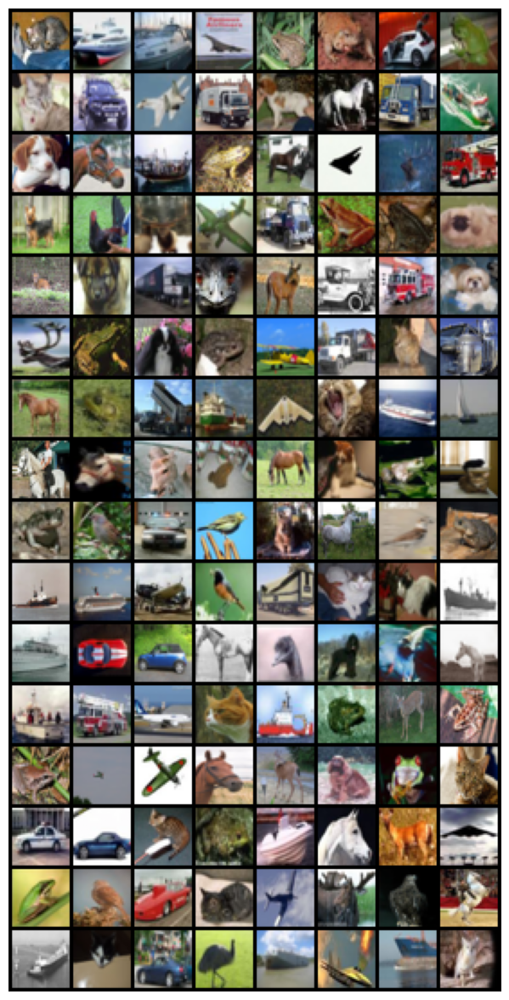

In [5]:
samples, _ = next(iter(loader_test))

samples = samples.cpu()
samples = make_grid(denorm(samples), nrow=8, padding=2, normalize=False,
                        value_range=None, scale_each=False, pad_value=0)
plt.figure(figsize = (15,15))
plt.axis('off')
show(samples)

#### Model Definition
Define hyperparameters and the model

In [26]:
# *CODE FOR PART 2.1 IN THIS CELL*

# Choose the number of epochs, the learning rate
# and the size of the Generator's input noise vetor.

num_epochs = 60
learning_rate_D = 0.0002
learning_rate_G = 0.002
latent_vector_size = 100

# Other hyperparams


In [7]:
# Spatial size of training images:
image_size_data = 32

# Number of channels in the training images:
n_channel = 3

# Size of feature maps in generator:
ngf = 32

# Size of feature maps in discriminator:
ndf = 32

In [76]:
#sigma=0.05 works well ;
class GaussianNoise(nn.Module):
    def __init__(self, sigma=0.05):
        super(GaussianNoise, self).__init__()
        self.sigma = sigma

    def forward(self, x):
        if self.training and self.sigma != 0:
            # Calculate the standard deviation of the noise for each pixel
            scale = self.sigma * x.detach()
            # Generate Gaussian noise
            noise = torch.randn_like(x) * scale
            # Add the noise to the input x
            x = x + noise
        return x
    

class SpectralNorm(nn.Module):
    def __init__(self, module):
        super(SpectralNorm, self).__init__()
        self.module = nn.utils.spectral_norm(module)
    def forward(self, x):
        return self.module(x)
    

class UniformNoise(nn.Module):
    def __init__(self, size):
        super(UniformNoise, self).__init__()
        self.weight = nn.Parameter(torch.zeros(size))
        self.weight.data.uniform_(-1, 1)

    def forward(self, x):
        return x + self.weight.expand_as(x)

In [23]:
# *CODE FOR PART 2.1 IN THIS CELL*
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        
        self.layers_gen = nn.Sequential(
            nn.utils.spectral_norm(nn.ConvTranspose2d(latent_vector_size, ngf * 16, 4, 1, 0, bias=False)),
            nn.BatchNorm2d(ngf * 16),
            nn.LeakyReLU(0.1, inplace=True),

            nn.utils.spectral_norm(nn.ConvTranspose2d( ngf * 16, ngf * 8, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(ngf * 8),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.utils.spectral_norm(nn.ConvTranspose2d( ngf * 8, ngf*4, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(ngf*4),
            nn.LeakyReLU(0.1, inplace=True),

            nn.utils.spectral_norm(nn.ConvTranspose2d( ngf*4, n_channel, 4, 2, 1, bias=False)),
            nn.Tanh()
        )
        

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################

    # You can modify the arguments of this function if needed
    def forward(self, z):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        out = self.layers_gen(z)

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################
        return out


class Discriminator(nn.Module):
    def __init__(self, sigma=0.05):
        super(Discriminator, self).__init__()
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        self.sigma = sigma

        self.layers_dis1 = nn.Sequential(
            nn.Conv2d(n_channel, ndf*4, 4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.15),
            
            nn.Conv2d(ndf*4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.15)
        )
        self.layers_dis2 = nn.Sequential(
            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.15),

            nn.Conv2d(ndf * 16, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

        
        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################

    # You can modify the arguments of this function if needed
    def forward(self, x):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        #Gaussian instance noise for the input
        if self.training:
            scale_1 = self.sigma * x.detach()
            # Generate Gaussian noise
            noise_1 = torch.randn_like(x) * scale_1
            # Add the noise to the input x
            x = x + noise_1

        out = self.layers_dis1(x)

        #Gaussian noise before the third convolutional layer
        if self.training:
            scale_2 = self.sigma * x.detach()
            # Generate Gaussian noise
            noise_2 = torch.randn_like(x) * scale_2
            # Add the noise to the input x
            x = x + noise_2

        out = self.layers_dis2(out)

        #out = self.layers_dis(x)

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################

        return out

In [9]:
#Try other architecture:

class Generator_ot(nn.Module):
    def __init__(self):
        super(Generator_ot, self).__init__()
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        self.layers_gen = nn.Sequential(
            nn.ConvTranspose2d(latent_vector_size, ngf * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.LeakyReLU(0.1, inplace=True),

            nn.ConvTranspose2d( ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.ConvTranspose2d( ngf * 8, ngf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*4),
            nn.LeakyReLU(0.1, inplace=True),

            nn.ConvTranspose2d( ngf*4, n_channel, 4, 2, 1, bias=False),
            nn.Tanh()
        )

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################

    # You can modify the arguments of this function if needed
    def forward(self, z):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        out = self.layers_gen(z)

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################
        return out


class Discriminator_ot(nn.Module):
    def __init__(self):
        super(Discriminator_ot, self).__init__()
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        self.layers_dis = nn.Sequential(
            nn.Conv2d(n_channel, ndf*4, 4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf*4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 16, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################

    # You can modify the arguments of this function if needed
    def forward(self, x):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        out = self.layers_dis(x)

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################

        return out


In [27]:
class Generator_VAE(nn.Module):
    def __init__(self):
        super(Generator_VAE, self).__init__()
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        
        self.gen_dec = nn.Sequential( 
            nn.ConvTranspose2d(latent_vector_size, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.ConvTranspose2d(32, n_channel, kernel_size=4, stride=2, padding=1),
            nn.Sigmoid(),
        )
        
        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################

    # You can modify the arguments of this function if needed
    def forward(self, z):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        
        out = self.gen_dec(z)

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################
        return out


class Discriminator_VAE(nn.Module):
    def __init__(self):
        super(Discriminator_VAE, self).__init__()
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        self.encoder = nn.Sequential(
            nn.Conv2d(n_channel, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 1, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )
        

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################

    # You can modify the arguments of this function if needed
    def forward(self, x):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################

        out = self.encoder(x)

        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################

        return out

In [34]:
from torchsummary import summary

<h2> Initialize Model and print number of parameters </h2>

You can use method `weights_init` to initialize the weights of the Generator and Discriminator networks. Otherwise, implement your own initialization, or do not use at all. You will not be penalized for not using initialization.

In [9]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

In [24]:
use_weights_init = True

model_G = Generator().to(device)
if use_weights_init:
    model_G.apply(weights_init)
params_G = sum(p.numel() for p in model_G.parameters() if p.requires_grad)
print("Total number of parameters in Generator is: {}".format(params_G))
print(model_G)
print('\n')

model_D = Discriminator().to(device)
if use_weights_init:
    model_D.apply(weights_init)
params_D = sum(p.numel() for p in model_D.parameters() if p.requires_grad)
print("Total number of parameters in Discriminator is: {}".format(params_D))
print(model_D)
print('\n')

print("Total number of parameters is: {}".format(params_G + params_D))

Total number of parameters in Generator is: 12658432
Generator(
  (layers_gen): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.1, inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.1, inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.1, inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11):

In [ ]:
#Test of VAE architecture as GAN architecture
#use_weights_init = True

#model_G = Generator_VAE().to(device)
#if use_weights_init:
#    model_G.apply(weights_init)
#params_G = sum(p.numel() for p in model_G.parameters() if p.requires_grad)
#print("Total number of parameters in Generator is: {}".format(params_G))
#print(model_G)
#print('\n')

#model_D = Discriminator_VAE().to(device)
#if use_weights_init:
#    model_D.apply(weights_init)
#params_D = sum(p.numel() for p in model_D.parameters() if p.requires_grad)
#print("Total number of parameters in Discriminator is: {}".format(params_D))
#print(model_D)
#print('\n')

#print("Total number of parameters is: {}".format(params_G + params_D))

### Part 2.1b: Training the Model (12 Points)

#### Defining a Loss

In [17]:
# You can modify the arguments of this function if needed
BCE = nn.BCELoss(reduction='mean')

def loss_function(out, xTrue):
    loss = BCE(out, xTrue)
    return loss

<h3>Choose and initialize optimizers</h3>

In [12]:
# setup optimizer
# You are free to add a scheduler or change the optimizer if you want. We chose one for you for simplicity.
beta1 = 0.5
optimizerD = torch.optim.Adam(model_D.parameters(), lr=learning_rate_D, betas=(beta1, 0.999))
optimizerG = torch.optim.Adam(model_G.parameters(), lr=learning_rate_G, betas=(beta1, 0.999))

#Exponential lr decay from pytorch
schedulerD = torch.optim.lr_scheduler.ExponentialLR(optimizerD, gamma=0.96)
schedulerG = torch.optim.lr_scheduler.ExponentialLR(optimizerG, gamma=0.96)

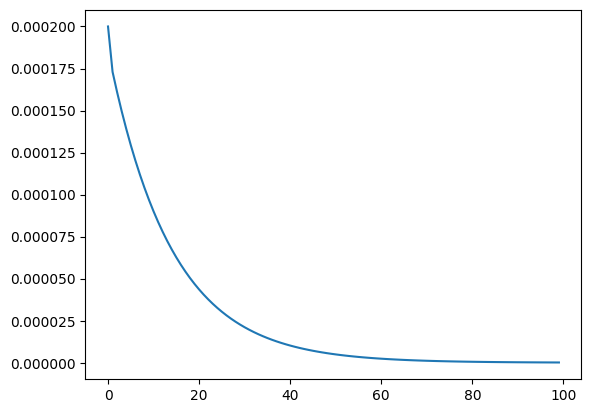

In [17]:
optimzer_test = torch.optim.AdamW(model_G.parameters(), lr=learning_rate, betas=(0.5, 0.999))
scheduler_test = torch.optim.lr_scheduler.ExponentialLR(optimzer_test, gamma=0.92)

lrs = []
for _ in range(100):
    optimzer_test.step()
    lrs.append(scheduler_test.get_lr())
    scheduler_test.step()

plt.plot(lrs)
plt.show()

<h3> Define fixed input vectors to monitor training and mode collapse. </h3>

In [13]:
fixed_noise = torch.randn(batch_size, latent_vector_size, 1, 1, device=device)

#set discriminator labels for real images from 1 -> 0.9
label_smooth_real = 0.9

#### Training Loop

Complete the training loop below. We've defined some variables to keep track of things during training:
* errD: Loss of Discriminator after being trained on real and fake instances
* errG: Loss of Generator
* D_x: Output of Discriminator for real images
* D_G_z1: Output of Discriminator for fake images (When Generator is not being trained)
* D_G_z2: Output of Discriminator for fake images (When Generator is being trained)

In [14]:
#Parameter for the training

#Add noise and modified loss function => label flipping
label_flipping = False
label_flipping_rate = 0.1

In [80]:
train_losses_G = []
train_losses_D = []
train_losses_tot = []

D_acc_real_list = []
D_acc_fake_list = []

# <- You may wish to add logging info here
for epoch in range(num_epochs):
    # <- You may wish to add logging info here
    train_loss_D = 0
    train_loss_G = 0
    train_loss_tot = 0

    D_acc_real = 0
    D_acc_fake = 0
    
    with tqdm.tqdm(loader_train, unit="batch") as tepoch:
        for i, data in enumerate(tepoch):

            #######################################################################
            #                       ** START OF YOUR CODE **
            #######################################################################
            
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            model_D.zero_grad()
            real_cpu = data[0].to(device)

            # Train with real
            #Real label definition as a tensor of 1
            #real_labels = torch.full((real_cpu.shape[0],), 1, dtype=torch.float, device=device) # real label is 1
            real_labels = torch.full((real_cpu.shape[0],), label_smooth_real, dtype=torch.float, device=device) # real label smoothing

            if label_flipping:
                nb_label_flip = int(real_cpu.shape[0] * label_flipping_rate)
                # Flip labels for real images randomly
                idx = torch.randperm(real_cpu.shape[0])[:nb_label_flip]
                real_labels[idx] = 0
                

            D_output = model_D(real_cpu).view(-1)
            errD_real = loss_function(D_output, real_labels)
            errD_real.backward()
            D_x = D_output.mean().item()

            # Computation of the accuracy of the discriminator on real images
            D_acc_real += D_x


            # Train with fake
            #Noise definition
            noise_add = torch.randn(real_cpu.shape[0], latent_vector_size, 1, 1, device=device)
            #Fake label definition as a tensor of 0
            fake_labels = torch.full((real_cpu.shape[0],), 0, dtype=torch.float, device=device) #fake label is 0 ; dtype=torch.float,

            fake_output = model_G(noise_add)

            D_fake_output = model_D(fake_output.detach()).view(-1) #use D on the fake output

            errD_fake = loss_function(D_fake_output, fake_labels)
            errD_fake.backward()
            D_G_z1 = D_fake_output.mean().item()

            errD = errD_real + errD_fake
            train_loss_D += errD.item() #update loss for D for a given batch


            optimizerD.step()


            # (2) Update G network: maximize log(D(G(z)))
            model_G.zero_grad()


            output_from_D = model_D(fake_output).view(-1) #see how well the fake output does with D
            errG = loss_function(output_from_D, real_labels)
            errG.backward()
            D_G_z2 = output_from_D.mean().item()

            # Computation of the accuracy of the discriminator on fake images
            D_acc_fake += 1 - D_G_z2

            train_loss_G += errG.item() #update loss for G for a given batch

            train_loss_tot += errD.item() + errG.item() #update total loss for a given batch

            optimizerG.step()

            
            #######################################################################
            #                       ** END OF YOUR CODE **
            #######################################################################
            # Logging
            if i % 50 == 0:
                tepoch.set_description(f"Epoch {epoch}")
                tepoch.set_postfix(D_G_z=f"{D_G_z1:.3f}/{D_G_z2:.3f}", D_x=D_x,
                                  Loss_D=errD.item(), Loss_G=errG.item())

    if epoch == 0:
        save_image(denorm(real_cpu.cpu()).float(), content_path/'CW_GAN/real_samples.png')
    with torch.no_grad():
        fake = model_G(fixed_noise)
        save_image(denorm(fake.cpu()).float(), str(content_path/'CW_GAN/fake_samples_epoch_%03d.png') % epoch)

    schedulerD.step()
    schedulerG.step()
    
    train_losses_D.append(train_loss_D / len(loader_train))
    train_losses_G.append(train_loss_G / len(loader_train))
    train_losses_tot.append(train_loss_tot / len(loader_train))

    D_acc_real_list.append(D_acc_real / len(loader_train))
    D_acc_fake_list.append(D_acc_fake / len(loader_train))

# save  models
# if your discriminator/generator are conditional you'll want to change the inputs here
torch.jit.save(torch.jit.trace(model_G, (fixed_noise)), content_path/'CW_GAN/GAN_G_model.pth')
torch.jit.save(torch.jit.trace(model_D, (fake)), content_path/'CW_GAN/GAN_D_model.pth')


Epoch 59: 100%|██████████| 391/391 [00:17<00:00, 22.51batch/s, D_G_z=0.399/0.411, D_x=0.486, Loss_D=1.28, Loss_G=0.903]
/usr/local/lib/python3.9/dist-packages/torch/jit/_trace.py:992: TracerWarning: Output nr 1. of the traced function does not match the corresponding output of the Python function. Detailed error:
Tensor-likes are not close!

Mismatched elements: 15196 / 393216 (3.9%)
Greatest absolute difference: 0.00020435452461242676 at index (120, 2, 14, 29) (up to 1e-05 allowed)
Greatest relative difference: 5.296239991892166 at index (58, 2, 12, 27) (up to 1e-05 allowed)
  _check_trace(
/usr/local/lib/python3.9/dist-packages/torch/jit/_trace.py:992: TracerWarning: Trace had nondeterministic nodes. Did you forget call .eval() on your model? Nodes:
	%71 : Float(128, 3, 32, 32, strides=[3072, 1024, 32, 1], requires_grad=0, device=cuda:0) = aten::randn_like(%x, %66, %67, %68, %69, %70) # /tmp/ipykernel_32/2388982122.py:171:0
This may cause errors in trace checking. To disable trace ch

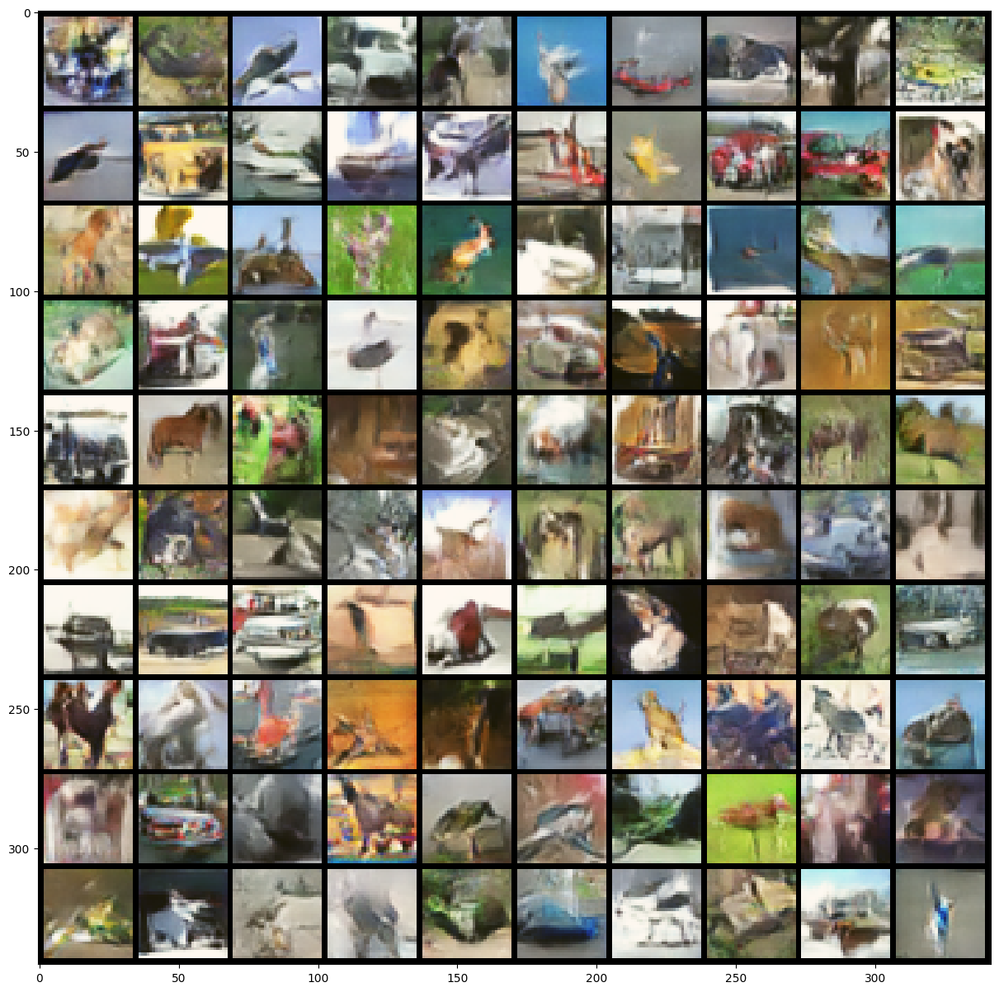

In [85]:
#Import model_G and model_D
model_G_test = torch.jit.load(content_path/'CW_GAN/GAN_G_model.pth')
model_D_test = torch.jit.load(content_path/'CW_GAN/GAN_D_model.pth')
# From the import model, we can generate new images
input_noise = torch.randn(100, 100, 1, 1, device=device)
gan_input = [input_noise]


model_G_test.eval()
with torch.no_grad():
    fake_test = model_G_test(*gan_input).cpu()

    #fake_test = model_G_test(fixed_noise)
    fake_test = make_grid(denorm(fake_test)[:100], nrow=10, padding=2, normalize=True,
                        value_range=None, scale_each=False, pad_value=0)
    plt.figure(figsize=(15,15))
    show(fake_test)

## Part 2.1c: Results (10 Points)
This part is fairly open-ended, but not worth too much so do not go crazy. The table below shows examples of what are considered good samples. Level 3 and above will get you 10/10 points, level 2 will roughly get you 5/10 points and level 1 and below will get you 0/10 points.

<table><tr>
<td>
  <p align="center">
    <img alt="Routing" src="https://drive.google.com/uc?id=18aWqRAnAVTRDY52y1yHSCdqSxUFRKOS9" width="%30">
    <br>
    <em style="color: grey">Level 1</em>
  </p>
</td>
<td>
  <p align="center">
    <img alt="Routing" src="https://drive.google.com/uc?id=1ymO2-jGAvWeUR2kaj_LxQcGYF1RWNRnw" width="%30">
    <br>
    <em style="color: grey">Level 2</em>
  </p>
</td>
<td>
  <p align="center">
    <img alt="Routing" src="https://drive.google.com/uc?id=13SW62ekW32NMYtfcdm_dCJJ3ZMOZEZAJ" width="%30">
    <br>
    <em style="color: grey">Level 3</em>
  </p>
</td>
</tr></table>

### Generator samples

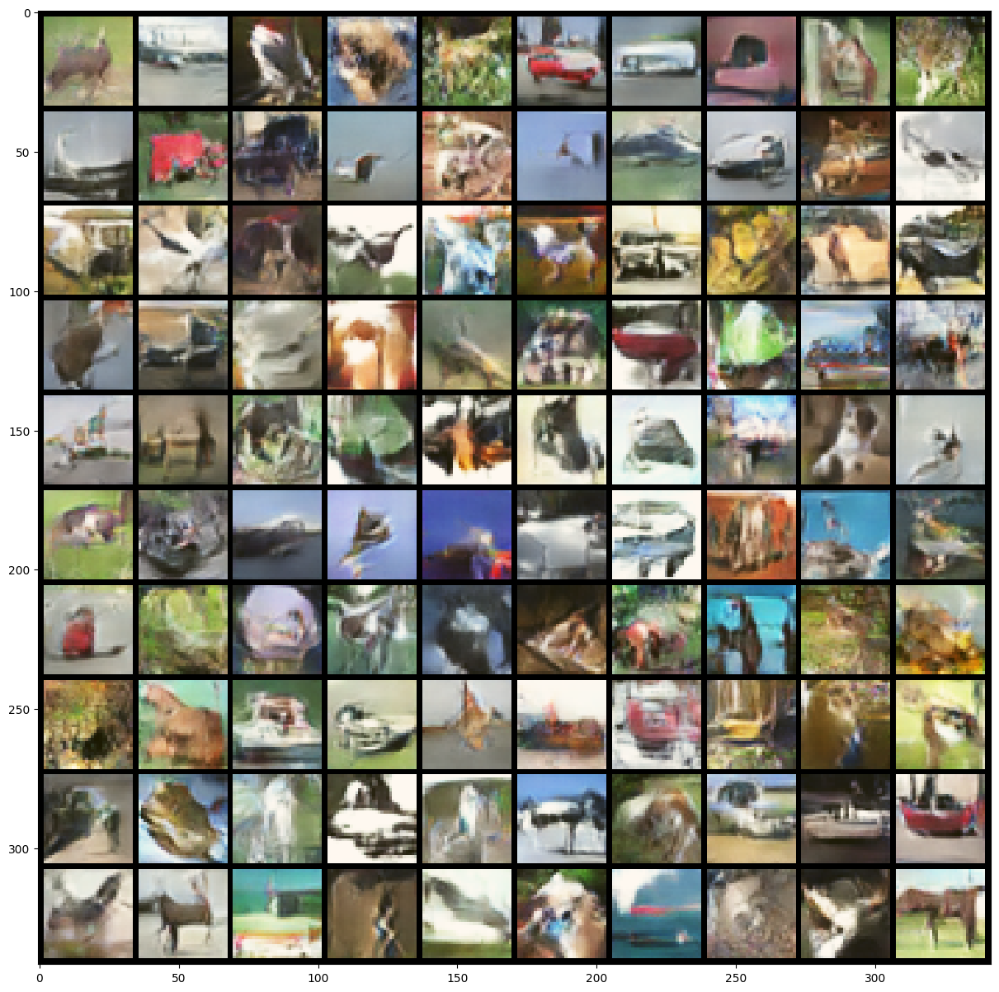

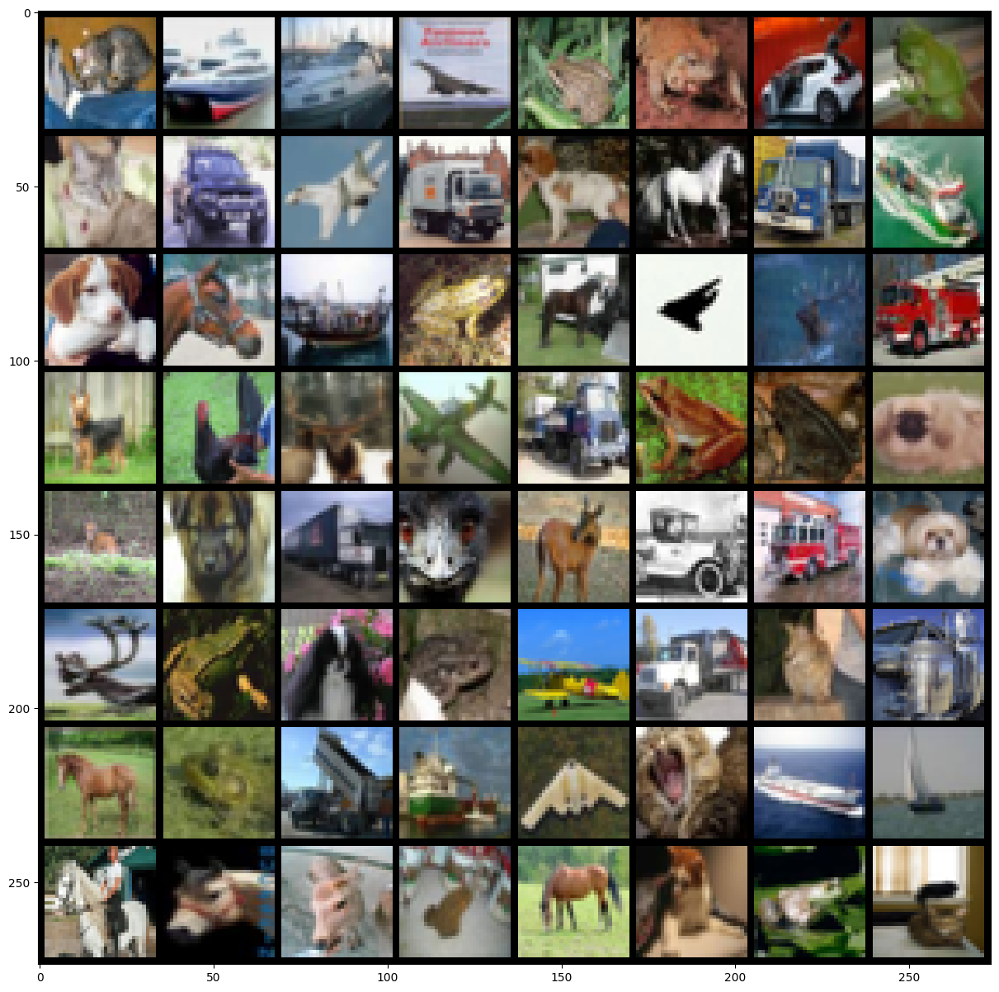

In [81]:
input_noise = torch.randn(100, latent_vector_size, 1, 1, device=device)
with torch.no_grad():
    # visualize the generated images
    generated = model_G(input_noise).cpu()
    generated = make_grid(denorm(generated)[:100], nrow=10, padding=2, normalize=True,
                        value_range=None, scale_each=False, pad_value=0)
    plt.figure(figsize=(15,15))
    save_image(generated, content_path/'CW_GAN/Teaching_final.png')
    show(generated) # note these are now class conditional images columns rep classes 1-10

it = iter(loader_test)
sample_inputs, _ = next(it)
fixed_input = sample_inputs[0:64, :, :, :]
# visualize the original images of the last batch of the test set for comparison
img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure(figsize=(15,15))
show(img)

## Part 2.1d: Engineering Choices (10 Points)

Discuss the process you took to arrive at your final architecture. This should include:

* Which empirically useful methods did you utilize
* What didn't work, what worked and what mattered most
* Are there any tricks you came across in the literature etc. which you suspect would be helpful here

**Your Answer**


To establish our final architecture, we initially implemented our Variational Autoencoder (VAE) using a Deep Convolutional Generative Adversarial Network (DCGAN) approach. We then adapted the architecture based on the paper "Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks." Adjustments were made to tailor the architecture to our dataset, including the addition of layers, regularization, and fine-tuning.

In determining supplementary layers, regularization, and hyperparameter fine-tuning, we employed a knowledge-oriented random search. Based on insights from deep learning courses, literature, and intuition, we selected initial design choices for parameters (e.g., layers, hyperparameters). Through an empirical approach, we tried to determine an optimal way to parameterize these design choices (or decide to remove them).This method was applied across all our architecture and hyperparameter decisions.


<br>

#### VAE architecture as DCGAN

**Adaptation of the architecture:**
We firstly adapted our VAE's architecture as a DCGAN architecture. Therefore we implemented the generator with the decoder, and the discriminator with the encoder. 
It is important to note that our architecture required adjustments, such as changes in kernel size and stride/padding parameters, to be compatible with the CIFAR-10 dataset.

**Result with VAE as DCGAN:**
The model quickly experienced mode collapse, with the loss of the discriminator and generator becoming constant after only a few epochs. The generated images were identical and blurred, indicating the GAN's inability to converge.


<br>

#### Architecture from the provided paper: Radford, Metz (2016)

1. **Base architecture**

With the paper provided (Radford, Metz (2016)) and the PyTorch tutorial: DCGAN_faces_tutorial, we implemented our foundational architecture. We adapted the architecture from the paper to suit our specific task, notably excluding any kernels of size 1024.

In this architecture, the Generator has 4 convolutional-transpose layers, each followed by a BatchNorm and a ReLu activation function. The last layer for the Generator is "Tanh", and it is quite popular choice among the litterature. The Discriminator has 4 convolution layers, each followed by a BatchNorm and a Leaky ReLu activation function. Each convolution layer has a stride of 2. The last layer of the Discriminator is "Sigmoid" and represents also a popular choice, especially due to fact that we obtain an output between 0 and 1.

With this architecture, that already incorporate good practice of upsampling, regularisation (BatchNorm), avoid sparse gradient with LeakyReLu (with negative slope), and a reasonable number of parameters (approximately 6 millions).

This architecture, incorporates good practices of upsampling and downsampling, and avoids sparse gradients. Therefore it was a great starting point. Even though the quality of image was not very satisfying and the learning process was relatively unstable, we already obtained sensible result.

In the following description we tried to enhance the training process as well as the quality of generated images.


2. **Improved architecture**

**Generator design choice:**
- *Spectral Normalization*: The key change made to the Generator involves integrating spectral normalization into each of its transposed convolutional layers, using PyTorch function. Spectral normalization is a technique used to stabilize the training of discriminative models (Spectral Normalization, Miyato et al 2018). Moreover by applying spectral normalization, the generator is less likely to produce outputs that the discriminator can easily classify as fake, thus improving the overall quality of generated images. Empirically, it was observed that applying Spectral Normalization only in the Generator improves both training efficiency and image quality.

- *Leaky ReLu*: To address the issue of sparse gradients, which affects the stability of GANs, the original ReLU activation function in the Generator was replaced with LeakyReLU. A moderate slope of 0.1 was empirically chosen, yielding promising results.

Testing the addition of Gaussian noise and Dropout, as implemented in the discriminator, showed that these types of regularization prevented the generator from maintaining its image generation capabilities as training progressed.


**Discriminator design choice:**
- *Gaussian Noise*: Gaussian noise was introduced at the input of the Discriminator and before the third convolutional layer. Known as instance noise (as per OpenAI's DCGAN Advanced techniques), this regularization method assists the discriminator in generalizing better from the training data. Injecting noise not only makes the discriminator more resilient to slight input variations but also stabilizes training by increasing the challenge for the discriminator, thus preventing it from dominating the generator prematurely. Injecting Gaussian noise at the input layer, following OpenAI's suggestion, introduces variability from the beginning.
Empirically, we decided to introduce noise just before the third convolutional layer. This adds variability deeper within the network, leading to improved overall performance.

- *Dropout*: Dropout layers were integrated after activation layers, except for the last one. Incorporating dropout enhances the discriminator's robustness by preventing it from becoming overly confident in its predictions, thus promoting a more balanced training dynamic between the generator and discriminator.

We also tried to apply Spectral Normalization in the discriminator, as it seemed a promising method to reinforce stability and improve the training process. However, in our experiments, it did not yield satisfactory results.


**Architecture Conclusion**: The initial model presented a promising foundation. Especially, the use of Batch Normalization was retained from the original architecture due to its significant role in stabilizing learning. Various strategies were explored to enhance performance, training efficiency, and the robustness of our final model. Notably, the latest model demonstrated robustness to changes in hyperparameters, a property likely attributed to the implementation of Spectral Normalization and Gaussian Noise. Experiments with hyperparameter changes consistently yielded comparable outcomes (with slight variances in performance, loss, and accuracy curves). It should be noted that here we are referring to only small changes in the hyperparameters. In conclusion, one advantage of this model configuration is its potential to prevent mode collapse.



3. **Hyperparameters choices**

- *Optimiser*: We initially used AdamW as recommended by the DCGAN-Rectangular-GANHacks2 GitHub repository. However, empirical evidence suggested that Adam performed better overall. Consequently, we decided to use the Adam optimizer, following the suggestion of Radford et al., 2015.

- *Learning rate*: We set a higher initial learning rate for the generator (lr=0.002) compared to the discriminator (lr=0.0002), observing that the generator faced a more challenging task than the discriminator. A higher learning rate for the generator enables it to make larger parameter updates, helping it to quickly and effectively catch up with the discriminator's performance. This strategy helps to prevent the discriminator from overpowering the generator too early in the training process, which could lead to a significant increase in the generator's loss and stagnation in performance (or collapse mode). Empirically, we found that a higher learning rate for the generator helped balance the learning dynamics between the two networks.

- *Decaying Learning rate*: We applied an exponential decay to the learning rate using PyTorch, setting the gamma parameter to 0.96. Given the instability of DCGAN training, we adopted the decaying learning rate strategy from previous Reinforcement Learning works. Initially, larger learning rates allow for more aggressive learning and greater updates to the model's parameters. As training progresses and the models begin to converge, reducing the learning rate helps avoid potential overshooting of optimal or interesting sub-optimal solutions. Empirically, this adjustment significantly enhanced stability towards the end of training.

- *One sided label smoothing*: To make the task more challenging for the discriminator, we implemented one-sided label smoothing, inspired by the DCGAN-Rectangular-GANHacks2 GitHub repository, adjusting the true label value from 1 to 0.9. By using smoothed labels, the discriminator's confidence is tempered. This results in more informative gradients being backpropagated to the generator, facilitating its learning process and contributing to the overall stability of the training.

- *Data augmentation*: We applied a simple data transformation of horizontal flipping, chosen after reviewing several examples. However, we could not conclusively determine whether this design choice improved our overall model, as the results regarding data augmentation were not clear.

- *Batch size*: Although smaller batch sizes (such as 64 and 32) were suggested by some resources to lead to better GAN training, we did not achieve notable results with smaller batch sizes. Thus, we continued with batch size of 128.

- *Number of epoch*: Selecting the appropriate number of epochs was challenging, as it needed to align with system behavior. In the end, we obtained an interesting system with a well-balanced training, which significantly reduced the risk the discriminator overpowering. This allowed us to extend training to 60 epochs and beyond. Empirically, we found that more epochs, in scenarios where the discriminator and generator evolve in a balanced manner, lead to improved image quality.

- *Latent Space size*: We began our experiments with a latent space size of 100, as suggested in the literature. Attempting to reduce this parameter resulted in a simpler and more stable model. However, too much reduction could lead to mode collapse due to the loss of information. Conversely, increasing it significantly raised computational expenses. In this case, the model was able to capture more complex relationships but the results were not clearly enhanced.


The changes with the most significant impact on GAN convergence were Spectral Normalization, Gaussian Noise, dropout, and decaying learning rate. It should also be noted that Batch normalization, already implemented in the base architecture, was a critical component.

<br>

#### List of the tricks:
- Learning Rate with different starting points.
- Exponential decaying of learning rate.
- Upsampling and downsampling with transpose convolutions and stride [original architecture used].
- Batch normalization [original architecture used].
- Adam Optimizer [original architecture used].
- Spectral Normalization [Miyato et al., 2018] in the generator.
- Data augmentation (with uncertainty about its benefits).
- Dropout in the discriminator.
- Gaussian Noise in the discriminator.
- One-sided label smoothing (on true labels).
- LeakyReLU in both the generator and discriminator.


**Potential way of improvement:**
- *Label reversal*: We began exploring the idea of reversing 10% of the true labels (from 0.9 to 0) to make the task harder for the discriminator. This approach appears promising.

- *Adjust dropout*: Fine-tuning the dropout rate could optimize the "task context", leading to a well-balanced learning relationship between the discriminator and generator.

- *Number of epoch*: Depending on system behaviour, increasing the number of epochs could achieve better resolution.

- *Data augmentation*: From the previous coursework, we also applied a data augmentation technique on the actual data, without artificially increase the number of samples. In that way we avoid any artificial increase in the performance. However, exploring more complex data augmentation could enhance diversity and challenge the discriminator further.

- *Optimiser*: Literature suggests using different optimizers for the generator and discriminator, such as SGD for the discriminator and Adam for the generator. This strategy could manage the duality in the learning process more effectively.

- *Minibatch discrimination*: As suggested by Salimans et al. (2016), Improved Techniques for Training GANs.

- *Architecture*: While maintaining a reasonable number of parameters (approximately 6 million), exploring the addition of more capacity could potentially produce higher quality and finer images.

- *Model*: Comparing our DCGAN with a Wasserstein Generative Adversarial Network (WGAN) could provide insights into differences in behavior, learning processes, and outcomes.


Plot are available in the zip in the folder: "part_2_1d". Also:
https://drive.google.com/drive/folders/1M2XKT1HNT1Z_UtNztCO3gyaTLD13O1aS?usp=sharing

## Part 2.2: Understanding GAN Training (5 points)


### Loss Curves
**Your task:**


Plot the losses curves for the discriminator $D$ and the generator $G$ as the training progresses and explain whether the produced curves are theoretically sensible and why this is (or not) the case (x-axis: epochs, y-axis: loss).

Make sure that the version of the notebook you deliver includes these results.

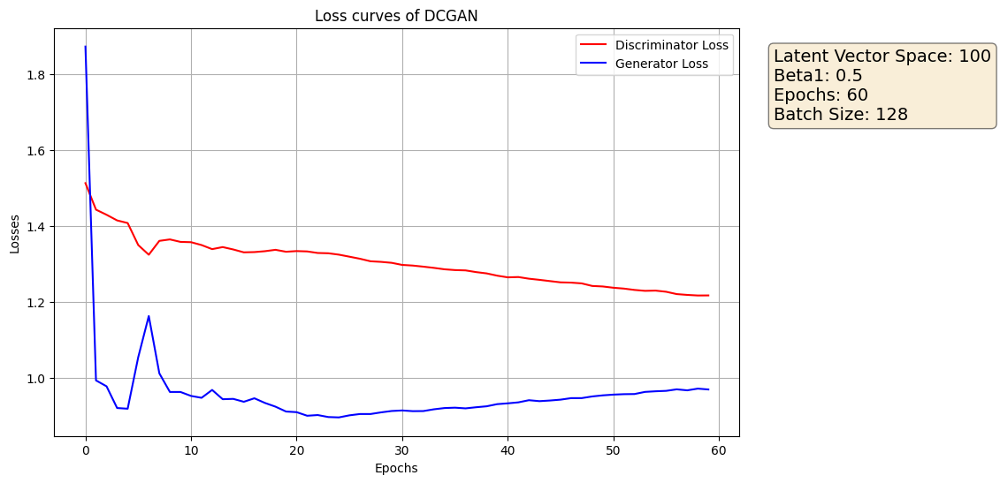

In [82]:
# ANSWER FOR PART 2.2 IN THIS CELL*
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(train_losses_D,label='Discriminator Loss', c='red')
ax.plot(train_losses_G,label='Generator Loss', c='blue')
#ax.plot(train_loss_tot,label='Total Loss', c='black', linestyle='--')
ax.set_title('Loss curves of DCGAN')
ax.set_xlabel('Epochs')
ax.set_ylabel('Losses')

#Add a box containing the hyperparameters
textstr = f'Latent Vector Space: {latent_vector_size}\nBeta1: {beta1}\nEpochs: {num_epochs}\nBatch Size: {batch_size}'
props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
ax.text(1.05, 0.95, textstr, transform=ax.transAxes, fontsize=14,
        verticalalignment='top', bbox=props)


ax.legend(loc='upper right')
ax.grid(True)
plt.show()

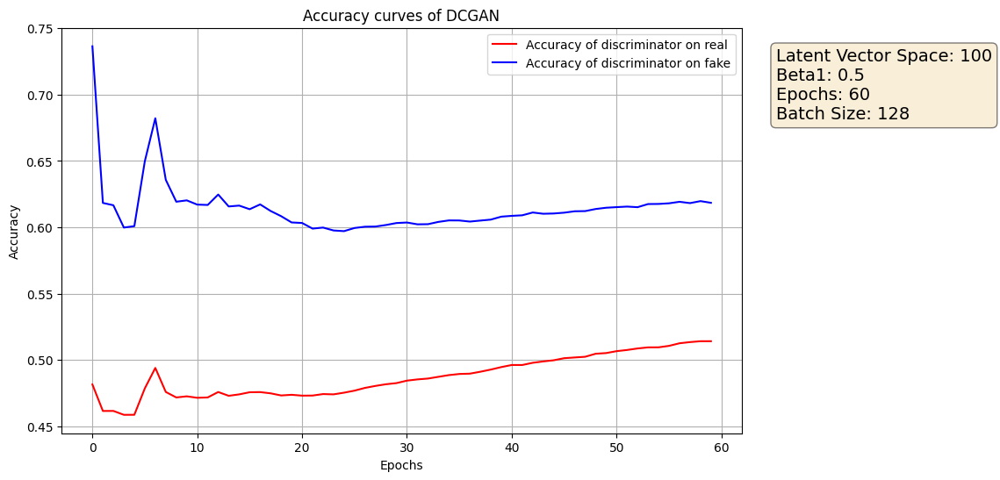

In [83]:
#Plot the accuracy of the discriminator on real and fake images
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(D_acc_real_list,label='Accuracy of discriminator on real', c='red')
ax.plot(D_acc_fake_list,label='Accuracy of discriminator on fake', c='blue')
ax.set_title('Accuracy curves of DCGAN')
ax.set_xlabel('Epochs')
ax.set_ylabel('Accuracy')

#Add a box containing the hyperparameters
textstr = f'Latent Vector Space: {latent_vector_size}\nBeta1: {beta1}\nEpochs: {num_epochs}\nBatch Size: {batch_size}'
props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
ax.text(1.05, 0.95, textstr, transform=ax.transAxes, fontsize=14,
        verticalalignment='top', bbox=props)


ax.legend(loc='upper right')
ax.grid(True)
plt.show()

### Discussion

Do your loss curves look sensible? What would you expect to see and why?

**YOUR ANSWER**


Here, the generator and the discriminator engage in a dynamic duel, as the generator tries to trick the discriminator, while the discriminator tries to accurately identify true and fake images, thus assessing the generation's quality.



#### Theoretical considerations of Loss Curves

From the literature and web resources, the DCGAN is known for its volatile learning process. Theoretically, one would expect to observe significant, noisy, and spiky loss curves that follow a general trend.

Moreover, it is expected that the discriminator's loss would decrease sharply at the beginning of training as it quickly learns to differentiate between the initially poorly generated images. Similarly, the generator's loss is expected to be substantial initially, as it has not yet mastered the complex task of accurately generating images.

As training advances, the generator improves, making the discriminator's task increasingly challenging. Consequently, the loss curve should exhibit a tendency towards stable behavior. This implies an expectation of very slow progress or even a plateau in the loss curves. Ideally, the discriminator's loss should stabilize at a level not too close to zero, indicating that neither the discriminator nor the generator is dominating the training process. Additionally, a slight decrease in the generator's loss would be desirable in some part of the training, signaling effective competition against the discriminator. Theoretically, the generator's loss should also stabilize, showing almost kind a plateau.

<br>

#### Pratical considerations of Loss Curves

In terms of the curves' sensitivity, Spectral and Batch normalization appear to significantly smooth the training process, though the beginning of training seems more sensitive. This is understandable, given that learning rates are relatively high initially, and updates are potentially important. For instance, a peak can be observed around 5 epochs.

Contrary to expectations, the discriminator's loss is higher than the generator's at the start of training. This early phase of learning is highly "model-dependent". We empirically, experimented different architectures showing a wide variety of learning beginnings.


**Discriminator Loss**:
It is observed that the discriminator's loss decreases initially, indicating an improvement in distinguishing between real and fake images. This is logical, especially at the start of training, given that the discriminator's task is in pratice easier. As training progresses, the discriminator's loss plateaus, particularly from epoch 12 to 21, suggesting that the discriminator faces challenges as the generator's quality of fake images improves.


**Generator Loss**:
After a sharp drop in the loss, the generator's loss becomes quite unstable. This phenomenon is exacerbated when the learning rate of the generator exceeds that of the discriminator. When the learning curve begins to stabilize, we observe, between epochs 10 and 25, a decrease in the generator's loss, indicating that the generator is effectively deceiving the discriminator. This suggests that the generator is improving at producing images the discriminator is more likely to classify as real. This decreasing trend is a positive indication that the generator is learning and evolving. Subsequently, the loss begins to rise. Up to epoch 25, the process seems to be proceeding correctly with a dynamic that improves both the generator and the discriminator. However, beyond this period, we start to witness the phenomenon of the discriminator's overpowering influence. In our final model, this phenomenon is relatively soft but still present.

There is no clear sign of divergence within the process, which is positive. Nonetheless, extending the number of epochs significantly might reveal such phenomena. Additionally, the spike at the beginning is concerning and could be another challenge to solve for further improvement.


**Potential path of improvement**:
- One primary concern to investigate is the beginning of the learning process. For instance, the sharp decrease in the generator's loss, coupled with another spike around epoch 6, warrants further investigation to achieve quicker calibration of the loss.

- Another aspect to monitor is the potential for divergence due to the discriminator's overpowering. Enhancing the generator's capacity, such as by adding a convolutional transpose layer or implementing label reversal to increase difficulty, could mitigate this. Additionally, finer tuning of the dropout layer could prove beneficial.

<br>

#### Accuracy Curves

- Accuracy curves provide an alternative point of view of the training process, particularly offering insights about the discriminator. These plots are useful, as we empirically observed that the discriminator often had an easier task, leading to a dominance over the generator.

- The objective is to achieve convergence in the accuracy of the discriminator on both real and fake images. Ideally, the generator should improve to the point where the discriminator cannot differentiate between real and fake images, leading both accuracy curves (on fake and real images) towards 0.5 as the number of epochs increases.

- The moderate slope of improvement suggests that the generator is also improving over time, indicative of a correct learning process.

- If the accuracy on real data were significantly high and the accuracy on fake data very low, it might suggest that the discriminator is overfitting to real data and failing to generalize effectively to new, fake images. Here, the curves do not suggest overfitting, as the accuracies do not diverge to 100% and 0%.

- The gentle increase in accuracy for detecting fake data also correlates with the rising generator loss, implying that the discriminator is becoming better at distinguishing fake images in the latter part of the training.

Plot are available in the zip in the folder: "part_2_2". Also:
https://drive.google.com/drive/folders/1uUbX-n77tQAocTaMlZLMs1JH1gyilrSb?usp=sharing

## Part 2.3: Understanding Mode Collapse (5 points)
**Your task:**

Describe the what causes the phenomenon of Mode Collapse and how it may manifest in the samples from a GAN.

Based on the images created by your generator using the `fixed_noise` vector during training, did you notice any mode collapse? what this behaviour may be attributed to, and what did you try to eliminate / reduce it?

In [ ]:
# Any additional code

### Discussion


**YOUR ANSWER**

<br>

#### Observation of mode Collapse

**Manifestation in samples**:

The existence of mode collapse is identified through the observation of generated samples. This becomes evident when we see a collection of very similar and non sense images, indicating a significant clue of mode collapse. In such cases, the generator produces a very limited variety of images, focusing on only a few specific modes (subsets) of the data distribution. Consequently, the main indicators of mode collapse in samples are the lack of diversity and the overrepresentation of certain modes.

Moreover, diverging or stagnant learning curves, as well as increased accuracy of the discriminator or a constant accuracy of 50%, are also significant indicators of mode collapse.


**Practical Observation**:

Mode collapse was mainly observed when we utilized our VAE model as a DCGAN. It was also noted upon introducing regularization in the generator but not in the discriminator. In fact, given the discriminator's easier task, this imbalance configuration led to a highly unstable training process dominated by the discriminator, resulting in mode collapse as the generator failed to improve further.


<br>

#### Causes and identification of mode collapse

**Potential causes of Collapse issue**:


- Mode collapse may occur when the generator exploits a weakness in the discriminator, producing repetitive "image glitches" that deceive the discriminator. This issue arises when the generator fails to capture the data distribution, focusing instead on a narrow or even a single mode. Concurrently, the discriminator might get stuck in a local minimum, leading to a cycle of no improvement on either side. This is characterized by the generation of very similar and non-diverse outputs. This phenomenon can be related to the generator's lack of exploration.

- Vanishing gradients represent another critical cause of mode collapse, posing a significant challenge during our experimentations. With various architectural variants, we encountered the issue of vanishing gradients for the generator. If the generator receives insufficient feedback for updates, the discriminator becomes overly effective, leading to vanishing gradients for the generator. To address this, we implemented regularization methods, such as Gaussian noise and dropout, along with normalization techniques like Spectral normalization, to enhance stability.

- A parallel can be drawn with the collapse phenomenon observed with the MNIST dataset in Part 1, where imbalance in the VAE's loss, due to inappropriate beta values, leads to mode collapse. Too low a beta value compromises reconstruction quality, while too high a value allows the KL divergence term to dominate the learning process, resulting in collapse.



**Identification of mode collapse**:
-*Loss Curves*: While loss curves alone may not provide clear conclusions, we can still observe potential problems, such as overempowering (generator or discriminator). Especially if we notice diverging behaviour or a non-evolving system, then it can be a clue of collapse mode.

-*Accuracy Curves*: Drawing from literature, we monitored the discriminator’s accuracy curves, which track the discriminator's ability to detect real and fake images. A significant decrease in accuracy on fake data may indicate mode collapse, as it suggests the generator is producing a limited variety of outputs that the discriminator learns to identify easily.

-*Image inspection*: Inspecting the images produced throughout the learning process, especially tracking the diversity of images, provides insights into the learning dynamics. If the diversity does not improve, it likely indicates the onset of mode collapse.

<br>

#### Methods to Eliminate/Reduce Mode Collapse

*Methods used*: <br>
Below, we detail the strategies implemented during our research to address mode collapse. Faced with convergence issues (diverging loss) and the overpowering of the discriminator in our base architecture (refer to Section 2.1d), we adapted our design choices to achieve a balance.

**Spectral Regularization**: Implementing spectral regularization to monitor and stabilize the spectral distribution effectively prevents mode collapse by maintaining diversity in generated samples (Liu et al., 2019). We empirically observed that this regularization aids in preventing collapse and enhances model convergence.

**Gaussian Noise Instance**: Introducing Gaussian noise to the discriminator proved to be an effective strategy. The discriminator quickly became too dominant after 25 epochs, complicating the learning process. Injecting noise not only diminished the discriminator's overpowering capacity but also bolstered its robustness, thereby improving learning outcomes. This impact was evident in the learning curves, and the training then have been extended, leading to more high quality images.

**Learning rate Decaying**: Occasionally, mode collapse emerges later in the training. Implementing a decaying learning rate mitigated this risk, enhancing the robustness of the learning process. 

**Dropout Layer**: Integrating dropout layers allowed precise monitoring of the discriminator’s strength and introduced variability in the connections. However, we empirically discovered that excessive dropout within the discriminator can lead to instability and a scenario where the generator dominates the learning process. Thus, the application of dropout needs to be carefully considered.


<br>

*Methods with further potential and improvement*: <br>
We detail additional solution that can be interesting for developing a model more resilient to the phenomenon of mode collapse.

**Distribution Fitting**: Introducing a penalty term that constrains the generated data distribution can help ensure that the generator captures a distribution more similar to the real one (Gong et al., 2023).

**Mini-batch Discrimination**: This approach enables the discriminator to distinguish between batches of real and fake data, rather than individual samples. This encourages the generator to create a more diverse array of outputs.

**Regularization and Penalty Methods**: Approaches like gradient penalty (e.g., WGAN-GP) can also help in stabilizing the training and promoting diversity in generator outputs.


By applying these methods, we can diminish the effects of mode collapse and enhance the diversity of the generated samples, leading to a generative model that is both more effective and robust.

Plot are available in the zip in the folder: "part_2_3". Also:
https://drive.google.com/drive/folders/1HmO4H1A9HHVqiW6wFCGg-9H8kMlvutbe?usp=sharing



# TA Test Cell
TAs will run this cell to ensure that your results are reproducible, and that your models have been defined suitably.

<font color="orange"> <b> Please provide the input and output transformations required to make your VAE and GANs work. If your GAN generator requires more than just noise as input, also specify this below (there are two marked cells for you to inspect) </b></font>


In [ ]:
# If you want to run these tests yourself, change directory:
# %cd '.../dl_cw2/'
ta_data_path = "../data" # You can change this to = data_path when testing

In [86]:
!pip install -q torch torchvision

In [87]:
# Do not remove anything here
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
import torch.nn.functional as F
import matplotlib.pyplot as plt

show = lambda img: plt.imshow(np.transpose(img.cpu().numpy(), (1,2,0)))

device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")

# Do not change this cell!
torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

In [94]:
############# CHANGE THESE (COPY AND PASTE FROM YOUR OWN CODE) #############
vae_transform = transforms.Compose([
    transforms.ToTensor(),
])

def vae_denorm(x):
    return x



mean = torch.Tensor([0.4914, 0.4822, 0.4465])
std = torch.Tensor([0.247, 0.243, 0.261])
unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())

def gan_denorm(x, channels=None, w=None ,h=None, resize = False):

    x = unnormalize(x)
    if resize:
        if channels is None or w is None or h is None:
            print('Number of channels, width and height must be provided for resize.')
        x = x.view(x.size(0), channels, w, h)
    return x

gan_latent_size = 100

# If your generator requires something other than noise as input, please specify
# two cells down from here

In [95]:
# Load VAE Dataset
#test_dat = datasets.MNIST(ta_data_path, train=False, transform=vae_transform,
#                          download=True)
test_dat = datasets.MNIST(data_path, train=False, transform=vae_transform,
                          download=True)
vae_loader_test = DataLoader(test_dat, batch_size=32, shuffle=False)

In [99]:
############# MODIFY IF NEEDED #############
vae_input, _ = next(iter(vae_loader_test))

# If your generator is conditional, then please modify this input suitably
input_noise = torch.randn(100, gan_latent_size, 1, 1, device=device)
gan_input = [input_noise] # In case you want to provide a tuple, we wrap ours

Used CNN


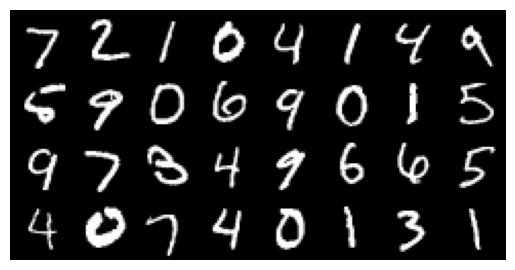

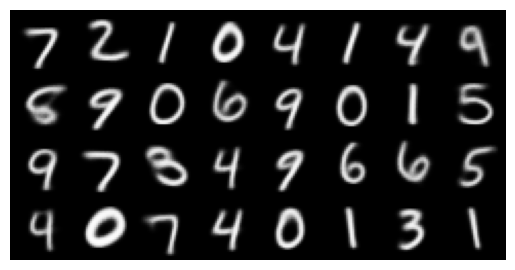

In [13]:
# VAE Tests
# TAs will change these paths as you will have provided the model files manually
"""To TAs, you should have been creating a folder with the student uid
   And the .ipynb + models in the root. Then that path is './VAE_model.pth' etc.
"""
vae = model_G = torch.jit.load('./CW_VAE/VAE_model.pth')
#vae = model_G = torch.jit.load('/notebooks/CW_VAE/VAE_model.pth')
vae.eval()

# Check if VAE is convolutional
def recurse_cnn_check(parent, flag):
    if flag:
        return flag
    children = list(parent.children())
    if len(children) > 0:
        for child in children:
            flag = flag or recurse_cnn_check(child, flag)
    else:
        params = parent._parameters
        if 'weight' in params.keys():
            flag = params['weight'].ndim == 4
    return flag

has_cnn = recurse_cnn_check(vae, False)
print("Used CNN" if has_cnn else "Didn't Use CNN")

vae_in = make_grid(vae_denorm(vae_input), nrow=8, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure()
plt.axis('off')
show(vae_in)

vae_test = vae(vae_input.to(device))[0].detach()
vae_reco = make_grid(vae_denorm(vae_test), nrow=8, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure()
plt.axis('off')
show(vae_reco)

Number of Parameters is 6085888 which is ok


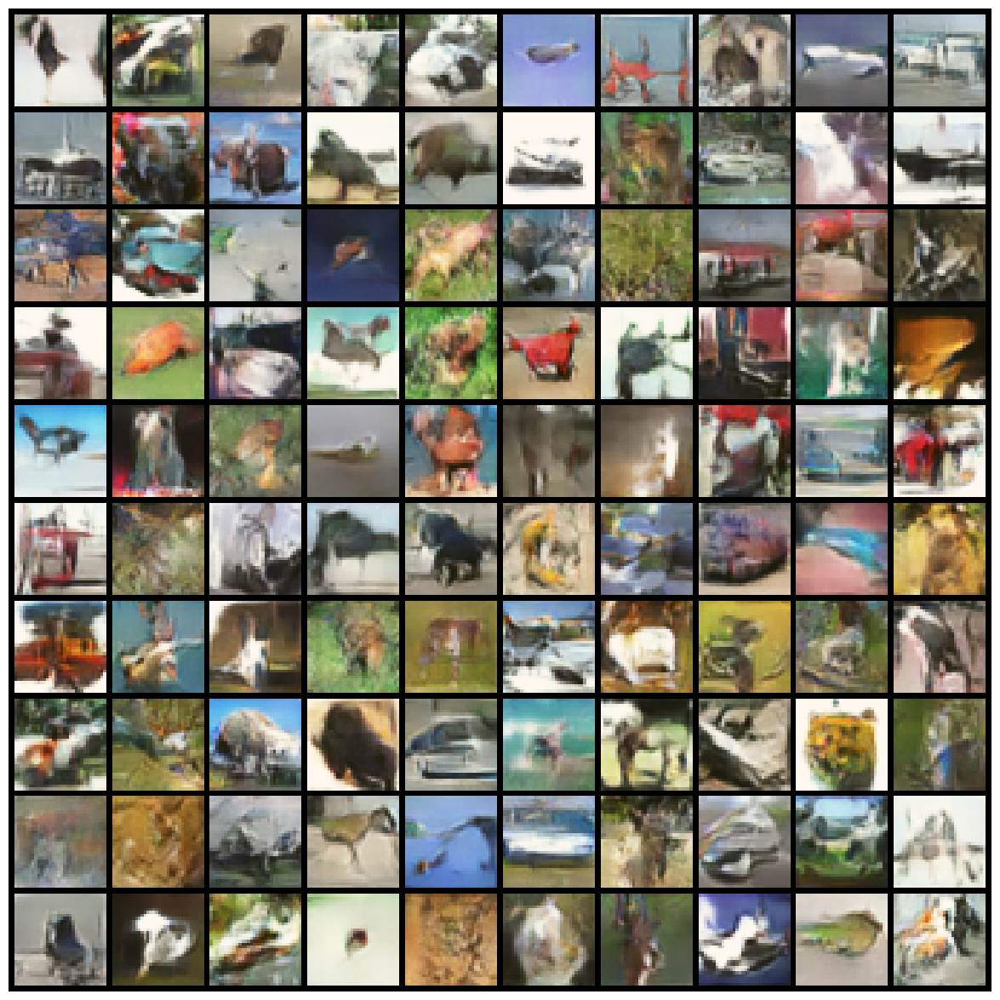

In [100]:
# GAN Tests
model_G = torch.jit.load('./CW_GAN/GAN_G_model.pth')
model_D = torch.jit.load('./CW_GAN/GAN_D_model.pth')

#model_G = torch.jit.load('/notebooks/CW_GAN/GAN_G_model.pth')
#model_D = torch.jit.load('/notebooks/CW_GAN/GAN_D_model.pth')

[model.eval() for model in (model_G, model_D)]

# Check that GAN doesn't have too many parameters
num_param = sum(p.numel() for p in [*model_G.parameters(),*model_D.parameters()])

print(f"Number of Parameters is {num_param} which is", "ok" if num_param<25E+6 else "not ok")

#Please pay attention to ensure that before generating images, torch no grad is set
# visualize the generated images
with torch.no_grad():
    generated = model_G(*gan_input).cpu()
    generated = make_grid(gan_denorm(generated)[:100].detach(), nrow=10, padding=2, normalize=True,
                        value_range=None, scale_each=False, pad_value=0)
    plt.figure(figsize=(15,15))
    plt.axis('off')
    show(generated)